# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [6]:
data_dir = '/data'
!pip install matplotlib==2.0.2
# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

You are using pip version 9.0.1, however version 18.0 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.
Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

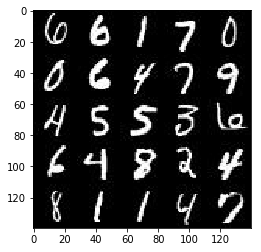

In [7]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

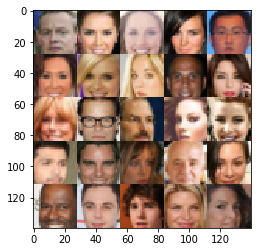

In [8]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
celeba_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(celeba_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [9]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.3.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [10]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    inputs_real = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    learning_rate = tf.placeholder(tf.float32, name = 'learning_rate')
        
    return inputs_real, inputs_z, learning_rate

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

ERROR:tensorflow:==================================
Object was never used (type <class 'tensorflow.python.framework.ops.Operation'>):
<tf.Operation 'assert_rank_2/Assert/Assert' type=Assert>
If you want to mark it as used call its "mark_used()" method.
It was originally created here:
['File "/opt/conda/lib/python3.6/runpy.py", line 193, in _run_module_as_main\n    "__main__", mod_spec)', 'File "/opt/conda/lib/python3.6/runpy.py", line 85, in _run_code\n    exec(code, run_globals)', 'File "/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py", line 16, in <module>\n    app.launch_new_instance()', 'File "/opt/conda/lib/python3.6/site-packages/traitlets/config/application.py", line 658, in launch_instance\n    app.start()', 'File "/opt/conda/lib/python3.6/site-packages/ipykernel/kernelapp.py", line 478, in start\n    self.io_loop.start()', 'File "/opt/conda/lib/python3.6/site-packages/zmq/eventloop/ioloop.py", line 177, in start\n    super(ZMQIOLoop, self).start()', 'File "/opt/co

### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [11]:
def leaky_relu (x,alpha=.2):
    return tf.maximum(alpha*x, x)

In [12]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 28x28x3
        
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same', 
                              kernel_initializer=tf.contrib.layers.xavier_initializer())
        x1 = leaky_relu(x1)
        # 14x14x64
        
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, padding='same',
                              kernel_initializer=tf.contrib.layers.xavier_initializer())
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = leaky_relu(x2)
        # 7x7x128
        
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding='same',
                             kernel_initializer=tf.contrib.layers.xavier_initializer())
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = leaky_relu(x3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(x3, (-1, 4*4*256))
        y = tf.layers.dense(flat, 1)
        logits = tf.nn.dropout(y, 0.9)
        out = tf.sigmoid(logits)
        
        return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [13]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    with tf.variable_scope('generator', reuse= not is_train):
        # First fully connected layer
        x1 = tf.layers.dense(z, 7*7*512)
        
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 7, 7, 512))
        x1 = tf.layers.batch_normalization(x1, training= is_train)
        x1 = leaky_relu(x1)
        # 7x7x512 now
        
        x2 = tf.layers.conv2d_transpose(
            x1, 256, 5, strides=2, padding='same',
            kernel_initializer=tf.contrib.layers.xavier_initializer())
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = leaky_relu(x2)
        # 14x14x256 now
        
        x3 = tf.layers.conv2d_transpose(
            x2, 64, 5, strides=2, padding='same',
            kernel_initializer=tf.contrib.layers.xavier_initializer())
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = leaky_relu(x3)
        # 28x28x64 now

        x4 = tf.layers.conv2d_transpose(
            x3, 16, 5, strides=1, padding='same',
            kernel_initializer=tf.contrib.layers.xavier_initializer())
        x4 = tf.layers.batch_normalization(x3, training=is_train)
        x4 = leaky_relu(x3)
        # 28x28x16 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(
            x3, out_channel_dim, 3, strides=1, padding='same',
            kernel_initializer=tf.contrib.layers.xavier_initializer())
        # 28x28x3 now
        
        out = tf.tanh(logits)
        
        return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [14]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    label_smooth = 0.9
    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)*label_smooth))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [15]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [20]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [40]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    print_every, show_every = 10, 100
    # build network
    input_real, input_z, LR = model_inputs(data_shape[1],data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[-1])
    d_train_opt, g_train_opt = model_opt(d_loss, g_loss, LR, beta1)

    # init and logging
    steps = 0    
    nB = float(data_shape[0]//batch_size)*epoch_count
    
    # train here
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # normalized input images
                batch_images *= 2.0
                steps += 1
                              
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))

                # Run optimizers
                _ = sess.run(d_train_opt, feed_dict={input_z: batch_z, input_real: batch_images, LR: learning_rate})
                _ = sess.run(g_train_opt, feed_dict={input_z: batch_z, input_real: batch_images, LR: learning_rate})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z, input_real: batch_images})
                    print("Epoch#{} progress:{:3.1f}%  dLoss:{:.4f}  gLoss:{:.4f} ".
                          format(epoch_i+1, round(1000*steps/nB)/10,train_loss_d,train_loss_g))

                if steps % show_every == 0:
                    show_generator_output(sess, 25, input_z, data_shape[-1], data_image_mode)


### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch#1 progress:0.1%  dLoss:0.6973  gLoss:27.6157 
Epoch#1 progress:0.3%  dLoss:2.3099  gLoss:0.2676 
Epoch#1 progress:0.4%  dLoss:0.4847  gLoss:14.7738 
Epoch#1 progress:0.5%  dLoss:0.6676  gLoss:3.4013 
Epoch#1 progress:0.7%  dLoss:1.4093  gLoss:0.4394 
Epoch#1 progress:0.8%  dLoss:1.7539  gLoss:1.2631 
Epoch#1 progress:0.9%  dLoss:2.1103  gLoss:2.8125 
Epoch#1 progress:1.1%  dLoss:1.3885  gLoss:0.6408 
Epoch#1 progress:1.2%  dLoss:1.9662  gLoss:1.9122 
Epoch#1 progress:1.3%  dLoss:2.1466  gLoss:0.4594 


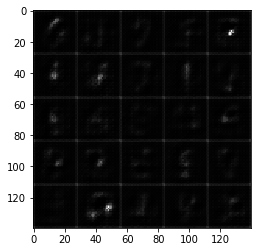

Epoch#1 progress:1.5%  dLoss:1.7398  gLoss:0.4164 
Epoch#1 progress:1.6%  dLoss:1.7750  gLoss:0.3901 
Epoch#1 progress:1.7%  dLoss:1.7097  gLoss:0.4618 
Epoch#1 progress:1.9%  dLoss:1.3306  gLoss:0.8916 
Epoch#1 progress:2.0%  dLoss:1.4220  gLoss:1.1041 
Epoch#1 progress:2.1%  dLoss:1.8832  gLoss:0.4223 
Epoch#1 progress:2.3%  dLoss:1.9738  gLoss:0.4243 
Epoch#1 progress:2.4%  dLoss:2.0808  gLoss:0.3703 
Epoch#1 progress:2.5%  dLoss:1.7552  gLoss:1.1981 
Epoch#1 progress:2.7%  dLoss:1.5824  gLoss:0.4932 


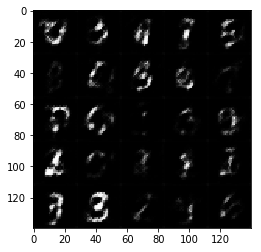

Epoch#1 progress:2.8%  dLoss:1.6869  gLoss:0.3872 
Epoch#1 progress:2.9%  dLoss:1.7875  gLoss:0.4250 
Epoch#1 progress:3.1%  dLoss:1.3919  gLoss:0.9287 
Epoch#1 progress:3.2%  dLoss:2.0152  gLoss:0.3366 
Epoch#1 progress:3.3%  dLoss:1.3337  gLoss:0.9310 
Epoch#1 progress:3.5%  dLoss:1.5399  gLoss:0.5142 
Epoch#1 progress:3.6%  dLoss:1.3812  gLoss:0.7252 
Epoch#1 progress:3.7%  dLoss:2.1212  gLoss:0.3194 
Epoch#1 progress:3.9%  dLoss:1.6704  gLoss:0.5553 
Epoch#1 progress:4.0%  dLoss:1.2817  gLoss:0.9779 


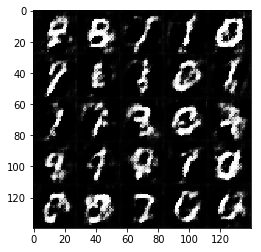

Epoch#1 progress:4.1%  dLoss:1.4222  gLoss:0.5963 
Epoch#1 progress:4.3%  dLoss:1.8953  gLoss:1.0469 
Epoch#1 progress:4.4%  dLoss:1.5213  gLoss:0.7939 
Epoch#1 progress:4.5%  dLoss:1.7851  gLoss:0.8719 
Epoch#1 progress:4.7%  dLoss:1.8033  gLoss:0.3273 
Epoch#1 progress:4.8%  dLoss:1.5506  gLoss:1.2436 
Epoch#1 progress:4.9%  dLoss:1.1708  gLoss:1.1750 
Epoch#1 progress:5.1%  dLoss:1.9002  gLoss:0.3173 
Epoch#1 progress:5.2%  dLoss:1.6154  gLoss:0.4009 
Epoch#1 progress:5.3%  dLoss:1.6069  gLoss:0.4353 


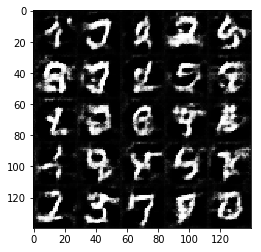

Epoch#1 progress:5.5%  dLoss:1.6165  gLoss:0.3411 
Epoch#1 progress:5.6%  dLoss:1.3014  gLoss:0.5977 
Epoch#1 progress:5.7%  dLoss:1.4860  gLoss:0.5447 
Epoch#1 progress:5.9%  dLoss:1.3636  gLoss:0.6807 
Epoch#1 progress:6.0%  dLoss:1.7716  gLoss:0.2918 
Epoch#1 progress:6.1%  dLoss:1.7908  gLoss:0.4826 
Epoch#1 progress:6.3%  dLoss:1.6380  gLoss:0.4342 
Epoch#1 progress:6.4%  dLoss:1.7318  gLoss:0.3581 
Epoch#1 progress:6.5%  dLoss:1.5621  gLoss:0.4656 
Epoch#1 progress:6.7%  dLoss:1.3481  gLoss:0.9015 


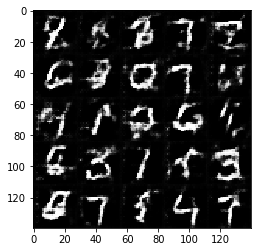

Epoch#1 progress:6.8%  dLoss:1.8579  gLoss:0.4215 
Epoch#1 progress:6.9%  dLoss:1.5179  gLoss:0.5613 
Epoch#1 progress:7.1%  dLoss:1.4115  gLoss:1.0419 
Epoch#1 progress:7.2%  dLoss:1.4109  gLoss:0.4348 
Epoch#1 progress:7.3%  dLoss:1.3951  gLoss:0.9510 
Epoch#1 progress:7.5%  dLoss:1.3458  gLoss:0.6180 
Epoch#1 progress:7.6%  dLoss:1.2572  gLoss:1.0748 
Epoch#1 progress:7.7%  dLoss:1.4284  gLoss:0.6666 
Epoch#1 progress:7.9%  dLoss:1.4161  gLoss:1.0152 
Epoch#1 progress:8.0%  dLoss:1.5825  gLoss:0.6784 


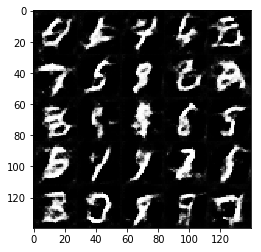

Epoch#1 progress:8.1%  dLoss:1.7115  gLoss:0.3318 
Epoch#1 progress:8.3%  dLoss:1.2884  gLoss:0.9995 
Epoch#1 progress:8.4%  dLoss:1.3537  gLoss:0.6119 
Epoch#1 progress:8.5%  dLoss:1.2565  gLoss:1.0416 
Epoch#1 progress:8.7%  dLoss:1.3228  gLoss:0.6378 
Epoch#1 progress:8.8%  dLoss:1.2694  gLoss:0.8976 
Epoch#1 progress:8.9%  dLoss:1.6390  gLoss:0.4406 
Epoch#1 progress:9.1%  dLoss:1.4572  gLoss:0.5886 
Epoch#1 progress:9.2%  dLoss:1.8445  gLoss:0.3528 
Epoch#1 progress:9.3%  dLoss:1.7659  gLoss:0.3369 


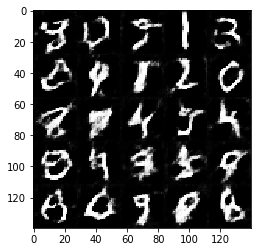

Epoch#1 progress:9.5%  dLoss:1.4099  gLoss:0.6796 
Epoch#1 progress:9.6%  dLoss:1.8120  gLoss:0.3985 
Epoch#1 progress:9.7%  dLoss:1.3918  gLoss:0.7227 
Epoch#1 progress:9.9%  dLoss:1.5488  gLoss:0.4613 
Epoch#1 progress:10.0%  dLoss:1.1305  gLoss:1.0138 
Epoch#1 progress:10.1%  dLoss:1.5057  gLoss:1.3805 
Epoch#1 progress:10.3%  dLoss:1.3235  gLoss:0.8600 
Epoch#1 progress:10.4%  dLoss:1.2227  gLoss:0.9938 
Epoch#1 progress:10.5%  dLoss:1.3202  gLoss:0.7741 
Epoch#1 progress:10.7%  dLoss:1.2594  gLoss:1.3256 


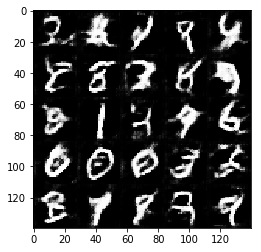

Epoch#1 progress:10.8%  dLoss:1.6160  gLoss:0.4621 
Epoch#1 progress:10.9%  dLoss:1.1785  gLoss:1.2980 
Epoch#1 progress:11.1%  dLoss:1.6690  gLoss:0.4471 
Epoch#1 progress:11.2%  dLoss:1.7247  gLoss:0.3489 
Epoch#1 progress:11.3%  dLoss:1.3454  gLoss:0.5812 
Epoch#1 progress:11.5%  dLoss:1.4223  gLoss:0.7411 
Epoch#1 progress:11.6%  dLoss:1.5940  gLoss:0.4414 
Epoch#1 progress:11.7%  dLoss:1.4542  gLoss:0.8984 
Epoch#1 progress:11.9%  dLoss:1.5141  gLoss:0.5037 
Epoch#1 progress:12.0%  dLoss:1.7969  gLoss:0.3753 


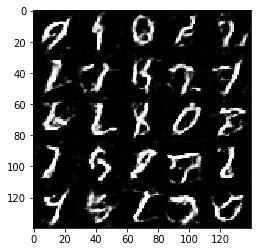

Epoch#1 progress:12.1%  dLoss:1.5037  gLoss:1.2940 
Epoch#1 progress:12.3%  dLoss:1.4852  gLoss:1.0362 
Epoch#1 progress:12.4%  dLoss:1.3384  gLoss:0.7247 
Epoch#1 progress:12.5%  dLoss:1.3461  gLoss:0.5942 
Epoch#1 progress:12.7%  dLoss:1.4652  gLoss:0.5654 
Epoch#1 progress:12.8%  dLoss:1.1449  gLoss:0.9519 
Epoch#1 progress:12.9%  dLoss:1.4023  gLoss:0.5211 
Epoch#1 progress:13.1%  dLoss:1.4634  gLoss:0.5586 
Epoch#1 progress:13.2%  dLoss:1.2942  gLoss:0.9287 
Epoch#1 progress:13.3%  dLoss:1.3834  gLoss:1.2714 


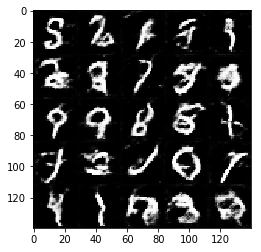

Epoch#1 progress:13.5%  dLoss:1.9283  gLoss:0.3494 
Epoch#1 progress:13.6%  dLoss:1.1407  gLoss:1.0876 
Epoch#1 progress:13.7%  dLoss:1.2288  gLoss:0.9075 
Epoch#1 progress:13.9%  dLoss:1.4955  gLoss:1.6058 
Epoch#1 progress:14.0%  dLoss:1.1809  gLoss:0.8222 
Epoch#1 progress:14.1%  dLoss:1.2071  gLoss:1.2553 
Epoch#1 progress:14.3%  dLoss:1.5563  gLoss:0.4592 
Epoch#1 progress:14.4%  dLoss:1.1873  gLoss:0.8316 
Epoch#1 progress:14.5%  dLoss:2.0617  gLoss:2.4409 
Epoch#1 progress:14.7%  dLoss:1.5672  gLoss:0.5408 


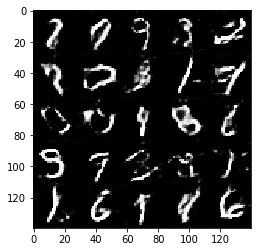

Epoch#1 progress:14.8%  dLoss:1.2697  gLoss:1.1948 
Epoch#1 progress:14.9%  dLoss:1.3688  gLoss:0.7279 
Epoch#1 progress:15.1%  dLoss:1.1940  gLoss:1.0785 
Epoch#1 progress:15.2%  dLoss:1.4831  gLoss:0.6317 
Epoch#1 progress:15.3%  dLoss:1.4837  gLoss:0.6790 
Epoch#1 progress:15.5%  dLoss:1.2394  gLoss:1.1739 
Epoch#1 progress:15.6%  dLoss:1.0204  gLoss:1.4604 
Epoch#1 progress:15.7%  dLoss:1.1917  gLoss:0.7728 
Epoch#1 progress:15.9%  dLoss:1.4433  gLoss:0.4922 
Epoch#1 progress:16.0%  dLoss:1.8982  gLoss:0.3309 


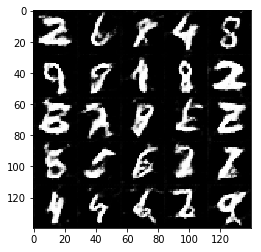

Epoch#1 progress:16.1%  dLoss:1.3062  gLoss:0.8540 
Epoch#1 progress:16.3%  dLoss:1.9687  gLoss:0.2427 
Epoch#1 progress:16.4%  dLoss:1.1667  gLoss:0.7863 
Epoch#1 progress:16.5%  dLoss:1.6608  gLoss:0.3843 
Epoch#1 progress:16.7%  dLoss:1.2874  gLoss:0.8540 
Epoch#1 progress:16.8%  dLoss:1.3733  gLoss:0.5739 
Epoch#1 progress:16.9%  dLoss:1.7691  gLoss:0.3557 
Epoch#1 progress:17.1%  dLoss:1.6810  gLoss:0.3920 
Epoch#1 progress:17.2%  dLoss:1.6369  gLoss:0.4566 
Epoch#1 progress:17.3%  dLoss:1.1681  gLoss:1.2725 


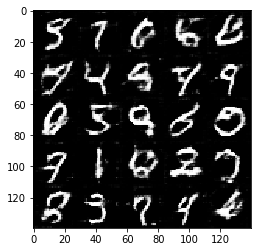

Epoch#1 progress:17.5%  dLoss:1.8303  gLoss:0.4190 
Epoch#1 progress:17.6%  dLoss:1.4656  gLoss:0.5744 
Epoch#1 progress:17.7%  dLoss:1.2417  gLoss:0.8211 
Epoch#1 progress:17.9%  dLoss:1.4602  gLoss:0.4995 
Epoch#1 progress:18.0%  dLoss:1.2423  gLoss:0.8196 
Epoch#1 progress:18.1%  dLoss:1.0006  gLoss:1.0914 
Epoch#1 progress:18.3%  dLoss:1.6323  gLoss:0.4824 
Epoch#1 progress:18.4%  dLoss:1.9568  gLoss:0.3725 
Epoch#1 progress:18.5%  dLoss:1.6162  gLoss:0.3829 
Epoch#1 progress:18.7%  dLoss:2.0864  gLoss:0.2576 


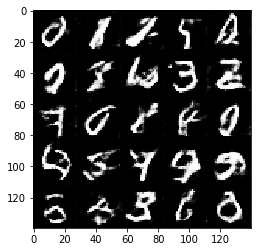

Epoch#1 progress:18.8%  dLoss:1.1180  gLoss:0.8493 
Epoch#1 progress:18.9%  dLoss:1.2834  gLoss:0.6079 
Epoch#1 progress:19.1%  dLoss:1.3734  gLoss:0.5064 
Epoch#1 progress:19.2%  dLoss:1.7184  gLoss:1.9502 
Epoch#1 progress:19.3%  dLoss:2.0539  gLoss:0.3021 
Epoch#1 progress:19.5%  dLoss:2.3285  gLoss:0.1961 
Epoch#1 progress:19.6%  dLoss:1.5497  gLoss:0.4308 
Epoch#1 progress:19.7%  dLoss:1.0961  gLoss:0.7610 
Epoch#1 progress:19.9%  dLoss:1.2431  gLoss:1.5693 
Epoch#1 progress:20.0%  dLoss:1.0370  gLoss:0.9352 


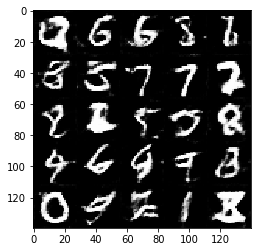

Epoch#1 progress:20.1%  dLoss:1.3983  gLoss:0.6442 
Epoch#1 progress:20.3%  dLoss:1.2169  gLoss:0.9563 
Epoch#1 progress:20.4%  dLoss:1.6484  gLoss:0.3931 
Epoch#1 progress:20.5%  dLoss:1.4267  gLoss:0.6574 
Epoch#1 progress:20.7%  dLoss:1.7579  gLoss:0.4089 
Epoch#1 progress:20.8%  dLoss:1.5439  gLoss:0.4494 
Epoch#1 progress:20.9%  dLoss:1.3922  gLoss:1.4986 
Epoch#1 progress:21.1%  dLoss:1.1060  gLoss:1.6705 
Epoch#1 progress:21.2%  dLoss:1.8877  gLoss:0.3585 
Epoch#1 progress:21.3%  dLoss:1.3024  gLoss:1.2976 


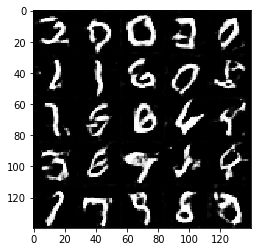

Epoch#1 progress:21.5%  dLoss:2.0875  gLoss:0.3155 
Epoch#1 progress:21.6%  dLoss:1.8510  gLoss:0.3594 
Epoch#1 progress:21.7%  dLoss:1.2081  gLoss:0.8135 
Epoch#1 progress:21.9%  dLoss:1.4341  gLoss:0.4798 
Epoch#1 progress:22.0%  dLoss:1.3681  gLoss:0.6680 
Epoch#1 progress:22.1%  dLoss:1.0010  gLoss:1.1120 
Epoch#1 progress:22.3%  dLoss:0.9157  gLoss:1.9695 
Epoch#1 progress:22.4%  dLoss:1.2157  gLoss:0.7407 
Epoch#1 progress:22.5%  dLoss:1.2344  gLoss:0.7183 
Epoch#1 progress:22.7%  dLoss:0.9945  gLoss:1.0568 


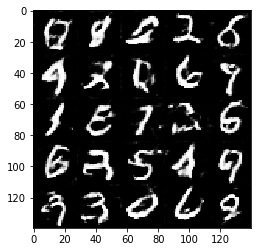

Epoch#1 progress:22.8%  dLoss:1.2339  gLoss:0.7964 
Epoch#1 progress:22.9%  dLoss:0.8403  gLoss:1.7438 
Epoch#1 progress:23.1%  dLoss:1.2696  gLoss:0.6418 
Epoch#1 progress:23.2%  dLoss:1.0966  gLoss:1.0421 
Epoch#1 progress:23.3%  dLoss:1.0711  gLoss:0.9583 
Epoch#1 progress:23.5%  dLoss:2.0616  gLoss:2.4825 
Epoch#1 progress:23.6%  dLoss:1.0661  gLoss:0.8611 
Epoch#1 progress:23.7%  dLoss:1.3072  gLoss:0.7862 
Epoch#1 progress:23.9%  dLoss:1.1190  gLoss:1.0397 
Epoch#1 progress:24.0%  dLoss:1.6227  gLoss:0.3985 


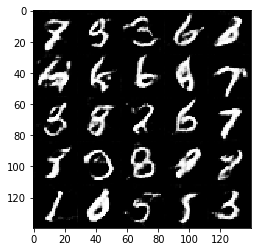

Epoch#1 progress:24.1%  dLoss:1.4970  gLoss:0.4263 
Epoch#1 progress:24.3%  dLoss:1.5879  gLoss:0.4759 
Epoch#1 progress:24.4%  dLoss:1.1847  gLoss:0.8849 
Epoch#1 progress:24.5%  dLoss:1.3703  gLoss:0.4912 
Epoch#1 progress:24.7%  dLoss:1.1040  gLoss:0.8495 
Epoch#1 progress:24.8%  dLoss:1.2762  gLoss:0.7137 
Epoch#1 progress:24.9%  dLoss:1.4831  gLoss:0.6069 
Epoch#1 progress:25.1%  dLoss:0.9239  gLoss:0.9793 
Epoch#1 progress:25.2%  dLoss:1.1351  gLoss:1.6599 
Epoch#1 progress:25.3%  dLoss:1.6300  gLoss:0.5010 


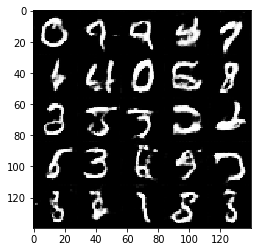

Epoch#1 progress:25.5%  dLoss:1.0881  gLoss:2.5835 
Epoch#1 progress:25.6%  dLoss:1.1975  gLoss:1.8988 
Epoch#1 progress:25.7%  dLoss:1.0724  gLoss:0.8824 
Epoch#1 progress:25.9%  dLoss:1.0748  gLoss:1.3054 
Epoch#1 progress:26.0%  dLoss:1.3339  gLoss:0.5001 
Epoch#1 progress:26.1%  dLoss:1.2629  gLoss:0.5903 
Epoch#1 progress:26.3%  dLoss:1.7029  gLoss:0.4214 
Epoch#1 progress:26.4%  dLoss:1.4436  gLoss:1.8773 
Epoch#1 progress:26.5%  dLoss:1.1839  gLoss:0.6998 
Epoch#1 progress:26.7%  dLoss:1.0321  gLoss:1.3757 


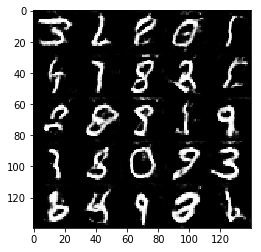

Epoch#1 progress:26.8%  dLoss:1.5621  gLoss:0.4534 
Epoch#1 progress:26.9%  dLoss:1.0554  gLoss:0.8853 
Epoch#1 progress:27.1%  dLoss:1.5191  gLoss:0.5719 
Epoch#1 progress:27.2%  dLoss:0.8601  gLoss:1.3025 
Epoch#1 progress:27.3%  dLoss:1.0004  gLoss:1.7495 
Epoch#1 progress:27.5%  dLoss:1.0825  gLoss:1.9808 
Epoch#1 progress:27.6%  dLoss:0.8767  gLoss:1.1949 
Epoch#1 progress:27.7%  dLoss:1.2127  gLoss:0.8514 
Epoch#1 progress:27.9%  dLoss:1.0139  gLoss:1.3252 
Epoch#1 progress:28.0%  dLoss:0.8166  gLoss:1.4565 


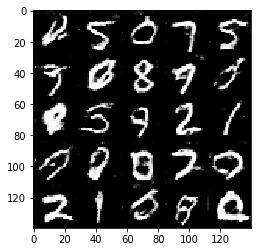

Epoch#1 progress:28.1%  dLoss:1.1870  gLoss:0.6883 
Epoch#1 progress:28.3%  dLoss:1.1516  gLoss:1.4258 
Epoch#1 progress:28.4%  dLoss:1.0295  gLoss:1.3792 
Epoch#1 progress:28.5%  dLoss:1.2901  gLoss:0.7794 
Epoch#1 progress:28.7%  dLoss:2.0957  gLoss:0.2810 
Epoch#1 progress:28.8%  dLoss:1.1986  gLoss:1.6557 
Epoch#1 progress:28.9%  dLoss:1.1362  gLoss:0.7377 
Epoch#1 progress:29.1%  dLoss:1.1819  gLoss:1.6639 
Epoch#1 progress:29.2%  dLoss:0.8894  gLoss:1.2419 
Epoch#1 progress:29.3%  dLoss:0.8549  gLoss:1.2277 


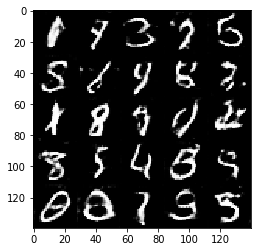

Epoch#1 progress:29.5%  dLoss:1.2324  gLoss:1.8012 
Epoch#1 progress:29.6%  dLoss:0.9576  gLoss:1.8116 
Epoch#1 progress:29.7%  dLoss:0.9431  gLoss:1.5524 
Epoch#1 progress:29.9%  dLoss:2.0305  gLoss:0.3916 
Epoch#1 progress:30.0%  dLoss:1.0252  gLoss:0.9821 
Epoch#1 progress:30.1%  dLoss:0.7929  gLoss:1.6357 
Epoch#1 progress:30.3%  dLoss:0.8911  gLoss:1.4192 
Epoch#1 progress:30.4%  dLoss:1.1992  gLoss:0.7817 
Epoch#1 progress:30.5%  dLoss:1.8786  gLoss:0.3936 
Epoch#1 progress:30.7%  dLoss:1.5255  gLoss:0.5108 


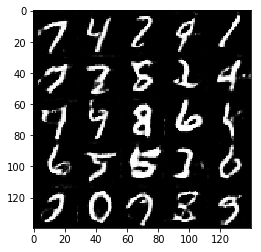

Epoch#1 progress:30.8%  dLoss:0.9571  gLoss:1.0675 
Epoch#1 progress:30.9%  dLoss:1.3567  gLoss:0.7015 
Epoch#1 progress:31.1%  dLoss:1.4615  gLoss:0.6774 
Epoch#1 progress:31.2%  dLoss:1.8673  gLoss:0.4685 
Epoch#1 progress:31.3%  dLoss:0.9634  gLoss:1.2007 
Epoch#1 progress:31.5%  dLoss:0.7562  gLoss:1.2412 
Epoch#1 progress:31.6%  dLoss:1.0923  gLoss:0.7470 
Epoch#1 progress:31.7%  dLoss:0.9764  gLoss:1.3426 
Epoch#1 progress:31.9%  dLoss:1.4898  gLoss:2.6037 
Epoch#1 progress:32.0%  dLoss:1.0587  gLoss:0.8306 


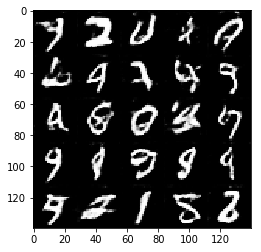

Epoch#1 progress:32.1%  dLoss:1.5155  gLoss:0.4289 
Epoch#1 progress:32.3%  dLoss:1.2406  gLoss:0.7393 
Epoch#1 progress:32.4%  dLoss:1.2451  gLoss:1.9123 
Epoch#1 progress:32.5%  dLoss:1.0030  gLoss:1.0398 
Epoch#1 progress:32.7%  dLoss:1.2026  gLoss:0.6780 
Epoch#1 progress:32.8%  dLoss:0.8845  gLoss:0.9720 
Epoch#1 progress:32.9%  dLoss:0.9871  gLoss:1.9004 
Epoch#1 progress:33.1%  dLoss:1.4002  gLoss:0.5275 
Epoch#1 progress:33.2%  dLoss:1.3584  gLoss:0.6091 
Epoch#1 progress:33.3%  dLoss:0.8683  gLoss:1.1728 


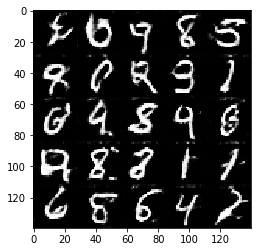

Epoch#1 progress:33.5%  dLoss:1.6894  gLoss:0.3986 
Epoch#1 progress:33.6%  dLoss:1.8495  gLoss:0.4128 
Epoch#1 progress:33.7%  dLoss:1.1477  gLoss:0.9584 
Epoch#1 progress:33.9%  dLoss:2.1781  gLoss:0.2122 
Epoch#1 progress:34.0%  dLoss:1.1841  gLoss:2.4712 
Epoch#1 progress:34.1%  dLoss:1.9139  gLoss:0.2876 
Epoch#1 progress:34.3%  dLoss:1.6690  gLoss:0.3803 
Epoch#1 progress:34.4%  dLoss:1.1227  gLoss:0.8631 
Epoch#1 progress:34.5%  dLoss:0.8425  gLoss:1.4268 
Epoch#1 progress:34.7%  dLoss:1.0006  gLoss:0.9946 


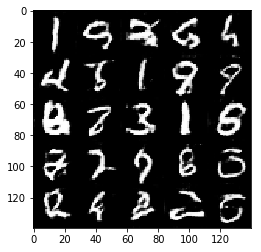

Epoch#1 progress:34.8%  dLoss:1.1021  gLoss:0.9416 
Epoch#1 progress:34.9%  dLoss:1.3925  gLoss:0.6314 
Epoch#1 progress:35.1%  dLoss:1.2357  gLoss:0.6701 
Epoch#1 progress:35.2%  dLoss:1.1536  gLoss:0.7728 
Epoch#1 progress:35.3%  dLoss:0.8684  gLoss:1.0294 
Epoch#1 progress:35.5%  dLoss:1.0508  gLoss:0.8986 
Epoch#1 progress:35.6%  dLoss:2.2309  gLoss:0.2566 
Epoch#1 progress:35.7%  dLoss:1.4677  gLoss:0.5350 
Epoch#1 progress:35.9%  dLoss:0.9188  gLoss:1.0575 
Epoch#1 progress:36.0%  dLoss:1.1561  gLoss:0.9206 


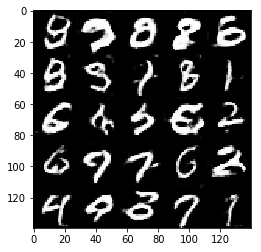

Epoch#1 progress:36.1%  dLoss:1.2766  gLoss:0.7242 
Epoch#1 progress:36.3%  dLoss:1.0574  gLoss:0.9866 
Epoch#1 progress:36.4%  dLoss:1.4542  gLoss:2.3087 
Epoch#1 progress:36.5%  dLoss:1.4805  gLoss:0.6028 
Epoch#1 progress:36.7%  dLoss:1.0362  gLoss:0.9119 
Epoch#1 progress:36.8%  dLoss:1.1700  gLoss:0.6691 
Epoch#1 progress:36.9%  dLoss:0.9312  gLoss:0.9703 
Epoch#1 progress:37.1%  dLoss:1.3145  gLoss:2.2670 
Epoch#1 progress:37.2%  dLoss:1.3077  gLoss:0.7180 
Epoch#1 progress:37.3%  dLoss:0.8684  gLoss:1.2837 


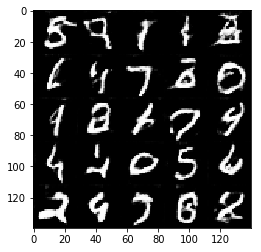

Epoch#1 progress:37.5%  dLoss:0.9537  gLoss:1.1028 
Epoch#1 progress:37.6%  dLoss:1.0532  gLoss:0.8169 
Epoch#1 progress:37.7%  dLoss:1.2107  gLoss:0.7207 
Epoch#1 progress:37.9%  dLoss:0.8489  gLoss:1.1439 
Epoch#1 progress:38.0%  dLoss:1.3637  gLoss:0.5702 
Epoch#1 progress:38.1%  dLoss:0.8255  gLoss:1.5660 
Epoch#1 progress:38.3%  dLoss:1.5517  gLoss:0.5804 
Epoch#1 progress:38.4%  dLoss:1.0143  gLoss:0.8101 
Epoch#1 progress:38.5%  dLoss:1.2866  gLoss:0.6617 
Epoch#1 progress:38.7%  dLoss:1.0538  gLoss:2.0202 


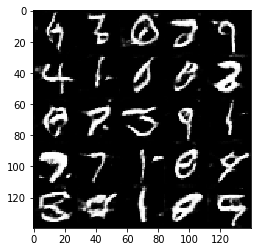

Epoch#1 progress:38.8%  dLoss:0.9143  gLoss:1.0376 
Epoch#1 progress:38.9%  dLoss:1.1634  gLoss:0.7612 
Epoch#1 progress:39.1%  dLoss:1.2943  gLoss:0.5535 
Epoch#1 progress:39.2%  dLoss:1.4068  gLoss:0.5038 
Epoch#1 progress:39.3%  dLoss:1.1524  gLoss:0.9747 
Epoch#1 progress:39.5%  dLoss:1.0444  gLoss:2.2174 
Epoch#1 progress:39.6%  dLoss:1.4563  gLoss:0.5572 
Epoch#1 progress:39.7%  dLoss:0.9843  gLoss:0.9150 
Epoch#1 progress:39.9%  dLoss:2.2248  gLoss:0.3501 
Epoch#1 progress:40.0%  dLoss:1.3132  gLoss:0.6664 


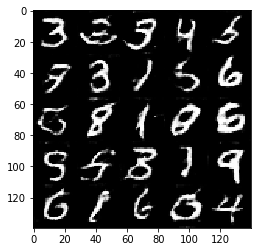

Epoch#1 progress:40.1%  dLoss:0.9051  gLoss:1.4136 
Epoch#1 progress:40.3%  dLoss:0.6764  gLoss:1.7984 
Epoch#1 progress:40.4%  dLoss:1.0074  gLoss:0.9441 
Epoch#1 progress:40.5%  dLoss:1.0460  gLoss:0.8496 
Epoch#1 progress:40.7%  dLoss:1.2099  gLoss:0.6295 
Epoch#1 progress:40.8%  dLoss:1.0463  gLoss:1.0471 
Epoch#1 progress:40.9%  dLoss:1.8038  gLoss:1.8670 
Epoch#1 progress:41.1%  dLoss:1.2215  gLoss:1.8494 
Epoch#1 progress:41.2%  dLoss:1.2183  gLoss:0.6685 
Epoch#1 progress:41.3%  dLoss:0.8577  gLoss:1.3684 


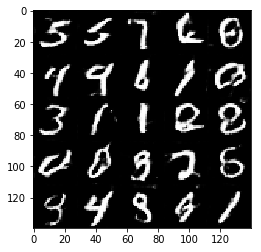

Epoch#1 progress:41.5%  dLoss:1.0985  gLoss:0.7872 
Epoch#1 progress:41.6%  dLoss:0.9912  gLoss:0.8614 
Epoch#1 progress:41.7%  dLoss:0.7499  gLoss:1.5926 
Epoch#1 progress:41.9%  dLoss:1.0227  gLoss:1.0230 
Epoch#1 progress:42.0%  dLoss:1.0455  gLoss:0.8666 
Epoch#1 progress:42.1%  dLoss:0.7713  gLoss:1.9497 
Epoch#1 progress:42.3%  dLoss:0.9799  gLoss:1.0532 
Epoch#1 progress:42.4%  dLoss:0.9954  gLoss:1.4248 
Epoch#1 progress:42.5%  dLoss:0.6169  gLoss:1.8479 
Epoch#1 progress:42.7%  dLoss:0.7170  gLoss:1.6627 


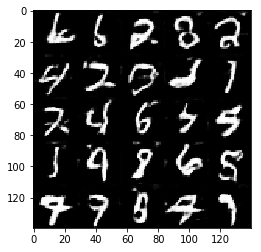

Epoch#1 progress:42.8%  dLoss:0.8466  gLoss:1.4224 
Epoch#1 progress:42.9%  dLoss:0.9506  gLoss:0.9254 
Epoch#1 progress:43.1%  dLoss:1.1610  gLoss:0.8020 
Epoch#1 progress:43.2%  dLoss:1.6183  gLoss:2.3370 
Epoch#1 progress:43.3%  dLoss:1.7672  gLoss:0.3524 
Epoch#1 progress:43.5%  dLoss:0.8391  gLoss:1.4086 
Epoch#1 progress:43.6%  dLoss:1.3374  gLoss:0.7239 
Epoch#1 progress:43.7%  dLoss:1.0162  gLoss:0.8729 
Epoch#1 progress:43.9%  dLoss:0.8785  gLoss:1.1517 
Epoch#1 progress:44.0%  dLoss:1.5907  gLoss:2.8877 


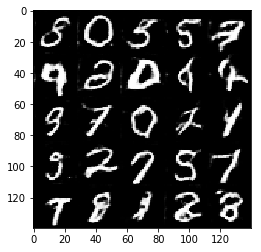

Epoch#1 progress:44.1%  dLoss:0.8889  gLoss:1.5004 
Epoch#1 progress:44.3%  dLoss:1.0332  gLoss:1.0465 
Epoch#1 progress:44.4%  dLoss:1.2750  gLoss:0.6810 
Epoch#1 progress:44.5%  dLoss:1.0410  gLoss:0.9949 
Epoch#1 progress:44.7%  dLoss:0.9999  gLoss:0.8869 
Epoch#1 progress:44.8%  dLoss:1.0761  gLoss:0.9600 
Epoch#1 progress:44.9%  dLoss:0.7393  gLoss:1.4864 
Epoch#1 progress:45.1%  dLoss:0.8602  gLoss:1.2315 
Epoch#1 progress:45.2%  dLoss:1.9899  gLoss:0.2989 
Epoch#1 progress:45.3%  dLoss:1.2394  gLoss:0.7129 


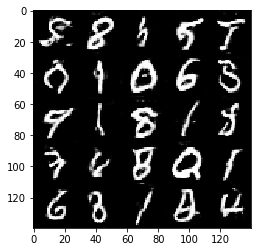

Epoch#1 progress:45.5%  dLoss:0.7820  gLoss:1.2783 
Epoch#1 progress:45.6%  dLoss:1.1313  gLoss:2.9890 
Epoch#1 progress:45.7%  dLoss:0.9680  gLoss:0.8929 
Epoch#1 progress:45.9%  dLoss:0.7659  gLoss:2.0333 
Epoch#1 progress:46.0%  dLoss:1.5910  gLoss:0.3902 
Epoch#1 progress:46.1%  dLoss:0.8882  gLoss:1.8864 
Epoch#1 progress:46.3%  dLoss:1.0879  gLoss:0.9065 
Epoch#1 progress:46.4%  dLoss:1.2457  gLoss:0.7559 
Epoch#1 progress:46.5%  dLoss:0.7397  gLoss:1.4047 
Epoch#1 progress:46.7%  dLoss:0.9552  gLoss:1.1649 


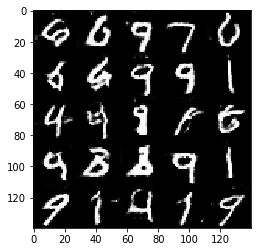

Epoch#1 progress:46.8%  dLoss:0.8808  gLoss:1.2282 
Epoch#1 progress:46.9%  dLoss:1.7112  gLoss:0.4996 
Epoch#1 progress:47.1%  dLoss:1.1651  gLoss:0.7422 
Epoch#1 progress:47.2%  dLoss:1.0475  gLoss:0.7970 
Epoch#1 progress:47.3%  dLoss:1.2277  gLoss:0.6991 
Epoch#1 progress:47.5%  dLoss:0.8159  gLoss:1.6078 
Epoch#1 progress:47.6%  dLoss:1.3414  gLoss:0.5847 
Epoch#1 progress:47.7%  dLoss:0.7771  gLoss:1.2122 
Epoch#1 progress:47.9%  dLoss:0.9288  gLoss:1.1878 
Epoch#1 progress:48.0%  dLoss:1.4617  gLoss:0.6292 


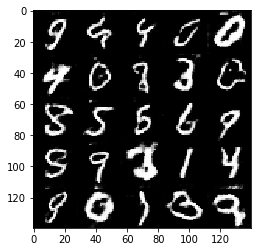

Epoch#1 progress:48.1%  dLoss:0.9853  gLoss:0.9608 
Epoch#1 progress:48.3%  dLoss:1.7273  gLoss:0.4230 
Epoch#1 progress:48.4%  dLoss:0.9909  gLoss:1.2407 
Epoch#1 progress:48.5%  dLoss:1.3427  gLoss:0.5985 
Epoch#1 progress:48.7%  dLoss:1.7224  gLoss:0.4339 
Epoch#1 progress:48.8%  dLoss:0.9422  gLoss:1.7774 
Epoch#1 progress:48.9%  dLoss:0.9609  gLoss:1.3231 
Epoch#1 progress:49.1%  dLoss:1.2552  gLoss:0.7980 
Epoch#1 progress:49.2%  dLoss:1.0136  gLoss:2.1119 
Epoch#1 progress:49.3%  dLoss:0.8053  gLoss:1.5848 


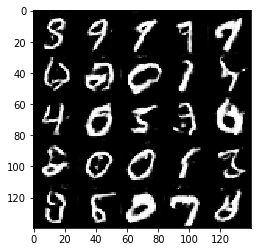

Epoch#1 progress:49.5%  dLoss:1.2025  gLoss:0.8598 
Epoch#1 progress:49.6%  dLoss:0.6738  gLoss:1.6450 
Epoch#1 progress:49.7%  dLoss:1.1731  gLoss:0.6676 
Epoch#1 progress:49.9%  dLoss:1.1653  gLoss:0.8760 
Epoch#1 progress:50.0%  dLoss:1.7051  gLoss:0.5769 
Epoch#2 progress:50.1%  dLoss:1.4720  gLoss:2.3349 
Epoch#2 progress:50.3%  dLoss:1.0297  gLoss:1.0250 
Epoch#2 progress:50.4%  dLoss:1.3895  gLoss:2.6833 
Epoch#2 progress:50.5%  dLoss:0.9959  gLoss:0.8109 
Epoch#2 progress:50.7%  dLoss:0.9576  gLoss:1.0353 


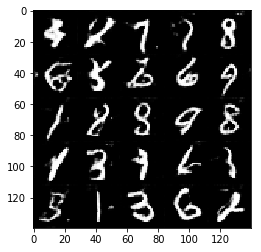

Epoch#2 progress:50.8%  dLoss:1.0455  gLoss:2.0206 
Epoch#2 progress:50.9%  dLoss:0.9507  gLoss:1.0622 
Epoch#2 progress:51.1%  dLoss:0.7574  gLoss:1.9336 
Epoch#2 progress:51.2%  dLoss:0.9973  gLoss:3.3003 
Epoch#2 progress:51.3%  dLoss:0.8386  gLoss:2.2519 
Epoch#2 progress:51.5%  dLoss:1.0175  gLoss:2.8988 
Epoch#2 progress:51.6%  dLoss:0.9682  gLoss:1.0219 
Epoch#2 progress:51.7%  dLoss:1.4524  gLoss:0.6463 
Epoch#2 progress:51.9%  dLoss:1.1467  gLoss:0.7277 
Epoch#2 progress:52.0%  dLoss:1.2631  gLoss:2.2231 


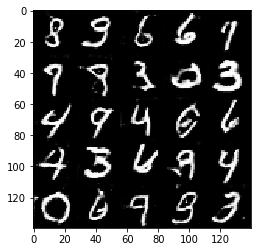

Epoch#2 progress:52.1%  dLoss:1.1559  gLoss:1.1334 
Epoch#2 progress:52.3%  dLoss:0.8185  gLoss:1.3596 
Epoch#2 progress:52.4%  dLoss:0.8610  gLoss:1.0323 
Epoch#2 progress:52.5%  dLoss:1.4446  gLoss:0.5482 
Epoch#2 progress:52.7%  dLoss:0.9100  gLoss:2.0070 
Epoch#2 progress:52.8%  dLoss:1.2227  gLoss:0.7045 
Epoch#2 progress:52.9%  dLoss:1.0980  gLoss:1.9537 
Epoch#2 progress:53.1%  dLoss:1.2543  gLoss:3.2713 
Epoch#2 progress:53.2%  dLoss:1.5328  gLoss:0.4414 
Epoch#2 progress:53.3%  dLoss:0.7779  gLoss:1.2797 


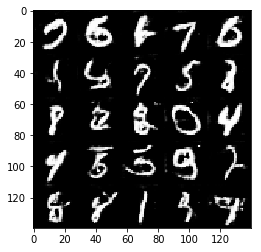

Epoch#2 progress:53.5%  dLoss:0.7665  gLoss:1.5141 
Epoch#2 progress:53.6%  dLoss:0.7097  gLoss:2.0714 
Epoch#2 progress:53.7%  dLoss:1.1817  gLoss:0.7441 
Epoch#2 progress:53.9%  dLoss:0.8346  gLoss:1.3012 
Epoch#2 progress:54.0%  dLoss:0.6822  gLoss:2.0007 
Epoch#2 progress:54.1%  dLoss:1.4361  gLoss:0.6323 
Epoch#2 progress:54.3%  dLoss:1.1546  gLoss:0.8554 
Epoch#2 progress:54.4%  dLoss:0.8659  gLoss:1.3643 
Epoch#2 progress:54.5%  dLoss:0.9621  gLoss:1.6102 
Epoch#2 progress:54.7%  dLoss:1.0673  gLoss:1.2039 


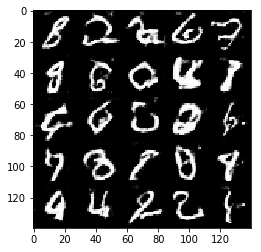

Epoch#2 progress:54.8%  dLoss:1.4232  gLoss:0.6561 
Epoch#2 progress:54.9%  dLoss:0.9887  gLoss:1.1297 
Epoch#2 progress:55.1%  dLoss:2.1253  gLoss:0.2319 
Epoch#2 progress:55.2%  dLoss:0.9290  gLoss:1.4290 
Epoch#2 progress:55.3%  dLoss:0.8237  gLoss:1.3651 
Epoch#2 progress:55.5%  dLoss:0.9851  gLoss:1.3306 
Epoch#2 progress:55.6%  dLoss:2.2782  gLoss:0.2727 
Epoch#2 progress:55.7%  dLoss:1.2661  gLoss:0.8089 
Epoch#2 progress:55.9%  dLoss:1.7396  gLoss:0.4676 
Epoch#2 progress:56.0%  dLoss:1.7586  gLoss:0.4882 


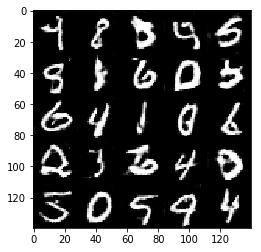

Epoch#2 progress:56.1%  dLoss:0.8960  gLoss:2.2717 
Epoch#2 progress:56.3%  dLoss:1.8149  gLoss:0.4235 
Epoch#2 progress:56.4%  dLoss:1.3065  gLoss:0.6807 
Epoch#2 progress:56.5%  dLoss:0.7583  gLoss:1.5929 
Epoch#2 progress:56.7%  dLoss:1.1144  gLoss:0.8485 
Epoch#2 progress:56.8%  dLoss:1.2347  gLoss:0.7223 
Epoch#2 progress:56.9%  dLoss:0.9699  gLoss:1.0473 
Epoch#2 progress:57.1%  dLoss:0.9469  gLoss:1.1447 
Epoch#2 progress:57.2%  dLoss:1.1808  gLoss:2.9124 
Epoch#2 progress:57.3%  dLoss:0.9726  gLoss:2.9445 


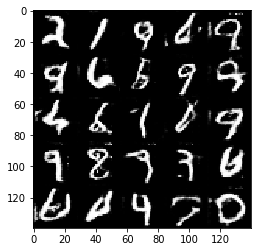

Epoch#2 progress:57.5%  dLoss:0.7652  gLoss:1.5926 
Epoch#2 progress:57.6%  dLoss:0.7249  gLoss:1.4721 
Epoch#2 progress:57.7%  dLoss:0.9584  gLoss:1.3788 
Epoch#2 progress:57.9%  dLoss:0.7662  gLoss:1.1081 
Epoch#2 progress:58.0%  dLoss:1.0114  gLoss:1.3985 
Epoch#2 progress:58.1%  dLoss:2.2082  gLoss:0.2876 
Epoch#2 progress:58.3%  dLoss:0.7678  gLoss:1.6953 
Epoch#2 progress:58.4%  dLoss:1.4485  gLoss:0.5487 
Epoch#2 progress:58.5%  dLoss:1.4235  gLoss:0.5916 
Epoch#2 progress:58.7%  dLoss:0.6949  gLoss:1.8260 


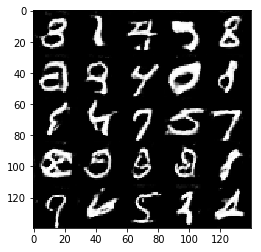

Epoch#2 progress:58.8%  dLoss:1.4084  gLoss:0.7295 
Epoch#2 progress:58.9%  dLoss:1.3507  gLoss:0.6543 
Epoch#2 progress:59.1%  dLoss:1.3018  gLoss:0.8201 
Epoch#2 progress:59.2%  dLoss:1.9966  gLoss:0.4122 
Epoch#2 progress:59.3%  dLoss:1.0073  gLoss:1.4902 
Epoch#2 progress:59.5%  dLoss:0.7738  gLoss:1.4024 
Epoch#2 progress:59.6%  dLoss:0.7833  gLoss:1.6550 
Epoch#2 progress:59.7%  dLoss:1.4650  gLoss:0.5636 
Epoch#2 progress:59.9%  dLoss:0.7996  gLoss:1.3824 
Epoch#2 progress:60.0%  dLoss:0.9984  gLoss:0.7581 


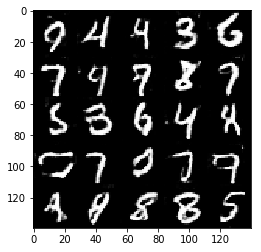

Epoch#2 progress:60.1%  dLoss:0.9139  gLoss:1.2309 
Epoch#2 progress:60.3%  dLoss:1.2462  gLoss:0.7238 
Epoch#2 progress:60.4%  dLoss:0.9684  gLoss:1.8866 
Epoch#2 progress:60.5%  dLoss:1.1453  gLoss:0.6661 
Epoch#2 progress:60.7%  dLoss:0.7477  gLoss:2.1950 
Epoch#2 progress:60.8%  dLoss:1.0476  gLoss:1.0075 
Epoch#2 progress:60.9%  dLoss:0.8051  gLoss:2.7023 
Epoch#2 progress:61.1%  dLoss:0.8387  gLoss:1.3880 
Epoch#2 progress:61.2%  dLoss:0.9914  gLoss:1.0139 
Epoch#2 progress:61.3%  dLoss:1.6517  gLoss:0.3690 


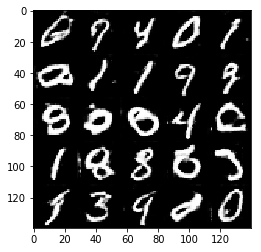

Epoch#2 progress:61.5%  dLoss:1.3351  gLoss:0.5698 
Epoch#2 progress:61.6%  dLoss:1.0679  gLoss:1.1649 
Epoch#2 progress:61.7%  dLoss:0.9315  gLoss:0.9061 
Epoch#2 progress:61.9%  dLoss:1.5036  gLoss:2.7820 
Epoch#2 progress:62.0%  dLoss:1.0597  gLoss:0.8660 
Epoch#2 progress:62.1%  dLoss:0.8363  gLoss:2.3879 
Epoch#2 progress:62.3%  dLoss:1.3944  gLoss:3.2670 
Epoch#2 progress:62.4%  dLoss:0.6563  gLoss:1.8258 
Epoch#2 progress:62.5%  dLoss:1.3835  gLoss:0.5099 
Epoch#2 progress:62.7%  dLoss:1.5141  gLoss:0.7457 


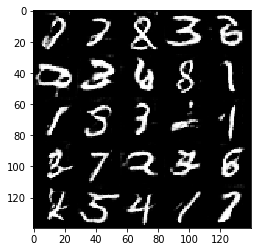

Epoch#2 progress:62.8%  dLoss:1.3129  gLoss:0.6740 
Epoch#2 progress:62.9%  dLoss:0.9511  gLoss:1.1215 
Epoch#2 progress:63.1%  dLoss:0.7764  gLoss:1.4350 
Epoch#2 progress:63.2%  dLoss:1.5626  gLoss:0.5348 
Epoch#2 progress:63.3%  dLoss:0.8993  gLoss:0.7967 
Epoch#2 progress:63.5%  dLoss:1.8096  gLoss:0.4385 
Epoch#2 progress:63.6%  dLoss:0.7844  gLoss:1.5664 
Epoch#2 progress:63.7%  dLoss:0.8703  gLoss:2.1528 
Epoch#2 progress:63.9%  dLoss:0.9675  gLoss:0.9828 
Epoch#2 progress:64.0%  dLoss:0.8370  gLoss:1.1372 


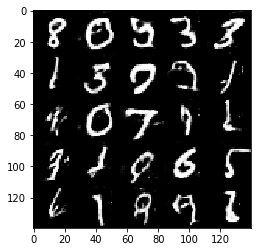

Epoch#2 progress:64.1%  dLoss:0.6111  gLoss:1.7173 
Epoch#2 progress:64.3%  dLoss:1.1100  gLoss:0.8698 
Epoch#2 progress:64.4%  dLoss:1.4362  gLoss:0.5207 
Epoch#2 progress:64.5%  dLoss:1.1092  gLoss:2.2316 
Epoch#2 progress:64.7%  dLoss:1.6469  gLoss:0.4478 
Epoch#2 progress:64.8%  dLoss:1.0707  gLoss:0.8225 
Epoch#2 progress:64.9%  dLoss:0.8549  gLoss:1.1256 
Epoch#2 progress:65.1%  dLoss:1.2096  gLoss:0.8168 
Epoch#2 progress:65.2%  dLoss:1.1161  gLoss:0.7454 
Epoch#2 progress:65.3%  dLoss:2.2584  gLoss:0.2460 


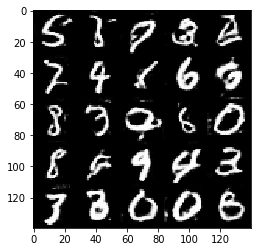

Epoch#2 progress:65.5%  dLoss:0.9084  gLoss:1.1957 
Epoch#2 progress:65.6%  dLoss:0.8420  gLoss:1.4029 
Epoch#2 progress:65.7%  dLoss:0.8529  gLoss:1.1323 
Epoch#2 progress:65.9%  dLoss:0.8558  gLoss:1.7587 
Epoch#2 progress:66.0%  dLoss:0.9522  gLoss:1.1707 
Epoch#2 progress:66.1%  dLoss:0.9296  gLoss:1.1027 
Epoch#2 progress:66.3%  dLoss:1.1085  gLoss:0.8280 
Epoch#2 progress:66.4%  dLoss:2.1519  gLoss:0.3288 
Epoch#2 progress:66.5%  dLoss:0.9161  gLoss:1.0865 
Epoch#2 progress:66.7%  dLoss:0.8545  gLoss:0.9258 


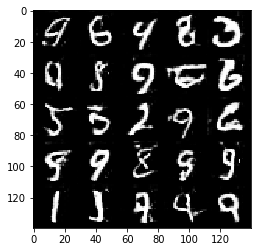

Epoch#2 progress:66.8%  dLoss:0.8039  gLoss:2.5090 
Epoch#2 progress:66.9%  dLoss:1.1793  gLoss:0.7604 
Epoch#2 progress:67.1%  dLoss:1.1679  gLoss:0.7528 
Epoch#2 progress:67.2%  dLoss:0.9891  gLoss:0.8642 
Epoch#2 progress:67.3%  dLoss:0.6771  gLoss:1.4976 
Epoch#2 progress:67.5%  dLoss:1.4346  gLoss:0.5689 
Epoch#2 progress:67.6%  dLoss:1.5221  gLoss:0.5083 
Epoch#2 progress:67.7%  dLoss:0.7621  gLoss:1.8484 
Epoch#2 progress:67.9%  dLoss:0.8882  gLoss:1.3390 
Epoch#2 progress:68.0%  dLoss:1.0015  gLoss:2.2235 


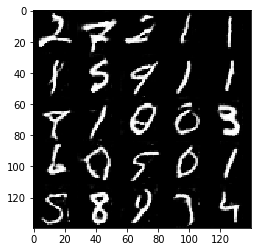

Epoch#2 progress:68.1%  dLoss:0.9065  gLoss:1.1295 
Epoch#2 progress:68.3%  dLoss:1.4107  gLoss:0.6314 
Epoch#2 progress:68.4%  dLoss:1.1102  gLoss:0.8297 
Epoch#2 progress:68.5%  dLoss:2.2676  gLoss:0.6532 
Epoch#2 progress:68.7%  dLoss:1.2585  gLoss:0.7453 
Epoch#2 progress:68.8%  dLoss:0.7815  gLoss:1.4139 
Epoch#2 progress:68.9%  dLoss:1.1041  gLoss:0.9168 
Epoch#2 progress:69.1%  dLoss:0.5058  gLoss:2.6241 
Epoch#2 progress:69.2%  dLoss:1.5115  gLoss:0.7918 
Epoch#2 progress:69.3%  dLoss:1.3830  gLoss:0.8892 


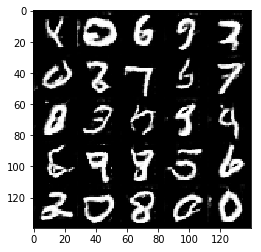

Epoch#2 progress:69.5%  dLoss:0.7501  gLoss:1.3039 
Epoch#2 progress:69.6%  dLoss:1.0331  gLoss:2.3365 
Epoch#2 progress:69.7%  dLoss:1.3610  gLoss:0.5857 
Epoch#2 progress:69.9%  dLoss:1.5386  gLoss:3.0740 
Epoch#2 progress:70.0%  dLoss:0.7359  gLoss:1.7246 
Epoch#2 progress:70.1%  dLoss:1.3456  gLoss:0.5688 
Epoch#2 progress:70.3%  dLoss:0.9596  gLoss:1.2261 
Epoch#2 progress:70.4%  dLoss:0.6786  gLoss:1.9208 
Epoch#2 progress:70.5%  dLoss:0.8450  gLoss:1.2406 
Epoch#2 progress:70.7%  dLoss:0.9727  gLoss:0.9771 


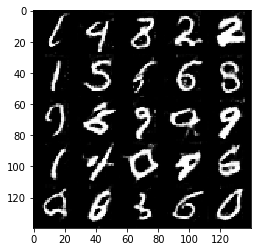

Epoch#2 progress:70.8%  dLoss:0.7844  gLoss:1.5145 
Epoch#2 progress:70.9%  dLoss:2.1590  gLoss:0.3292 
Epoch#2 progress:71.1%  dLoss:0.7458  gLoss:1.8866 
Epoch#2 progress:71.2%  dLoss:1.6178  gLoss:0.5901 
Epoch#2 progress:71.3%  dLoss:1.0876  gLoss:0.7014 
Epoch#2 progress:71.5%  dLoss:0.8099  gLoss:1.6029 
Epoch#2 progress:71.6%  dLoss:0.8871  gLoss:1.0895 
Epoch#2 progress:71.7%  dLoss:1.2427  gLoss:0.8368 
Epoch#2 progress:71.9%  dLoss:1.3408  gLoss:0.8485 
Epoch#2 progress:72.0%  dLoss:0.9197  gLoss:0.8440 


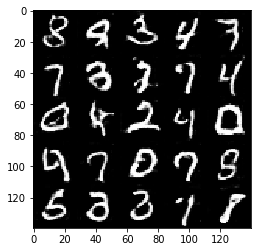

Epoch#2 progress:72.1%  dLoss:0.8482  gLoss:1.5385 
Epoch#2 progress:72.3%  dLoss:0.7520  gLoss:1.2319 
Epoch#2 progress:72.4%  dLoss:1.7072  gLoss:3.4078 
Epoch#2 progress:72.5%  dLoss:1.4171  gLoss:0.6066 
Epoch#2 progress:72.7%  dLoss:0.7967  gLoss:1.4965 
Epoch#2 progress:72.8%  dLoss:1.3041  gLoss:0.6105 
Epoch#2 progress:72.9%  dLoss:1.3104  gLoss:0.7116 
Epoch#2 progress:73.1%  dLoss:0.8890  gLoss:2.0210 
Epoch#2 progress:73.2%  dLoss:1.0548  gLoss:0.9321 
Epoch#2 progress:73.3%  dLoss:0.9893  gLoss:2.1908 


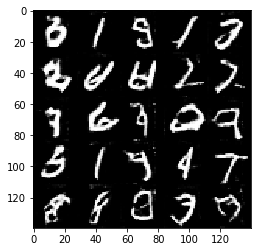

Epoch#2 progress:73.5%  dLoss:1.0548  gLoss:1.0487 
Epoch#2 progress:73.6%  dLoss:1.1822  gLoss:0.6510 
Epoch#2 progress:73.7%  dLoss:0.7203  gLoss:1.3594 
Epoch#2 progress:73.9%  dLoss:0.8246  gLoss:1.1884 
Epoch#2 progress:74.0%  dLoss:1.7928  gLoss:3.1588 
Epoch#2 progress:74.1%  dLoss:0.9675  gLoss:1.3932 
Epoch#2 progress:74.3%  dLoss:0.9336  gLoss:1.4769 
Epoch#2 progress:74.4%  dLoss:0.7368  gLoss:1.2980 
Epoch#2 progress:74.5%  dLoss:1.0518  gLoss:0.9565 
Epoch#2 progress:74.7%  dLoss:2.0236  gLoss:0.3562 


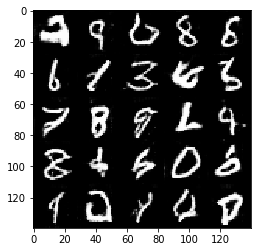

Epoch#2 progress:74.8%  dLoss:1.3054  gLoss:0.7174 
Epoch#2 progress:74.9%  dLoss:1.0246  gLoss:1.0958 
Epoch#2 progress:75.1%  dLoss:0.8718  gLoss:2.1282 
Epoch#2 progress:75.2%  dLoss:0.8534  gLoss:1.1083 
Epoch#2 progress:75.3%  dLoss:1.2488  gLoss:0.7249 
Epoch#2 progress:75.5%  dLoss:0.9276  gLoss:1.0040 
Epoch#2 progress:75.6%  dLoss:0.7449  gLoss:1.4733 
Epoch#2 progress:75.7%  dLoss:1.1415  gLoss:1.0113 
Epoch#2 progress:75.9%  dLoss:0.8569  gLoss:1.0447 
Epoch#2 progress:76.0%  dLoss:0.8453  gLoss:1.4525 


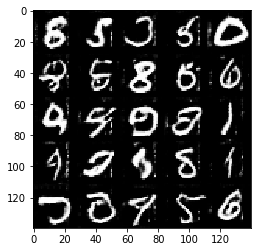

Epoch#2 progress:76.1%  dLoss:0.9838  gLoss:0.8868 
Epoch#2 progress:76.3%  dLoss:1.3089  gLoss:0.7704 
Epoch#2 progress:76.4%  dLoss:1.6585  gLoss:2.9679 
Epoch#2 progress:76.5%  dLoss:1.1776  gLoss:0.9478 
Epoch#2 progress:76.7%  dLoss:0.7965  gLoss:1.3088 
Epoch#2 progress:76.8%  dLoss:0.9132  gLoss:1.0793 
Epoch#2 progress:76.9%  dLoss:0.9297  gLoss:1.2615 
Epoch#2 progress:77.1%  dLoss:1.1002  gLoss:0.9365 
Epoch#2 progress:77.2%  dLoss:0.6067  gLoss:2.2742 
Epoch#2 progress:77.3%  dLoss:0.6579  gLoss:1.8854 


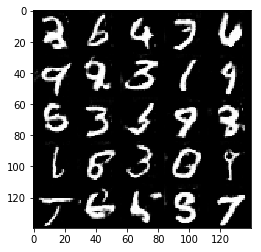

Epoch#2 progress:77.5%  dLoss:0.8095  gLoss:1.4370 
Epoch#2 progress:77.6%  dLoss:0.8011  gLoss:2.6907 
Epoch#2 progress:77.7%  dLoss:1.2655  gLoss:0.6332 
Epoch#2 progress:77.9%  dLoss:0.5919  gLoss:2.0488 
Epoch#2 progress:78.0%  dLoss:1.0184  gLoss:0.9189 
Epoch#2 progress:78.1%  dLoss:1.8015  gLoss:0.5203 
Epoch#2 progress:78.3%  dLoss:1.2211  gLoss:0.7184 
Epoch#2 progress:78.4%  dLoss:1.2149  gLoss:1.1859 
Epoch#2 progress:78.5%  dLoss:0.7612  gLoss:1.4868 
Epoch#2 progress:78.7%  dLoss:1.0622  gLoss:2.3154 


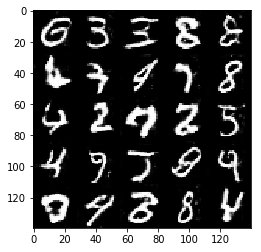

Epoch#2 progress:78.8%  dLoss:0.6808  gLoss:1.5213 
Epoch#2 progress:78.9%  dLoss:0.9694  gLoss:1.0089 
Epoch#2 progress:79.1%  dLoss:1.9946  gLoss:0.2710 
Epoch#2 progress:79.2%  dLoss:0.6837  gLoss:1.5609 
Epoch#2 progress:79.3%  dLoss:0.7699  gLoss:1.6374 
Epoch#2 progress:79.5%  dLoss:1.6742  gLoss:3.7890 
Epoch#2 progress:79.6%  dLoss:0.9149  gLoss:0.9823 
Epoch#2 progress:79.7%  dLoss:0.9688  gLoss:1.0717 
Epoch#2 progress:79.9%  dLoss:1.9511  gLoss:0.4123 
Epoch#2 progress:80.0%  dLoss:0.8354  gLoss:1.1569 


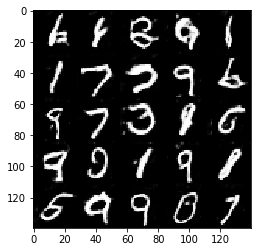

Epoch#2 progress:80.1%  dLoss:0.8858  gLoss:1.0921 
Epoch#2 progress:80.3%  dLoss:0.8868  gLoss:1.1952 
Epoch#2 progress:80.4%  dLoss:0.7204  gLoss:1.6797 
Epoch#2 progress:80.5%  dLoss:1.1396  gLoss:0.9005 
Epoch#2 progress:80.7%  dLoss:1.4628  gLoss:0.5666 
Epoch#2 progress:80.8%  dLoss:1.0597  gLoss:1.0462 
Epoch#2 progress:80.9%  dLoss:0.9237  gLoss:1.0731 
Epoch#2 progress:81.1%  dLoss:0.8606  gLoss:1.1201 
Epoch#2 progress:81.2%  dLoss:0.8227  gLoss:1.1622 
Epoch#2 progress:81.3%  dLoss:0.5758  gLoss:2.1639 


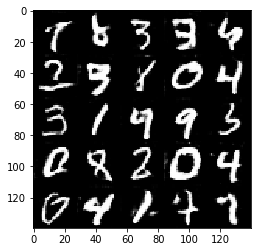

Epoch#2 progress:81.5%  dLoss:0.8693  gLoss:1.3364 
Epoch#2 progress:81.6%  dLoss:0.7016  gLoss:1.4469 
Epoch#2 progress:81.7%  dLoss:1.0882  gLoss:1.0434 
Epoch#2 progress:81.9%  dLoss:0.9015  gLoss:1.1675 
Epoch#2 progress:82.0%  dLoss:1.5507  gLoss:0.4903 
Epoch#2 progress:82.1%  dLoss:0.8595  gLoss:1.3556 
Epoch#2 progress:82.3%  dLoss:1.0866  gLoss:0.9734 
Epoch#2 progress:82.4%  dLoss:0.6382  gLoss:1.5273 
Epoch#2 progress:82.5%  dLoss:1.0189  gLoss:0.9822 
Epoch#2 progress:82.7%  dLoss:0.6507  gLoss:2.5240 


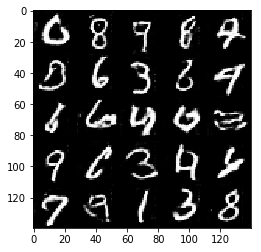

Epoch#2 progress:82.8%  dLoss:1.4536  gLoss:0.6380 
Epoch#2 progress:82.9%  dLoss:0.7078  gLoss:1.5428 
Epoch#2 progress:83.1%  dLoss:0.7261  gLoss:1.8739 
Epoch#2 progress:83.2%  dLoss:0.6103  gLoss:1.8432 
Epoch#2 progress:83.3%  dLoss:0.7250  gLoss:1.4505 
Epoch#2 progress:83.5%  dLoss:0.5546  gLoss:2.3910 
Epoch#2 progress:83.6%  dLoss:1.9904  gLoss:0.3014 
Epoch#2 progress:83.7%  dLoss:1.4515  gLoss:0.5026 
Epoch#2 progress:83.9%  dLoss:1.5675  gLoss:0.7671 
Epoch#2 progress:84.0%  dLoss:0.7203  gLoss:1.7889 


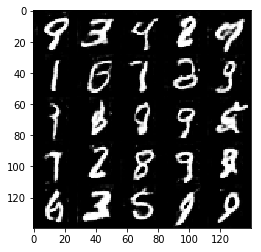

Epoch#2 progress:84.1%  dLoss:0.8253  gLoss:1.0194 
Epoch#2 progress:84.3%  dLoss:1.1063  gLoss:0.8170 
Epoch#2 progress:84.4%  dLoss:1.6993  gLoss:0.6941 
Epoch#2 progress:84.5%  dLoss:0.9098  gLoss:2.2507 
Epoch#2 progress:84.7%  dLoss:0.6863  gLoss:2.1122 
Epoch#2 progress:84.8%  dLoss:2.0514  gLoss:0.4501 
Epoch#2 progress:84.9%  dLoss:2.3125  gLoss:0.2019 
Epoch#2 progress:85.1%  dLoss:1.5065  gLoss:0.5688 
Epoch#2 progress:85.2%  dLoss:0.8821  gLoss:1.2314 
Epoch#2 progress:85.3%  dLoss:1.1644  gLoss:0.9455 


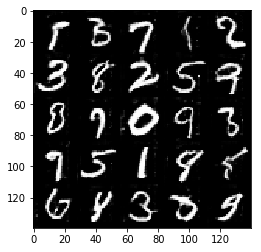

Epoch#2 progress:85.5%  dLoss:1.5568  gLoss:0.3830 
Epoch#2 progress:85.6%  dLoss:1.0517  gLoss:0.9987 
Epoch#2 progress:85.7%  dLoss:0.7268  gLoss:1.3467 
Epoch#2 progress:85.9%  dLoss:0.9272  gLoss:1.1909 
Epoch#2 progress:86.0%  dLoss:0.8804  gLoss:1.1551 
Epoch#2 progress:86.1%  dLoss:0.9245  gLoss:1.1103 
Epoch#2 progress:86.3%  dLoss:0.8910  gLoss:1.0967 
Epoch#2 progress:86.4%  dLoss:0.8008  gLoss:1.3220 
Epoch#2 progress:86.5%  dLoss:2.3467  gLoss:0.2403 
Epoch#2 progress:86.7%  dLoss:0.6875  gLoss:1.9005 


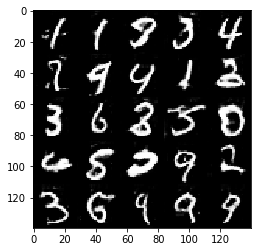

Epoch#2 progress:86.8%  dLoss:0.7825  gLoss:1.6478 
Epoch#2 progress:86.9%  dLoss:1.2996  gLoss:0.8628 
Epoch#2 progress:87.1%  dLoss:0.8187  gLoss:1.8149 
Epoch#2 progress:87.2%  dLoss:0.8370  gLoss:1.3527 
Epoch#2 progress:87.3%  dLoss:0.7326  gLoss:1.4853 
Epoch#2 progress:87.5%  dLoss:0.8141  gLoss:1.8253 
Epoch#2 progress:87.6%  dLoss:1.0257  gLoss:0.9801 
Epoch#2 progress:87.7%  dLoss:3.0579  gLoss:0.2549 
Epoch#2 progress:87.9%  dLoss:1.2944  gLoss:0.8533 
Epoch#2 progress:88.0%  dLoss:1.2143  gLoss:0.7108 


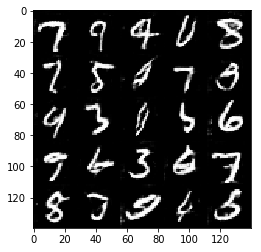

Epoch#2 progress:88.1%  dLoss:1.2345  gLoss:0.9353 
Epoch#2 progress:88.3%  dLoss:1.1181  gLoss:0.8674 
Epoch#2 progress:88.4%  dLoss:0.6246  gLoss:2.2610 
Epoch#2 progress:88.5%  dLoss:0.8001  gLoss:1.1792 
Epoch#2 progress:88.7%  dLoss:0.7410  gLoss:1.3514 
Epoch#2 progress:88.8%  dLoss:0.9992  gLoss:2.0109 
Epoch#2 progress:88.9%  dLoss:1.1801  gLoss:0.8231 
Epoch#2 progress:89.1%  dLoss:2.0599  gLoss:0.3323 
Epoch#2 progress:89.2%  dLoss:0.9418  gLoss:1.0065 
Epoch#2 progress:89.3%  dLoss:0.8871  gLoss:1.4323 


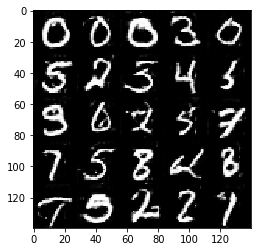

Epoch#2 progress:89.5%  dLoss:0.9198  gLoss:1.1897 
Epoch#2 progress:89.6%  dLoss:1.0421  gLoss:0.8966 
Epoch#2 progress:89.7%  dLoss:0.8355  gLoss:1.4360 
Epoch#2 progress:89.9%  dLoss:0.5640  gLoss:2.3548 
Epoch#2 progress:90.0%  dLoss:0.9605  gLoss:1.0798 
Epoch#2 progress:90.1%  dLoss:0.8857  gLoss:1.2238 
Epoch#2 progress:90.3%  dLoss:2.1704  gLoss:0.2532 
Epoch#2 progress:90.4%  dLoss:1.6454  gLoss:0.4892 
Epoch#2 progress:90.5%  dLoss:0.6942  gLoss:1.4929 
Epoch#2 progress:90.7%  dLoss:1.1112  gLoss:0.8803 


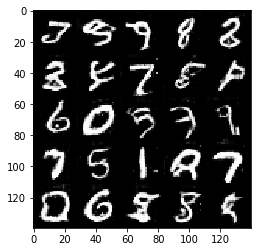

Epoch#2 progress:90.8%  dLoss:0.9378  gLoss:1.1134 
Epoch#2 progress:90.9%  dLoss:1.5972  gLoss:0.4507 
Epoch#2 progress:91.1%  dLoss:1.0056  gLoss:1.0373 
Epoch#2 progress:91.2%  dLoss:0.8664  gLoss:2.6586 
Epoch#2 progress:91.3%  dLoss:0.6068  gLoss:2.7128 
Epoch#2 progress:91.5%  dLoss:0.9509  gLoss:1.0016 
Epoch#2 progress:91.6%  dLoss:1.0281  gLoss:0.9952 
Epoch#2 progress:91.7%  dLoss:0.7676  gLoss:1.6971 
Epoch#2 progress:91.9%  dLoss:0.7708  gLoss:1.3903 
Epoch#2 progress:92.0%  dLoss:1.1323  gLoss:0.7707 


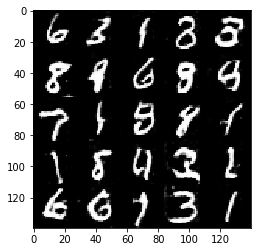

Epoch#2 progress:92.1%  dLoss:0.6237  gLoss:1.8396 
Epoch#2 progress:92.3%  dLoss:2.1266  gLoss:0.3485 
Epoch#2 progress:92.4%  dLoss:0.9185  gLoss:0.9325 
Epoch#2 progress:92.5%  dLoss:0.7115  gLoss:1.3819 
Epoch#2 progress:92.7%  dLoss:0.6537  gLoss:1.5810 
Epoch#2 progress:92.8%  dLoss:1.0172  gLoss:0.9462 
Epoch#2 progress:92.9%  dLoss:2.0098  gLoss:0.2907 
Epoch#2 progress:93.1%  dLoss:1.1081  gLoss:0.6794 
Epoch#2 progress:93.2%  dLoss:0.6956  gLoss:1.7260 
Epoch#2 progress:93.3%  dLoss:1.4719  gLoss:0.5704 


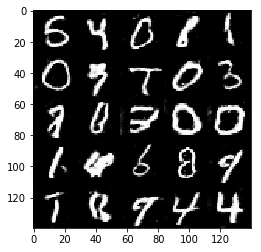

Epoch#2 progress:93.5%  dLoss:0.7914  gLoss:1.3643 
Epoch#2 progress:93.6%  dLoss:0.7173  gLoss:1.8523 
Epoch#2 progress:93.7%  dLoss:0.8681  gLoss:1.7616 
Epoch#2 progress:93.9%  dLoss:1.0036  gLoss:1.0202 
Epoch#2 progress:94.0%  dLoss:1.0319  gLoss:1.1672 
Epoch#2 progress:94.1%  dLoss:0.6848  gLoss:2.0061 
Epoch#2 progress:94.3%  dLoss:0.6089  gLoss:1.8330 
Epoch#2 progress:94.4%  dLoss:0.8882  gLoss:1.2454 
Epoch#2 progress:94.5%  dLoss:0.6957  gLoss:1.7805 
Epoch#2 progress:94.7%  dLoss:0.9292  gLoss:1.6462 


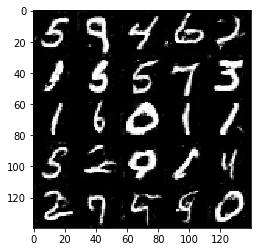

Epoch#2 progress:94.8%  dLoss:1.2073  gLoss:0.6404 
Epoch#2 progress:94.9%  dLoss:1.1881  gLoss:0.7476 
Epoch#2 progress:95.1%  dLoss:0.7604  gLoss:1.2045 
Epoch#2 progress:95.2%  dLoss:1.1462  gLoss:0.7565 
Epoch#2 progress:95.3%  dLoss:0.7712  gLoss:1.4044 
Epoch#2 progress:95.5%  dLoss:1.1054  gLoss:0.8282 
Epoch#2 progress:95.6%  dLoss:1.1705  gLoss:2.1989 
Epoch#2 progress:95.7%  dLoss:0.7480  gLoss:1.6883 
Epoch#2 progress:95.9%  dLoss:0.6826  gLoss:1.7256 
Epoch#2 progress:96.0%  dLoss:1.3153  gLoss:0.5381 


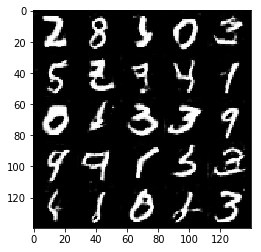

Epoch#2 progress:96.1%  dLoss:0.6697  gLoss:1.7246 
Epoch#2 progress:96.3%  dLoss:0.9351  gLoss:3.3181 
Epoch#2 progress:96.4%  dLoss:0.6415  gLoss:1.4714 
Epoch#2 progress:96.5%  dLoss:0.4915  gLoss:2.4067 
Epoch#2 progress:96.7%  dLoss:1.2520  gLoss:0.8230 
Epoch#2 progress:96.8%  dLoss:0.8166  gLoss:1.4746 
Epoch#2 progress:96.9%  dLoss:0.7708  gLoss:1.3798 
Epoch#2 progress:97.1%  dLoss:0.9392  gLoss:1.6515 
Epoch#2 progress:97.2%  dLoss:1.2967  gLoss:0.7246 
Epoch#2 progress:97.3%  dLoss:0.4721  gLoss:2.6894 


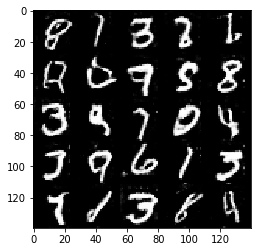

Epoch#2 progress:97.5%  dLoss:0.9025  gLoss:1.0556 
Epoch#2 progress:97.6%  dLoss:1.2445  gLoss:1.2034 
Epoch#2 progress:97.7%  dLoss:0.8172  gLoss:1.5411 
Epoch#2 progress:97.9%  dLoss:1.6676  gLoss:0.7502 
Epoch#2 progress:98.0%  dLoss:0.8965  gLoss:1.3558 
Epoch#2 progress:98.1%  dLoss:1.0388  gLoss:1.2508 
Epoch#2 progress:98.3%  dLoss:1.8202  gLoss:0.5004 
Epoch#2 progress:98.4%  dLoss:0.6707  gLoss:2.1385 
Epoch#2 progress:98.5%  dLoss:0.9004  gLoss:1.2440 
Epoch#2 progress:98.7%  dLoss:1.1934  gLoss:0.8984 


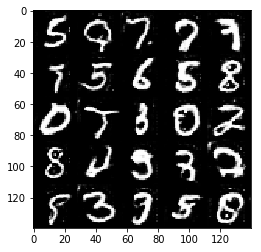

Epoch#2 progress:98.8%  dLoss:1.0364  gLoss:0.7763 
Epoch#2 progress:98.9%  dLoss:0.8507  gLoss:1.5116 
Epoch#2 progress:99.1%  dLoss:0.9037  gLoss:1.2130 
Epoch#2 progress:99.2%  dLoss:0.8763  gLoss:1.4587 
Epoch#2 progress:99.3%  dLoss:0.7381  gLoss:1.5016 
Epoch#2 progress:99.5%  dLoss:0.6421  gLoss:2.3594 
Epoch#2 progress:99.6%  dLoss:1.0212  gLoss:2.6832 
Epoch#2 progress:99.7%  dLoss:0.8571  gLoss:1.4335 
Epoch#2 progress:99.9%  dLoss:0.9712  gLoss:1.0413 
Epoch#2 progress:100.0%  dLoss:0.8982  gLoss:1.2291 


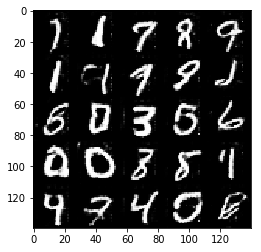

In [ ]:
batch_size = 16
z_dim = 128
learning_rate = 0.0008
beta1 = 0.25


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch#1 progress:0.1%  dLoss:3.7410  gLoss:0.8690 
Epoch#1 progress:0.2%  dLoss:3.0535  gLoss:0.3368 
Epoch#1 progress:0.2%  dLoss:3.0060  gLoss:1.1666 
Epoch#1 progress:0.3%  dLoss:1.9794  gLoss:1.3714 
Epoch#1 progress:0.4%  dLoss:5.4909  gLoss:0.3010 
Epoch#1 progress:0.5%  dLoss:4.9861  gLoss:0.0611 
Epoch#1 progress:0.6%  dLoss:2.9578  gLoss:0.2605 
Epoch#1 progress:0.6%  dLoss:1.7825  gLoss:0.6574 
Epoch#1 progress:0.7%  dLoss:2.0408  gLoss:0.3580 
Epoch#1 progress:0.8%  dLoss:2.3292  gLoss:0.8502 


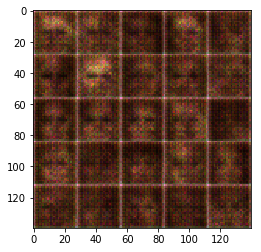

Epoch#1 progress:0.9%  dLoss:1.9269  gLoss:0.7813 
Epoch#1 progress:0.9%  dLoss:2.2933  gLoss:0.2243 
Epoch#1 progress:1.0%  dLoss:1.3101  gLoss:1.2335 
Epoch#1 progress:1.1%  dLoss:3.2628  gLoss:0.1478 
Epoch#1 progress:1.2%  dLoss:3.7174  gLoss:0.1445 
Epoch#1 progress:1.3%  dLoss:1.2340  gLoss:0.7979 
Epoch#1 progress:1.3%  dLoss:1.8276  gLoss:0.4675 
Epoch#1 progress:1.4%  dLoss:0.6799  gLoss:3.0652 
Epoch#1 progress:1.5%  dLoss:1.9724  gLoss:0.4046 
Epoch#1 progress:1.6%  dLoss:1.1603  gLoss:1.4126 


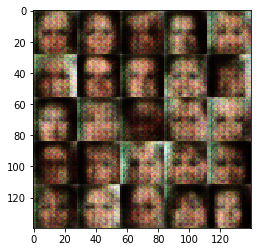

Epoch#1 progress:1.7%  dLoss:2.2698  gLoss:3.2110 
Epoch#1 progress:1.7%  dLoss:1.3193  gLoss:0.7273 
Epoch#1 progress:1.8%  dLoss:0.9216  gLoss:1.9035 
Epoch#1 progress:1.9%  dLoss:2.7968  gLoss:0.2308 
Epoch#1 progress:2.0%  dLoss:1.1145  gLoss:2.3771 
Epoch#1 progress:2.1%  dLoss:1.2740  gLoss:0.7563 
Epoch#1 progress:2.1%  dLoss:2.3005  gLoss:0.3378 
Epoch#1 progress:2.2%  dLoss:1.1192  gLoss:1.0601 
Epoch#1 progress:2.3%  dLoss:2.9062  gLoss:0.1220 
Epoch#1 progress:2.4%  dLoss:0.8098  gLoss:1.9038 


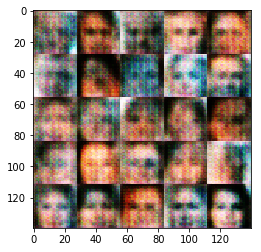

Epoch#1 progress:2.4%  dLoss:0.8992  gLoss:1.4750 
Epoch#1 progress:2.5%  dLoss:1.7619  gLoss:1.5976 
Epoch#1 progress:2.6%  dLoss:0.8416  gLoss:1.2872 
Epoch#1 progress:2.7%  dLoss:1.9806  gLoss:0.3385 
Epoch#1 progress:2.8%  dLoss:1.1124  gLoss:1.5268 
Epoch#1 progress:2.8%  dLoss:1.6178  gLoss:1.0298 
Epoch#1 progress:2.9%  dLoss:1.7059  gLoss:0.4925 
Epoch#1 progress:3.0%  dLoss:1.8001  gLoss:0.3435 
Epoch#1 progress:3.1%  dLoss:2.1532  gLoss:0.2991 
Epoch#1 progress:3.2%  dLoss:1.4885  gLoss:2.9018 


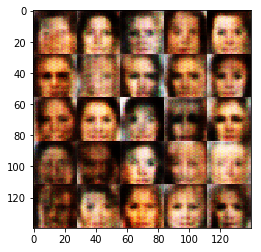

Epoch#1 progress:3.2%  dLoss:1.9578  gLoss:0.2867 
Epoch#1 progress:3.3%  dLoss:0.8771  gLoss:1.4515 
Epoch#1 progress:3.4%  dLoss:1.2473  gLoss:0.9013 
Epoch#1 progress:3.5%  dLoss:1.6643  gLoss:0.4009 
Epoch#1 progress:3.6%  dLoss:1.9971  gLoss:0.3041 
Epoch#1 progress:3.6%  dLoss:1.2402  gLoss:0.7380 
Epoch#1 progress:3.7%  dLoss:1.1298  gLoss:1.4566 
Epoch#1 progress:3.8%  dLoss:0.5395  gLoss:2.3394 
Epoch#1 progress:3.9%  dLoss:1.1964  gLoss:0.6776 
Epoch#1 progress:3.9%  dLoss:2.1575  gLoss:0.2629 


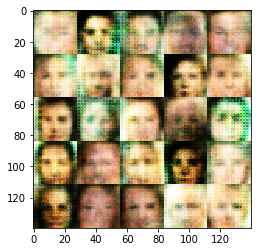

Epoch#1 progress:4.0%  dLoss:1.5746  gLoss:0.9959 
Epoch#1 progress:4.1%  dLoss:1.1632  gLoss:0.8066 
Epoch#1 progress:4.2%  dLoss:0.8849  gLoss:1.2290 
Epoch#1 progress:4.3%  dLoss:1.1840  gLoss:0.9228 
Epoch#1 progress:4.3%  dLoss:2.1625  gLoss:0.3275 
Epoch#1 progress:4.4%  dLoss:1.1088  gLoss:0.9687 
Epoch#1 progress:4.5%  dLoss:1.6597  gLoss:0.5307 
Epoch#1 progress:4.6%  dLoss:0.7638  gLoss:1.7963 
Epoch#1 progress:4.7%  dLoss:1.0730  gLoss:1.6349 
Epoch#1 progress:4.7%  dLoss:1.7849  gLoss:0.4671 


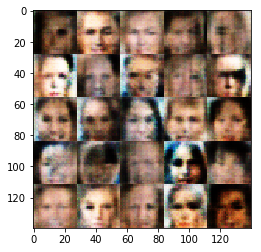

Epoch#1 progress:4.8%  dLoss:1.7909  gLoss:0.8380 
Epoch#1 progress:4.9%  dLoss:1.8090  gLoss:0.4064 
Epoch#1 progress:5.0%  dLoss:2.0979  gLoss:0.3955 
Epoch#1 progress:5.1%  dLoss:0.9901  gLoss:1.0981 
Epoch#1 progress:5.1%  dLoss:1.7924  gLoss:0.8677 
Epoch#1 progress:5.2%  dLoss:1.9889  gLoss:0.2817 
Epoch#1 progress:5.3%  dLoss:1.7897  gLoss:0.4282 
Epoch#1 progress:5.4%  dLoss:2.0223  gLoss:0.3031 
Epoch#1 progress:5.4%  dLoss:1.4228  gLoss:0.7591 
Epoch#1 progress:5.5%  dLoss:1.6930  gLoss:0.5164 


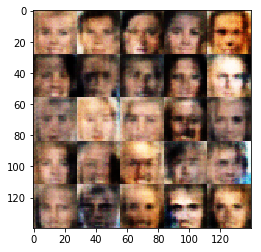

Epoch#1 progress:5.6%  dLoss:1.8516  gLoss:0.3639 
Epoch#1 progress:5.7%  dLoss:1.8202  gLoss:0.4780 
Epoch#1 progress:5.8%  dLoss:1.1176  gLoss:0.7633 
Epoch#1 progress:5.8%  dLoss:2.0268  gLoss:0.3443 
Epoch#1 progress:5.9%  dLoss:1.5311  gLoss:0.5953 
Epoch#1 progress:6.0%  dLoss:1.3967  gLoss:1.4031 
Epoch#1 progress:6.1%  dLoss:1.6394  gLoss:0.3841 
Epoch#1 progress:6.2%  dLoss:1.2237  gLoss:1.2678 
Epoch#1 progress:6.2%  dLoss:1.0181  gLoss:1.8313 
Epoch#1 progress:6.3%  dLoss:1.5936  gLoss:0.4601 


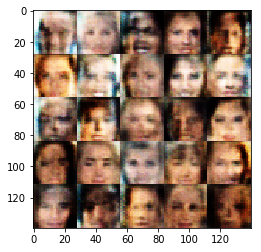

Epoch#1 progress:6.4%  dLoss:0.9507  gLoss:1.1026 
Epoch#1 progress:6.5%  dLoss:1.5927  gLoss:0.4942 
Epoch#1 progress:6.6%  dLoss:1.1927  gLoss:1.5629 
Epoch#1 progress:6.6%  dLoss:0.8194  gLoss:1.9257 
Epoch#1 progress:6.7%  dLoss:0.6094  gLoss:2.1397 
Epoch#1 progress:6.8%  dLoss:1.3229  gLoss:1.8329 
Epoch#1 progress:6.9%  dLoss:0.9087  gLoss:1.3353 
Epoch#1 progress:6.9%  dLoss:2.0633  gLoss:0.4276 
Epoch#1 progress:7.0%  dLoss:1.8342  gLoss:0.4382 
Epoch#1 progress:7.1%  dLoss:0.9065  gLoss:1.0913 


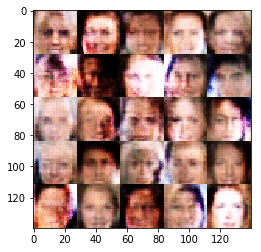

Epoch#1 progress:7.2%  dLoss:1.2159  gLoss:0.6447 
Epoch#1 progress:7.3%  dLoss:1.1503  gLoss:0.6593 
Epoch#1 progress:7.3%  dLoss:1.2350  gLoss:1.3204 
Epoch#1 progress:7.4%  dLoss:0.7892  gLoss:2.2946 
Epoch#1 progress:7.5%  dLoss:1.0433  gLoss:1.6995 
Epoch#1 progress:7.6%  dLoss:0.8601  gLoss:1.0766 
Epoch#1 progress:7.7%  dLoss:1.0400  gLoss:1.6487 
Epoch#1 progress:7.7%  dLoss:0.7136  gLoss:2.4590 
Epoch#1 progress:7.8%  dLoss:1.7004  gLoss:0.4315 
Epoch#1 progress:7.9%  dLoss:0.7097  gLoss:2.0389 


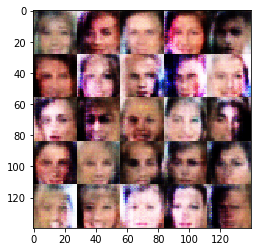

Epoch#1 progress:8.0%  dLoss:1.8635  gLoss:4.2219 
Epoch#1 progress:8.1%  dLoss:1.1133  gLoss:2.4168 
Epoch#1 progress:8.1%  dLoss:1.4696  gLoss:0.6946 
Epoch#1 progress:8.2%  dLoss:0.6026  gLoss:1.7756 
Epoch#1 progress:8.3%  dLoss:1.0755  gLoss:1.2534 
Epoch#1 progress:8.4%  dLoss:2.7803  gLoss:0.1458 
Epoch#1 progress:8.5%  dLoss:1.1623  gLoss:3.1863 
Epoch#1 progress:8.5%  dLoss:1.0581  gLoss:1.0061 
Epoch#1 progress:8.6%  dLoss:1.3936  gLoss:1.0460 
Epoch#1 progress:8.7%  dLoss:0.5934  gLoss:2.1543 


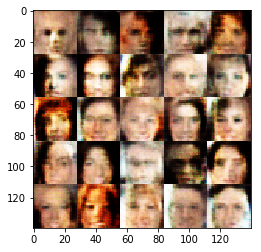

Epoch#1 progress:8.8%  dLoss:0.6267  gLoss:2.4139 
Epoch#1 progress:8.8%  dLoss:0.4447  gLoss:2.6983 
Epoch#1 progress:8.9%  dLoss:1.4225  gLoss:0.6162 
Epoch#1 progress:9.0%  dLoss:1.0878  gLoss:1.4857 
Epoch#1 progress:9.1%  dLoss:2.0528  gLoss:0.3168 
Epoch#1 progress:9.2%  dLoss:1.4180  gLoss:2.9216 
Epoch#1 progress:9.2%  dLoss:1.7231  gLoss:0.6136 
Epoch#1 progress:9.3%  dLoss:1.3126  gLoss:0.6232 
Epoch#1 progress:9.4%  dLoss:0.7380  gLoss:2.3316 
Epoch#1 progress:9.5%  dLoss:0.5836  gLoss:3.0705 


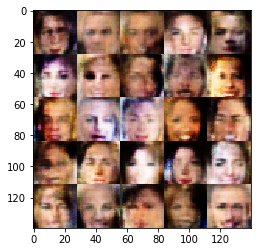

Epoch#1 progress:9.6%  dLoss:1.5746  gLoss:1.6237 
Epoch#1 progress:9.6%  dLoss:1.5183  gLoss:1.1423 
Epoch#1 progress:9.7%  dLoss:0.7678  gLoss:1.6321 
Epoch#1 progress:9.8%  dLoss:0.8572  gLoss:0.9964 
Epoch#1 progress:9.9%  dLoss:0.5962  gLoss:1.9069 
Epoch#1 progress:10.0%  dLoss:1.8241  gLoss:0.3742 
Epoch#1 progress:10.0%  dLoss:0.7849  gLoss:1.3930 
Epoch#1 progress:10.1%  dLoss:0.8845  gLoss:1.1515 
Epoch#1 progress:10.2%  dLoss:0.4699  gLoss:6.5234 
Epoch#1 progress:10.3%  dLoss:0.6017  gLoss:2.0864 


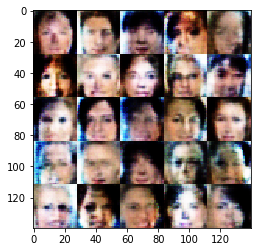

Epoch#1 progress:10.3%  dLoss:1.0230  gLoss:0.8916 
Epoch#1 progress:10.4%  dLoss:0.6086  gLoss:2.3317 
Epoch#1 progress:10.5%  dLoss:0.6305  gLoss:2.9253 
Epoch#1 progress:10.6%  dLoss:1.0471  gLoss:5.5996 
Epoch#1 progress:10.7%  dLoss:1.3064  gLoss:2.3083 
Epoch#1 progress:10.7%  dLoss:0.5377  gLoss:2.6676 
Epoch#1 progress:10.8%  dLoss:0.7157  gLoss:1.7859 
Epoch#1 progress:10.9%  dLoss:0.7711  gLoss:3.4759 
Epoch#1 progress:11.0%  dLoss:0.6748  gLoss:1.4253 
Epoch#1 progress:11.1%  dLoss:0.5993  gLoss:2.0421 


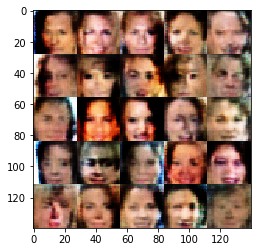

Epoch#1 progress:11.1%  dLoss:0.4588  gLoss:4.4533 
Epoch#1 progress:11.2%  dLoss:0.4916  gLoss:2.9495 
Epoch#1 progress:11.3%  dLoss:0.8864  gLoss:1.1737 
Epoch#1 progress:11.4%  dLoss:0.7340  gLoss:1.6304 
Epoch#1 progress:11.5%  dLoss:0.5921  gLoss:2.8752 
Epoch#1 progress:11.5%  dLoss:0.5537  gLoss:2.6651 
Epoch#1 progress:11.6%  dLoss:0.5517  gLoss:3.5115 
Epoch#1 progress:11.7%  dLoss:0.5258  gLoss:2.6681 
Epoch#1 progress:11.8%  dLoss:0.5518  gLoss:2.2646 
Epoch#1 progress:11.8%  dLoss:1.0011  gLoss:1.0446 


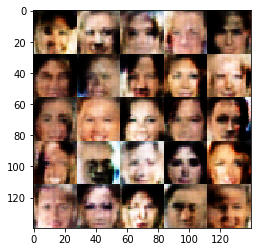

Epoch#1 progress:11.9%  dLoss:0.5481  gLoss:2.1441 
Epoch#1 progress:12.0%  dLoss:1.0009  gLoss:1.0592 
Epoch#1 progress:12.1%  dLoss:0.4901  gLoss:2.2623 
Epoch#1 progress:12.2%  dLoss:0.5851  gLoss:2.6595 
Epoch#1 progress:12.2%  dLoss:0.8614  gLoss:1.2953 
Epoch#1 progress:12.3%  dLoss:0.5717  gLoss:3.6615 
Epoch#1 progress:12.4%  dLoss:0.6214  gLoss:3.6694 
Epoch#1 progress:12.5%  dLoss:0.4876  gLoss:2.5268 
Epoch#1 progress:12.6%  dLoss:0.5927  gLoss:3.4095 
Epoch#1 progress:12.6%  dLoss:0.5365  gLoss:2.5774 


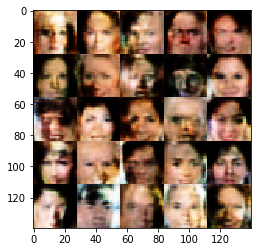

Epoch#1 progress:12.7%  dLoss:0.7350  gLoss:2.0578 
Epoch#1 progress:12.8%  dLoss:0.5271  gLoss:3.2886 
Epoch#1 progress:12.9%  dLoss:0.5914  gLoss:4.3487 
Epoch#1 progress:13.0%  dLoss:0.4356  gLoss:4.8724 
Epoch#1 progress:13.0%  dLoss:0.6199  gLoss:2.1431 
Epoch#1 progress:13.1%  dLoss:0.7431  gLoss:4.9542 
Epoch#1 progress:13.2%  dLoss:0.4413  gLoss:2.9478 
Epoch#1 progress:13.3%  dLoss:0.5661  gLoss:3.7218 
Epoch#1 progress:13.3%  dLoss:0.5725  gLoss:3.0599 
Epoch#1 progress:13.4%  dLoss:0.6569  gLoss:2.0759 


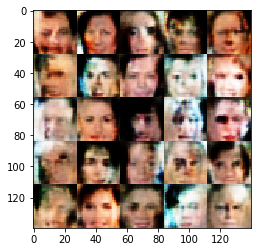

Epoch#1 progress:13.5%  dLoss:0.5534  gLoss:4.5694 
Epoch#1 progress:13.6%  dLoss:1.7439  gLoss:4.9889 
Epoch#1 progress:13.7%  dLoss:0.5872  gLoss:3.8527 
Epoch#1 progress:13.7%  dLoss:0.4710  gLoss:3.2699 
Epoch#1 progress:13.8%  dLoss:0.6563  gLoss:4.2035 
Epoch#1 progress:13.9%  dLoss:0.3958  gLoss:4.1622 
Epoch#1 progress:14.0%  dLoss:0.5564  gLoss:3.1181 
Epoch#1 progress:14.1%  dLoss:0.4414  gLoss:4.5304 
Epoch#1 progress:14.1%  dLoss:0.5967  gLoss:3.6666 
Epoch#1 progress:14.2%  dLoss:0.6670  gLoss:1.6206 


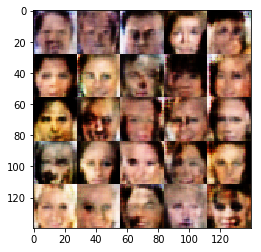

Epoch#1 progress:14.3%  dLoss:0.4050  gLoss:4.1024 
Epoch#1 progress:14.4%  dLoss:0.4547  gLoss:3.3652 
Epoch#1 progress:14.5%  dLoss:0.4299  gLoss:4.2187 
Epoch#1 progress:14.5%  dLoss:0.4459  gLoss:5.3940 
Epoch#1 progress:14.6%  dLoss:0.4443  gLoss:3.7519 
Epoch#1 progress:14.7%  dLoss:0.7912  gLoss:2.0885 
Epoch#1 progress:14.8%  dLoss:0.7021  gLoss:1.8647 
Epoch#1 progress:14.8%  dLoss:0.3934  gLoss:4.2145 
Epoch#1 progress:14.9%  dLoss:0.6166  gLoss:3.1323 
Epoch#1 progress:15.0%  dLoss:0.4609  gLoss:3.7802 


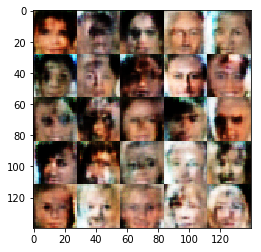

Epoch#1 progress:15.1%  dLoss:0.6588  gLoss:4.9431 
Epoch#1 progress:15.2%  dLoss:0.4918  gLoss:2.9388 
Epoch#1 progress:15.2%  dLoss:0.5065  gLoss:4.5909 
Epoch#1 progress:15.3%  dLoss:0.9108  gLoss:1.2545 
Epoch#1 progress:15.4%  dLoss:0.4570  gLoss:4.2869 
Epoch#1 progress:15.5%  dLoss:0.6643  gLoss:2.3259 
Epoch#1 progress:15.6%  dLoss:0.5784  gLoss:4.6129 
Epoch#1 progress:15.6%  dLoss:0.5090  gLoss:2.6700 
Epoch#1 progress:15.7%  dLoss:0.4416  gLoss:3.7701 
Epoch#1 progress:15.8%  dLoss:0.4896  gLoss:3.7476 


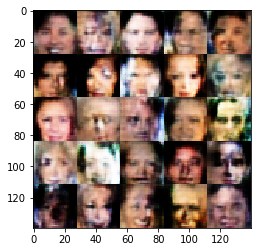

Epoch#1 progress:15.9%  dLoss:0.4000  gLoss:3.7857 
Epoch#1 progress:16.0%  dLoss:0.4467  gLoss:4.4191 
Epoch#1 progress:16.0%  dLoss:0.4553  gLoss:4.0450 
Epoch#1 progress:16.1%  dLoss:0.4436  gLoss:2.8952 
Epoch#1 progress:16.2%  dLoss:0.4473  gLoss:2.6410 
Epoch#1 progress:16.3%  dLoss:0.5334  gLoss:2.2934 
Epoch#1 progress:16.3%  dLoss:0.5652  gLoss:2.0970 
Epoch#1 progress:16.4%  dLoss:0.4144  gLoss:4.6747 
Epoch#1 progress:16.5%  dLoss:0.3962  gLoss:4.2906 
Epoch#1 progress:16.6%  dLoss:0.4566  gLoss:3.5760 


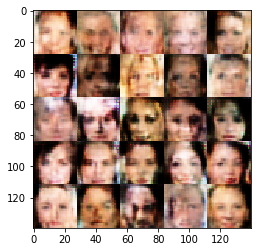

Epoch#1 progress:16.7%  dLoss:0.7943  gLoss:3.6124 
Epoch#1 progress:16.7%  dLoss:0.8383  gLoss:4.9506 
Epoch#1 progress:16.8%  dLoss:0.4222  gLoss:3.1890 
Epoch#1 progress:16.9%  dLoss:0.5694  gLoss:3.6206 
Epoch#1 progress:17.0%  dLoss:0.5806  gLoss:4.1984 
Epoch#1 progress:17.1%  dLoss:0.4955  gLoss:3.5208 
Epoch#1 progress:17.1%  dLoss:0.3698  gLoss:4.9546 
Epoch#1 progress:17.2%  dLoss:0.4278  gLoss:6.1050 
Epoch#1 progress:17.3%  dLoss:0.4645  gLoss:3.0774 
Epoch#1 progress:17.4%  dLoss:0.4290  gLoss:5.8056 


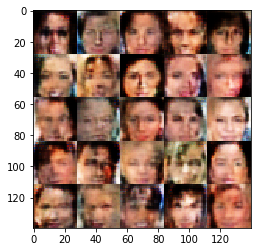

Epoch#1 progress:17.5%  dLoss:0.4688  gLoss:3.4216 
Epoch#1 progress:17.5%  dLoss:0.4894  gLoss:3.6814 
Epoch#1 progress:17.6%  dLoss:2.9704  gLoss:5.6565 
Epoch#1 progress:17.7%  dLoss:0.5252  gLoss:2.7430 
Epoch#1 progress:17.8%  dLoss:1.5658  gLoss:4.7842 
Epoch#1 progress:17.8%  dLoss:0.4255  gLoss:4.4864 
Epoch#1 progress:17.9%  dLoss:0.5726  gLoss:4.1272 
Epoch#1 progress:18.0%  dLoss:0.3852  gLoss:4.0174 
Epoch#1 progress:18.1%  dLoss:0.7102  gLoss:1.5534 
Epoch#1 progress:18.2%  dLoss:1.0270  gLoss:5.6941 


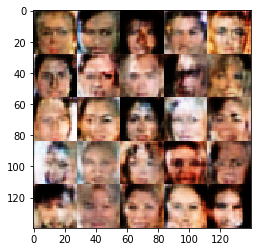

Epoch#1 progress:18.2%  dLoss:0.4839  gLoss:5.4601 
Epoch#1 progress:18.3%  dLoss:0.5943  gLoss:2.8509 
Epoch#1 progress:18.4%  dLoss:0.6256  gLoss:4.5733 
Epoch#1 progress:18.5%  dLoss:0.6302  gLoss:3.7458 
Epoch#1 progress:18.6%  dLoss:0.5990  gLoss:4.2298 
Epoch#1 progress:18.6%  dLoss:0.4678  gLoss:4.9120 
Epoch#1 progress:18.7%  dLoss:0.4879  gLoss:5.3461 
Epoch#1 progress:18.8%  dLoss:0.5598  gLoss:3.9935 
Epoch#1 progress:18.9%  dLoss:0.3897  gLoss:4.9426 
Epoch#1 progress:19.0%  dLoss:0.5907  gLoss:3.8031 


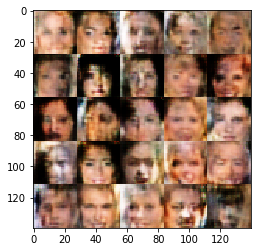

Epoch#1 progress:19.0%  dLoss:0.4712  gLoss:5.8133 
Epoch#1 progress:19.1%  dLoss:0.5203  gLoss:4.2043 
Epoch#1 progress:19.2%  dLoss:0.7415  gLoss:2.1794 
Epoch#1 progress:19.3%  dLoss:0.5052  gLoss:2.9263 
Epoch#1 progress:19.3%  dLoss:0.9524  gLoss:4.7198 
Epoch#1 progress:19.4%  dLoss:0.4841  gLoss:4.1717 
Epoch#1 progress:19.5%  dLoss:0.7154  gLoss:3.5872 
Epoch#1 progress:19.6%  dLoss:0.6432  gLoss:2.1359 
Epoch#1 progress:19.7%  dLoss:0.4605  gLoss:3.0824 
Epoch#1 progress:19.7%  dLoss:0.4244  gLoss:4.0086 


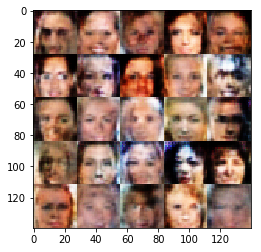

Epoch#1 progress:19.8%  dLoss:0.4574  gLoss:2.9173 
Epoch#1 progress:19.9%  dLoss:0.5157  gLoss:3.2229 
Epoch#1 progress:20.0%  dLoss:0.4445  gLoss:3.5989 
Epoch#1 progress:20.1%  dLoss:0.7374  gLoss:6.1020 
Epoch#1 progress:20.1%  dLoss:0.4980  gLoss:2.6163 
Epoch#1 progress:20.2%  dLoss:0.4852  gLoss:4.8947 
Epoch#1 progress:20.3%  dLoss:0.4112  gLoss:4.0851 
Epoch#1 progress:20.4%  dLoss:2.3586  gLoss:5.1352 
Epoch#1 progress:20.5%  dLoss:0.5764  gLoss:2.7999 
Epoch#1 progress:20.5%  dLoss:0.5014  gLoss:3.5824 


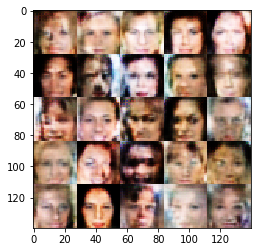

Epoch#1 progress:20.6%  dLoss:0.6227  gLoss:2.4484 
Epoch#1 progress:20.7%  dLoss:0.4750  gLoss:3.2293 
Epoch#1 progress:20.8%  dLoss:0.5069  gLoss:2.3912 
Epoch#1 progress:20.8%  dLoss:0.4852  gLoss:3.5669 
Epoch#1 progress:20.9%  dLoss:0.6161  gLoss:2.1491 
Epoch#1 progress:21.0%  dLoss:0.5800  gLoss:2.4082 
Epoch#1 progress:21.1%  dLoss:0.4886  gLoss:2.5976 
Epoch#1 progress:21.2%  dLoss:0.8017  gLoss:2.5267 
Epoch#1 progress:21.2%  dLoss:0.5041  gLoss:4.1968 
Epoch#1 progress:21.3%  dLoss:0.5473  gLoss:2.5128 


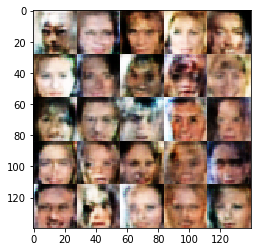

Epoch#1 progress:21.4%  dLoss:0.6420  gLoss:1.9237 
Epoch#1 progress:21.5%  dLoss:0.5385  gLoss:1.9517 
Epoch#1 progress:21.6%  dLoss:0.4960  gLoss:2.6844 
Epoch#1 progress:21.6%  dLoss:0.6860  gLoss:1.9532 
Epoch#1 progress:21.7%  dLoss:1.2339  gLoss:2.6156 
Epoch#1 progress:21.8%  dLoss:0.7951  gLoss:5.8989 
Epoch#1 progress:21.9%  dLoss:0.6146  gLoss:4.3966 
Epoch#1 progress:22.0%  dLoss:0.4575  gLoss:2.6789 
Epoch#1 progress:22.0%  dLoss:0.4565  gLoss:4.1873 
Epoch#1 progress:22.1%  dLoss:0.4546  gLoss:3.5314 


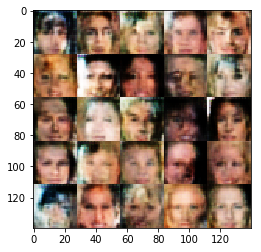

Epoch#1 progress:22.2%  dLoss:0.4651  gLoss:4.4244 
Epoch#1 progress:22.3%  dLoss:0.5683  gLoss:3.6653 
Epoch#1 progress:22.4%  dLoss:1.0774  gLoss:4.5170 
Epoch#1 progress:22.4%  dLoss:0.4297  gLoss:3.8137 
Epoch#1 progress:22.5%  dLoss:0.6085  gLoss:2.9488 
Epoch#1 progress:22.6%  dLoss:0.5428  gLoss:3.0065 
Epoch#1 progress:22.7%  dLoss:0.5163  gLoss:2.5867 
Epoch#1 progress:22.7%  dLoss:0.4302  gLoss:4.1783 
Epoch#1 progress:22.8%  dLoss:0.6865  gLoss:1.5767 
Epoch#1 progress:22.9%  dLoss:0.5338  gLoss:2.9143 


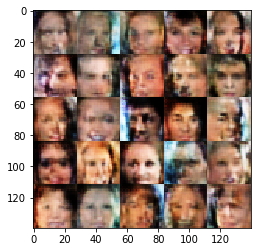

Epoch#1 progress:23.0%  dLoss:0.3958  gLoss:4.7347 
Epoch#1 progress:23.1%  dLoss:0.7960  gLoss:4.9034 
Epoch#1 progress:23.1%  dLoss:0.4925  gLoss:4.3336 
Epoch#1 progress:23.2%  dLoss:0.4857  gLoss:2.6667 
Epoch#1 progress:23.3%  dLoss:0.4881  gLoss:3.1711 
Epoch#1 progress:23.4%  dLoss:5.3061  gLoss:0.0583 
Epoch#1 progress:23.5%  dLoss:1.0998  gLoss:4.7171 
Epoch#1 progress:23.5%  dLoss:0.8728  gLoss:1.1371 
Epoch#1 progress:23.6%  dLoss:1.1512  gLoss:3.2875 
Epoch#1 progress:23.7%  dLoss:0.4537  gLoss:4.9573 


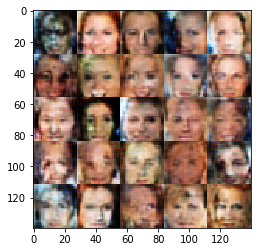

Epoch#1 progress:23.8%  dLoss:0.5515  gLoss:3.6178 
Epoch#1 progress:23.9%  dLoss:0.4661  gLoss:3.8241 
Epoch#1 progress:23.9%  dLoss:3.3817  gLoss:0.1877 
Epoch#1 progress:24.0%  dLoss:0.8491  gLoss:1.4383 
Epoch#1 progress:24.1%  dLoss:0.6276  gLoss:1.6817 
Epoch#1 progress:24.2%  dLoss:0.6456  gLoss:4.5698 
Epoch#1 progress:24.2%  dLoss:1.0401  gLoss:3.4698 
Epoch#1 progress:24.3%  dLoss:0.9586  gLoss:1.1579 
Epoch#1 progress:24.4%  dLoss:0.5353  gLoss:3.2680 
Epoch#1 progress:24.5%  dLoss:0.5124  gLoss:5.2714 


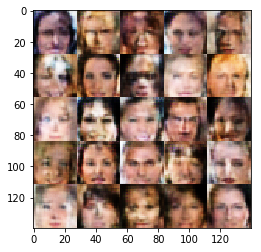

Epoch#1 progress:24.6%  dLoss:2.6760  gLoss:3.7263 
Epoch#1 progress:24.6%  dLoss:0.5638  gLoss:3.2255 
Epoch#1 progress:24.7%  dLoss:0.8693  gLoss:1.0859 
Epoch#1 progress:24.8%  dLoss:0.5566  gLoss:2.0842 
Epoch#1 progress:24.9%  dLoss:0.9154  gLoss:1.3602 
Epoch#1 progress:25.0%  dLoss:0.7141  gLoss:2.0784 
Epoch#1 progress:25.0%  dLoss:0.6096  gLoss:3.0581 
Epoch#1 progress:25.1%  dLoss:0.4454  gLoss:4.7061 
Epoch#1 progress:25.2%  dLoss:2.7195  gLoss:0.1828 
Epoch#1 progress:25.3%  dLoss:0.4917  gLoss:3.0885 


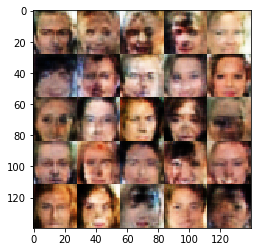

Epoch#1 progress:25.4%  dLoss:0.5449  gLoss:2.6311 
Epoch#1 progress:25.4%  dLoss:0.5636  gLoss:2.5186 
Epoch#1 progress:25.5%  dLoss:0.7815  gLoss:4.1076 
Epoch#1 progress:25.6%  dLoss:0.4479  gLoss:4.3709 
Epoch#1 progress:25.7%  dLoss:0.4215  gLoss:4.5169 
Epoch#1 progress:25.7%  dLoss:0.4459  gLoss:3.6149 
Epoch#1 progress:25.8%  dLoss:0.5382  gLoss:3.6019 
Epoch#1 progress:25.9%  dLoss:0.7969  gLoss:1.1900 
Epoch#1 progress:26.0%  dLoss:0.4787  gLoss:3.8560 
Epoch#1 progress:26.1%  dLoss:0.7914  gLoss:1.2370 


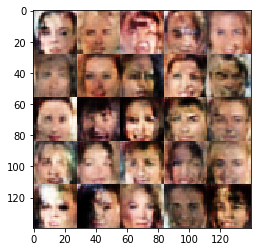

Epoch#1 progress:26.1%  dLoss:0.8347  gLoss:4.2376 
Epoch#1 progress:26.2%  dLoss:0.6358  gLoss:1.5565 
Epoch#1 progress:26.3%  dLoss:0.5863  gLoss:2.2585 
Epoch#1 progress:26.4%  dLoss:0.5447  gLoss:2.8592 
Epoch#1 progress:26.5%  dLoss:0.4724  gLoss:3.6363 
Epoch#1 progress:26.5%  dLoss:0.5064  gLoss:3.3550 
Epoch#1 progress:26.6%  dLoss:0.5792  gLoss:4.2466 
Epoch#1 progress:26.7%  dLoss:0.6646  gLoss:3.8464 
Epoch#1 progress:26.8%  dLoss:0.5719  gLoss:2.2413 
Epoch#1 progress:26.9%  dLoss:0.4668  gLoss:2.7366 


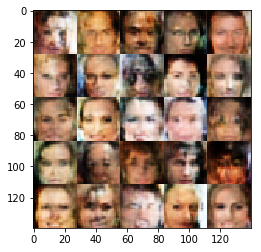

Epoch#1 progress:26.9%  dLoss:0.6269  gLoss:1.5977 
Epoch#1 progress:27.0%  dLoss:0.4292  gLoss:3.5684 
Epoch#1 progress:27.1%  dLoss:0.6405  gLoss:2.2471 
Epoch#1 progress:27.2%  dLoss:1.3168  gLoss:3.8174 
Epoch#1 progress:27.2%  dLoss:0.7669  gLoss:1.5046 
Epoch#1 progress:27.3%  dLoss:0.4990  gLoss:3.6126 
Epoch#1 progress:27.4%  dLoss:2.1949  gLoss:3.9394 
Epoch#1 progress:27.5%  dLoss:0.5590  gLoss:1.9387 
Epoch#1 progress:27.6%  dLoss:0.4959  gLoss:3.5473 
Epoch#1 progress:27.6%  dLoss:0.4438  gLoss:2.4998 


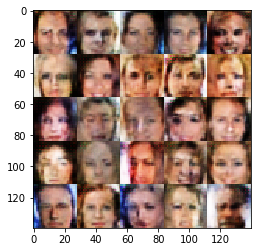

Epoch#1 progress:27.7%  dLoss:0.7137  gLoss:3.1138 
Epoch#1 progress:27.8%  dLoss:0.5192  gLoss:3.5963 
Epoch#1 progress:27.9%  dLoss:0.5905  gLoss:2.0577 
Epoch#1 progress:28.0%  dLoss:0.4869  gLoss:2.2174 
Epoch#1 progress:28.0%  dLoss:0.4788  gLoss:3.0303 
Epoch#1 progress:28.1%  dLoss:1.1873  gLoss:2.0021 
Epoch#1 progress:28.2%  dLoss:0.6923  gLoss:1.6291 
Epoch#1 progress:28.3%  dLoss:0.5905  gLoss:2.0316 
Epoch#1 progress:28.4%  dLoss:0.5854  gLoss:2.0753 
Epoch#1 progress:28.4%  dLoss:0.5238  gLoss:2.1975 


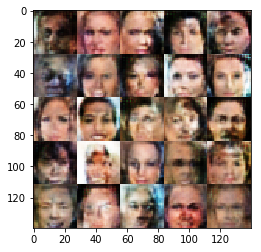

Epoch#1 progress:28.5%  dLoss:0.9437  gLoss:1.1108 
Epoch#1 progress:28.6%  dLoss:0.6089  gLoss:2.1071 
Epoch#1 progress:28.7%  dLoss:1.2331  gLoss:3.2068 
Epoch#1 progress:28.7%  dLoss:0.8170  gLoss:1.3980 
Epoch#1 progress:28.8%  dLoss:0.4848  gLoss:2.4336 
Epoch#1 progress:28.9%  dLoss:0.4519  gLoss:2.7320 
Epoch#1 progress:29.0%  dLoss:0.5711  gLoss:2.3246 
Epoch#1 progress:29.1%  dLoss:1.1563  gLoss:0.8396 
Epoch#1 progress:29.1%  dLoss:0.5240  gLoss:3.3230 
Epoch#1 progress:29.2%  dLoss:0.5509  gLoss:2.2638 


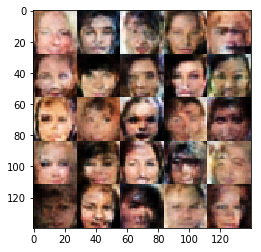

Epoch#1 progress:29.3%  dLoss:1.3523  gLoss:0.5979 
Epoch#1 progress:29.4%  dLoss:0.6804  gLoss:1.9871 
Epoch#1 progress:29.5%  dLoss:0.5873  gLoss:3.0514 
Epoch#1 progress:29.5%  dLoss:0.8218  gLoss:1.2234 
Epoch#1 progress:29.6%  dLoss:0.5571  gLoss:2.6542 
Epoch#1 progress:29.7%  dLoss:1.3348  gLoss:0.7287 
Epoch#1 progress:29.8%  dLoss:0.4483  gLoss:3.1675 
Epoch#1 progress:29.9%  dLoss:0.7759  gLoss:1.8302 
Epoch#1 progress:29.9%  dLoss:0.4965  gLoss:3.3184 
Epoch#1 progress:30.0%  dLoss:0.6766  gLoss:1.7532 


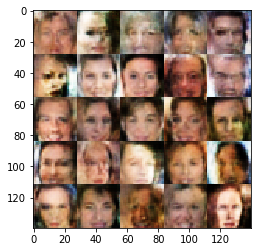

Epoch#1 progress:30.1%  dLoss:0.6797  gLoss:1.6710 
Epoch#1 progress:30.2%  dLoss:0.4838  gLoss:2.7952 
Epoch#1 progress:30.2%  dLoss:0.7968  gLoss:1.3432 
Epoch#1 progress:30.3%  dLoss:2.9361  gLoss:3.2931 
Epoch#1 progress:30.4%  dLoss:0.5953  gLoss:2.8768 
Epoch#1 progress:30.5%  dLoss:0.5949  gLoss:2.5730 
Epoch#1 progress:30.6%  dLoss:0.6573  gLoss:1.8166 
Epoch#1 progress:30.6%  dLoss:0.7157  gLoss:4.3587 
Epoch#1 progress:30.7%  dLoss:0.6296  gLoss:1.9019 
Epoch#1 progress:30.8%  dLoss:0.4898  gLoss:4.0229 


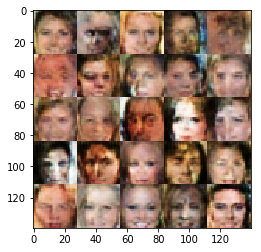

Epoch#1 progress:30.9%  dLoss:0.4914  gLoss:3.4232 
Epoch#1 progress:31.0%  dLoss:0.5537  gLoss:1.8726 
Epoch#1 progress:31.0%  dLoss:0.5101  gLoss:1.7852 
Epoch#1 progress:31.1%  dLoss:0.4731  gLoss:2.0016 
Epoch#1 progress:31.2%  dLoss:0.6572  gLoss:2.3996 
Epoch#1 progress:31.3%  dLoss:0.6712  gLoss:1.7279 
Epoch#1 progress:31.4%  dLoss:0.8196  gLoss:1.3969 
Epoch#1 progress:31.4%  dLoss:0.5392  gLoss:2.7070 
Epoch#1 progress:31.5%  dLoss:0.6157  gLoss:3.0014 
Epoch#1 progress:31.6%  dLoss:0.7130  gLoss:1.2331 


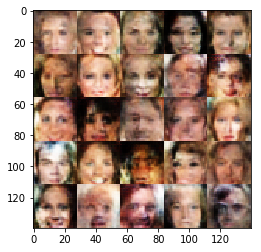

Epoch#1 progress:31.7%  dLoss:0.4728  gLoss:2.4085 
Epoch#1 progress:31.7%  dLoss:0.6120  gLoss:3.0949 
Epoch#1 progress:31.8%  dLoss:0.5535  gLoss:2.6709 
Epoch#1 progress:31.9%  dLoss:0.7946  gLoss:3.9423 
Epoch#1 progress:32.0%  dLoss:0.5373  gLoss:2.9256 
Epoch#1 progress:32.1%  dLoss:0.5705  gLoss:3.1799 
Epoch#1 progress:32.1%  dLoss:0.7086  gLoss:1.9511 
Epoch#1 progress:32.2%  dLoss:0.5906  gLoss:1.8748 
Epoch#1 progress:32.3%  dLoss:0.4428  gLoss:3.2047 
Epoch#1 progress:32.4%  dLoss:0.4175  gLoss:2.8928 


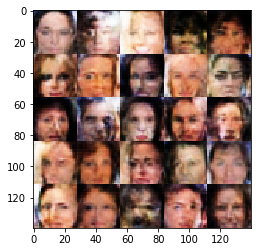

Epoch#1 progress:32.5%  dLoss:0.8370  gLoss:1.2569 
Epoch#1 progress:32.5%  dLoss:0.5335  gLoss:1.9871 
Epoch#1 progress:32.6%  dLoss:0.7812  gLoss:1.4123 
Epoch#1 progress:32.7%  dLoss:0.5362  gLoss:2.0755 
Epoch#1 progress:32.8%  dLoss:1.5210  gLoss:0.5244 
Epoch#1 progress:32.9%  dLoss:0.9927  gLoss:0.9909 
Epoch#1 progress:32.9%  dLoss:0.7940  gLoss:2.7885 
Epoch#1 progress:33.0%  dLoss:0.5197  gLoss:2.2545 
Epoch#1 progress:33.1%  dLoss:0.8541  gLoss:1.1765 
Epoch#1 progress:33.2%  dLoss:0.8381  gLoss:2.9354 


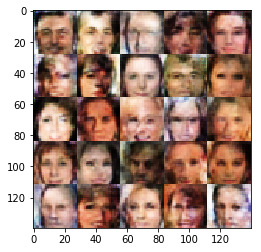

Epoch#1 progress:33.2%  dLoss:0.6884  gLoss:1.8831 
Epoch#1 progress:33.3%  dLoss:0.7334  gLoss:1.3661 
Epoch#1 progress:33.4%  dLoss:0.6195  gLoss:3.2480 
Epoch#1 progress:33.5%  dLoss:1.0312  gLoss:3.4369 
Epoch#1 progress:33.6%  dLoss:0.8283  gLoss:0.9351 
Epoch#1 progress:33.6%  dLoss:0.4993  gLoss:3.2516 
Epoch#1 progress:33.7%  dLoss:1.0622  gLoss:0.8798 
Epoch#1 progress:33.8%  dLoss:0.6505  gLoss:1.6571 
Epoch#1 progress:33.9%  dLoss:0.5079  gLoss:1.8923 
Epoch#1 progress:34.0%  dLoss:0.5431  gLoss:2.9909 


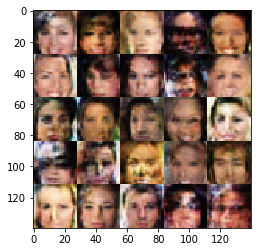

Epoch#1 progress:34.0%  dLoss:0.5138  gLoss:2.3894 
Epoch#1 progress:34.1%  dLoss:1.0900  gLoss:0.8656 
Epoch#1 progress:34.2%  dLoss:0.4340  gLoss:4.4695 
Epoch#1 progress:34.3%  dLoss:0.6941  gLoss:1.6979 
Epoch#1 progress:34.4%  dLoss:0.6171  gLoss:2.3357 
Epoch#1 progress:34.4%  dLoss:0.8068  gLoss:4.3619 
Epoch#1 progress:34.5%  dLoss:0.5524  gLoss:2.0820 
Epoch#1 progress:34.6%  dLoss:0.4708  gLoss:3.7835 
Epoch#1 progress:34.7%  dLoss:0.7305  gLoss:1.5382 
Epoch#1 progress:34.7%  dLoss:0.5950  gLoss:2.6573 


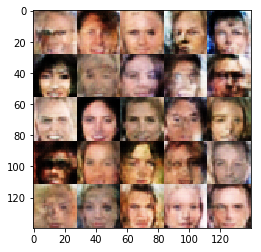

Epoch#1 progress:34.8%  dLoss:0.5243  gLoss:4.7115 
Epoch#1 progress:34.9%  dLoss:0.7731  gLoss:1.5415 
Epoch#1 progress:35.0%  dLoss:0.6820  gLoss:3.6826 
Epoch#1 progress:35.1%  dLoss:0.4407  gLoss:3.2698 
Epoch#1 progress:35.1%  dLoss:0.6124  gLoss:3.2052 
Epoch#1 progress:35.2%  dLoss:0.9428  gLoss:1.7844 
Epoch#1 progress:35.3%  dLoss:0.4925  gLoss:2.4707 
Epoch#1 progress:35.4%  dLoss:0.4703  gLoss:3.1503 
Epoch#1 progress:35.5%  dLoss:1.2928  gLoss:3.7740 
Epoch#1 progress:35.5%  dLoss:0.5797  gLoss:2.1799 


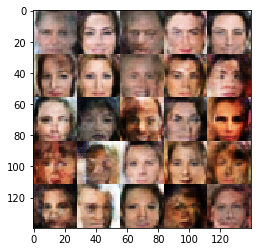

Epoch#1 progress:35.6%  dLoss:0.6750  gLoss:2.1597 
Epoch#1 progress:35.7%  dLoss:0.5559  gLoss:3.3542 
Epoch#1 progress:35.8%  dLoss:0.5611  gLoss:2.5606 
Epoch#1 progress:35.9%  dLoss:0.7811  gLoss:1.7993 
Epoch#1 progress:35.9%  dLoss:0.5055  gLoss:3.1155 
Epoch#1 progress:36.0%  dLoss:0.4624  gLoss:3.1737 
Epoch#1 progress:36.1%  dLoss:0.4553  gLoss:3.0271 
Epoch#1 progress:36.2%  dLoss:0.4857  gLoss:2.5387 
Epoch#1 progress:36.3%  dLoss:0.5414  gLoss:2.9299 
Epoch#1 progress:36.3%  dLoss:2.3059  gLoss:0.2647 


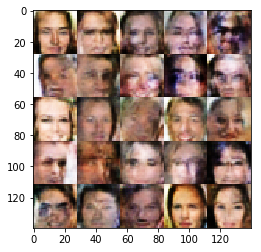

Epoch#1 progress:36.4%  dLoss:0.5570  gLoss:2.2683 
Epoch#1 progress:36.5%  dLoss:0.4190  gLoss:2.7654 
Epoch#1 progress:36.6%  dLoss:0.7390  gLoss:1.7014 
Epoch#1 progress:36.6%  dLoss:0.5124  gLoss:2.4763 
Epoch#1 progress:36.7%  dLoss:0.7150  gLoss:1.3819 
Epoch#1 progress:36.8%  dLoss:0.6687  gLoss:1.8499 
Epoch#1 progress:36.9%  dLoss:0.6166  gLoss:1.4186 
Epoch#1 progress:37.0%  dLoss:0.4722  gLoss:3.7976 
Epoch#1 progress:37.0%  dLoss:0.4516  gLoss:2.6943 
Epoch#1 progress:37.1%  dLoss:0.5843  gLoss:3.1044 


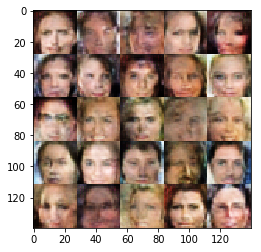

Epoch#1 progress:37.2%  dLoss:0.6114  gLoss:1.7725 
Epoch#1 progress:37.3%  dLoss:0.5881  gLoss:2.0752 
Epoch#1 progress:37.4%  dLoss:0.5073  gLoss:3.0500 
Epoch#1 progress:37.4%  dLoss:0.5204  gLoss:4.2213 
Epoch#1 progress:37.5%  dLoss:0.5752  gLoss:3.3814 
Epoch#1 progress:37.6%  dLoss:0.5398  gLoss:3.3137 
Epoch#1 progress:37.7%  dLoss:0.4366  gLoss:3.2976 
Epoch#1 progress:37.8%  dLoss:0.8131  gLoss:1.0288 
Epoch#1 progress:37.8%  dLoss:0.6048  gLoss:1.9847 
Epoch#1 progress:37.9%  dLoss:0.7114  gLoss:1.6527 


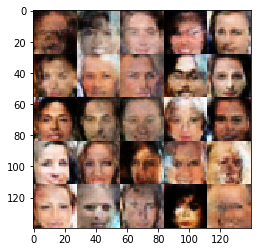

Epoch#1 progress:38.0%  dLoss:0.4818  gLoss:4.4622 
Epoch#1 progress:38.1%  dLoss:1.5421  gLoss:0.3542 
Epoch#1 progress:38.1%  dLoss:0.6725  gLoss:1.8378 
Epoch#1 progress:38.2%  dLoss:0.6301  gLoss:2.6167 
Epoch#1 progress:38.3%  dLoss:0.4827  gLoss:3.6005 
Epoch#1 progress:38.4%  dLoss:0.5215  gLoss:2.8961 
Epoch#1 progress:38.5%  dLoss:0.7026  gLoss:1.3480 
Epoch#1 progress:38.5%  dLoss:0.5428  gLoss:3.7663 
Epoch#1 progress:38.6%  dLoss:0.5067  gLoss:3.8496 
Epoch#1 progress:38.7%  dLoss:0.5291  gLoss:3.0285 


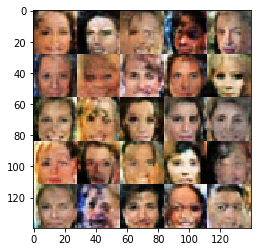

Epoch#1 progress:38.8%  dLoss:0.6648  gLoss:1.5369 
Epoch#1 progress:38.9%  dLoss:1.5875  gLoss:0.5216 
Epoch#1 progress:38.9%  dLoss:0.4595  gLoss:3.1109 
Epoch#1 progress:39.0%  dLoss:0.4864  gLoss:2.4768 
Epoch#1 progress:39.1%  dLoss:0.5166  gLoss:2.4361 
Epoch#1 progress:39.2%  dLoss:1.0801  gLoss:0.8188 
Epoch#1 progress:39.3%  dLoss:0.8293  gLoss:2.7543 
Epoch#1 progress:39.3%  dLoss:0.5843  gLoss:3.7866 
Epoch#1 progress:39.4%  dLoss:0.4990  gLoss:4.0734 
Epoch#1 progress:39.5%  dLoss:0.7597  gLoss:1.6861 


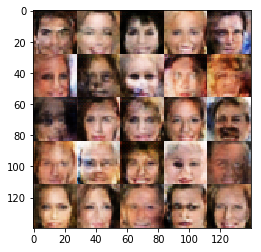

Epoch#1 progress:39.6%  dLoss:0.7407  gLoss:1.5341 
Epoch#1 progress:39.6%  dLoss:0.6923  gLoss:2.4768 
Epoch#1 progress:39.7%  dLoss:0.5621  gLoss:2.1516 
Epoch#1 progress:39.8%  dLoss:0.7092  gLoss:1.8547 
Epoch#1 progress:39.9%  dLoss:0.5391  gLoss:3.8362 
Epoch#1 progress:40.0%  dLoss:0.6699  gLoss:2.9197 
Epoch#1 progress:40.0%  dLoss:0.4490  gLoss:3.2375 
Epoch#1 progress:40.1%  dLoss:0.7695  gLoss:1.9856 
Epoch#1 progress:40.2%  dLoss:0.4905  gLoss:2.5421 
Epoch#1 progress:40.3%  dLoss:0.5310  gLoss:2.8226 


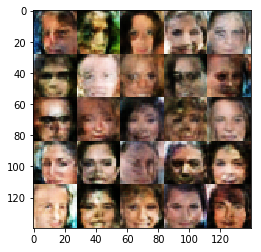

Epoch#1 progress:40.4%  dLoss:0.6057  gLoss:2.2684 
Epoch#1 progress:40.4%  dLoss:0.5343  gLoss:3.1283 
Epoch#1 progress:40.5%  dLoss:0.8635  gLoss:1.2809 
Epoch#1 progress:40.6%  dLoss:0.4516  gLoss:3.6758 
Epoch#1 progress:40.7%  dLoss:0.5247  gLoss:2.2460 
Epoch#1 progress:40.8%  dLoss:0.4338  gLoss:2.6863 
Epoch#1 progress:40.8%  dLoss:0.5791  gLoss:2.3675 
Epoch#1 progress:40.9%  dLoss:0.5980  gLoss:2.3932 
Epoch#1 progress:41.0%  dLoss:0.5017  gLoss:2.4499 
Epoch#1 progress:41.1%  dLoss:0.5613  gLoss:2.3804 


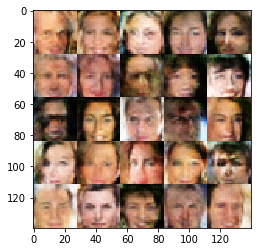

Epoch#1 progress:41.1%  dLoss:0.4834  gLoss:2.9110 
Epoch#1 progress:41.2%  dLoss:0.6085  gLoss:2.0795 
Epoch#1 progress:41.3%  dLoss:0.5980  gLoss:1.7257 
Epoch#1 progress:41.4%  dLoss:0.7024  gLoss:1.6537 
Epoch#1 progress:41.5%  dLoss:0.7022  gLoss:2.2902 
Epoch#1 progress:41.5%  dLoss:0.6835  gLoss:1.4997 
Epoch#1 progress:41.6%  dLoss:0.7145  gLoss:4.7182 
Epoch#1 progress:41.7%  dLoss:0.6079  gLoss:2.4799 
Epoch#1 progress:41.8%  dLoss:0.7973  gLoss:1.5585 
Epoch#1 progress:41.9%  dLoss:0.4700  gLoss:2.6691 


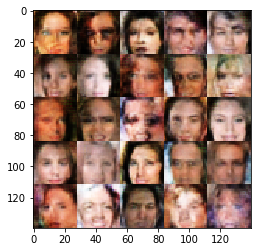

Epoch#1 progress:41.9%  dLoss:0.6656  gLoss:1.5273 
Epoch#1 progress:42.0%  dLoss:0.6445  gLoss:1.8472 
Epoch#1 progress:42.1%  dLoss:0.5750  gLoss:3.4148 
Epoch#1 progress:42.2%  dLoss:2.4538  gLoss:4.2505 
Epoch#1 progress:42.3%  dLoss:0.6207  gLoss:2.1356 
Epoch#1 progress:42.3%  dLoss:0.5434  gLoss:3.7190 
Epoch#1 progress:42.4%  dLoss:0.6445  gLoss:1.6806 
Epoch#1 progress:42.5%  dLoss:0.8511  gLoss:3.5083 
Epoch#1 progress:42.6%  dLoss:0.5911  gLoss:2.4349 
Epoch#1 progress:42.6%  dLoss:0.5190  gLoss:3.1715 


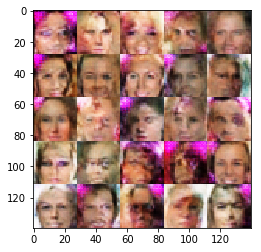

Epoch#1 progress:42.7%  dLoss:0.4200  gLoss:3.8855 
Epoch#1 progress:42.8%  dLoss:0.6675  gLoss:1.5090 
Epoch#1 progress:42.9%  dLoss:0.5412  gLoss:2.9891 
Epoch#1 progress:43.0%  dLoss:0.4885  gLoss:4.6191 
Epoch#1 progress:43.0%  dLoss:0.4516  gLoss:3.5201 
Epoch#1 progress:43.1%  dLoss:0.6639  gLoss:2.0812 
Epoch#1 progress:43.2%  dLoss:0.4713  gLoss:2.3741 
Epoch#1 progress:43.3%  dLoss:1.1731  gLoss:3.2182 
Epoch#1 progress:43.4%  dLoss:0.8875  gLoss:2.2819 
Epoch#1 progress:43.4%  dLoss:0.4727  gLoss:2.9516 


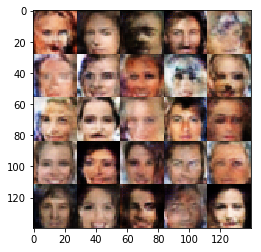

Epoch#1 progress:43.5%  dLoss:1.0497  gLoss:0.8459 
Epoch#1 progress:43.6%  dLoss:0.5113  gLoss:3.1030 
Epoch#1 progress:43.7%  dLoss:0.4022  gLoss:3.8516 
Epoch#1 progress:43.8%  dLoss:0.7586  gLoss:1.5707 
Epoch#1 progress:43.8%  dLoss:0.6943  gLoss:1.8122 
Epoch#1 progress:43.9%  dLoss:0.5760  gLoss:2.0653 
Epoch#1 progress:44.0%  dLoss:1.5935  gLoss:0.4406 
Epoch#1 progress:44.1%  dLoss:0.5585  gLoss:2.5596 
Epoch#1 progress:44.1%  dLoss:0.5621  gLoss:2.7104 
Epoch#1 progress:44.2%  dLoss:0.6115  gLoss:3.1195 


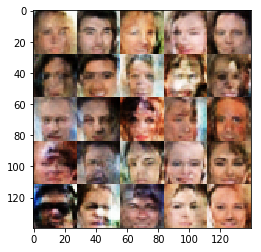

Epoch#1 progress:44.3%  dLoss:0.9846  gLoss:1.0185 
Epoch#1 progress:44.4%  dLoss:0.5095  gLoss:2.4403 
Epoch#1 progress:44.5%  dLoss:0.4660  gLoss:2.6956 
Epoch#1 progress:44.5%  dLoss:0.5076  gLoss:2.8870 
Epoch#1 progress:44.6%  dLoss:0.5136  gLoss:3.1920 
Epoch#1 progress:44.7%  dLoss:0.4725  gLoss:2.7943 
Epoch#1 progress:44.8%  dLoss:0.5422  gLoss:2.6671 
Epoch#1 progress:44.9%  dLoss:0.9758  gLoss:1.0646 
Epoch#1 progress:44.9%  dLoss:0.9564  gLoss:1.0805 
Epoch#1 progress:45.0%  dLoss:0.5359  gLoss:2.8133 


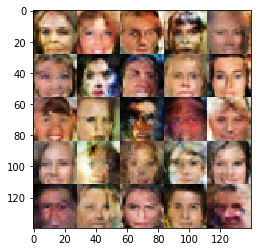

Epoch#1 progress:45.1%  dLoss:0.5331  gLoss:3.7285 
Epoch#1 progress:45.2%  dLoss:0.6811  gLoss:1.7811 
Epoch#1 progress:45.3%  dLoss:0.5374  gLoss:3.4788 
Epoch#1 progress:45.3%  dLoss:0.6490  gLoss:2.5315 
Epoch#1 progress:45.4%  dLoss:0.5072  gLoss:2.8861 
Epoch#1 progress:45.5%  dLoss:1.5948  gLoss:2.8879 
Epoch#1 progress:45.6%  dLoss:0.5441  gLoss:2.6888 
Epoch#1 progress:45.6%  dLoss:0.3726  gLoss:3.0149 
Epoch#1 progress:45.7%  dLoss:0.6075  gLoss:2.5674 
Epoch#1 progress:45.8%  dLoss:0.6298  gLoss:2.3560 


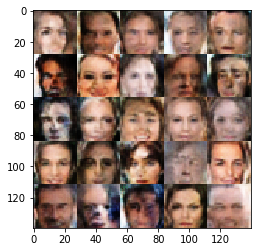

Epoch#1 progress:45.9%  dLoss:0.7340  gLoss:1.9436 
Epoch#1 progress:46.0%  dLoss:0.6919  gLoss:1.9749 
Epoch#1 progress:46.0%  dLoss:0.8277  gLoss:1.1703 
Epoch#1 progress:46.1%  dLoss:0.5760  gLoss:3.2737 
Epoch#1 progress:46.2%  dLoss:0.7002  gLoss:2.5092 
Epoch#1 progress:46.3%  dLoss:0.6250  gLoss:1.9697 
Epoch#1 progress:46.4%  dLoss:1.1448  gLoss:0.8964 
Epoch#1 progress:46.4%  dLoss:0.5436  gLoss:2.7456 
Epoch#1 progress:46.5%  dLoss:0.4777  gLoss:2.4845 
Epoch#1 progress:46.6%  dLoss:0.8082  gLoss:1.4311 


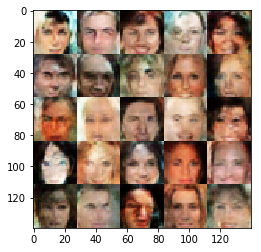

Epoch#1 progress:46.7%  dLoss:0.6848  gLoss:2.5731 
Epoch#1 progress:46.8%  dLoss:0.5796  gLoss:2.8959 
Epoch#1 progress:46.8%  dLoss:0.9599  gLoss:3.7369 
Epoch#1 progress:46.9%  dLoss:0.6630  gLoss:1.6085 
Epoch#1 progress:47.0%  dLoss:0.5792  gLoss:2.1938 
Epoch#1 progress:47.1%  dLoss:0.8961  gLoss:1.1779 
Epoch#1 progress:47.1%  dLoss:0.5445  gLoss:2.0198 
Epoch#1 progress:47.2%  dLoss:0.5432  gLoss:2.9712 
Epoch#1 progress:47.3%  dLoss:0.5816  gLoss:2.5504 
Epoch#1 progress:47.4%  dLoss:0.6806  gLoss:4.5387 


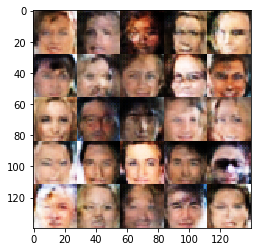

Epoch#1 progress:47.5%  dLoss:0.5618  gLoss:1.7747 
Epoch#1 progress:47.5%  dLoss:0.6936  gLoss:2.2571 
Epoch#1 progress:47.6%  dLoss:0.5543  gLoss:2.5044 
Epoch#1 progress:47.7%  dLoss:0.6437  gLoss:1.7078 
Epoch#1 progress:47.8%  dLoss:0.6271  gLoss:1.7392 
Epoch#1 progress:47.9%  dLoss:0.4011  gLoss:2.5909 
Epoch#1 progress:47.9%  dLoss:0.7600  gLoss:1.6374 
Epoch#1 progress:48.0%  dLoss:0.4927  gLoss:3.0162 
Epoch#1 progress:48.1%  dLoss:0.5318  gLoss:2.2600 
Epoch#1 progress:48.2%  dLoss:0.6326  gLoss:2.3429 


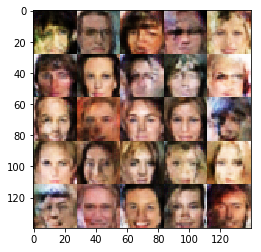

Epoch#1 progress:48.3%  dLoss:2.0821  gLoss:0.3672 
Epoch#1 progress:48.3%  dLoss:0.5688  gLoss:2.5719 
Epoch#1 progress:48.4%  dLoss:0.4463  gLoss:2.9254 
Epoch#1 progress:48.5%  dLoss:0.5943  gLoss:1.8930 
Epoch#1 progress:48.6%  dLoss:0.5347  gLoss:2.6817 
Epoch#1 progress:48.6%  dLoss:0.5969  gLoss:2.8830 
Epoch#1 progress:48.7%  dLoss:0.6867  gLoss:2.5303 
Epoch#1 progress:48.8%  dLoss:0.6449  gLoss:2.5159 
Epoch#1 progress:48.9%  dLoss:0.4834  gLoss:2.1968 
Epoch#1 progress:49.0%  dLoss:0.7475  gLoss:3.1563 


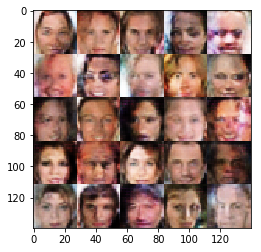

Epoch#1 progress:49.0%  dLoss:1.0803  gLoss:0.9167 
Epoch#1 progress:49.1%  dLoss:0.8632  gLoss:1.1200 
Epoch#1 progress:49.2%  dLoss:0.8305  gLoss:1.2266 
Epoch#1 progress:49.3%  dLoss:0.5991  gLoss:2.7394 
Epoch#1 progress:49.4%  dLoss:0.6424  gLoss:3.5175 
Epoch#1 progress:49.4%  dLoss:0.5049  gLoss:2.8797 
Epoch#1 progress:49.5%  dLoss:1.1186  gLoss:2.7912 
Epoch#1 progress:49.6%  dLoss:0.5697  gLoss:1.8967 
Epoch#1 progress:49.7%  dLoss:0.6424  gLoss:1.3812 
Epoch#1 progress:49.8%  dLoss:0.8102  gLoss:1.3746 


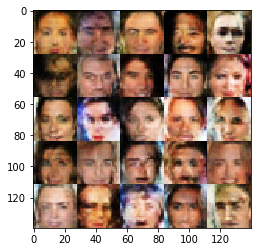

Epoch#1 progress:49.8%  dLoss:0.6115  gLoss:2.6641 
Epoch#1 progress:49.9%  dLoss:0.4920  gLoss:3.4625 
Epoch#1 progress:50.0%  dLoss:0.8732  gLoss:1.2265 
Epoch#1 progress:50.1%  dLoss:0.6461  gLoss:3.2573 
Epoch#1 progress:50.2%  dLoss:0.4946  gLoss:4.0955 
Epoch#1 progress:50.2%  dLoss:0.6316  gLoss:2.0128 
Epoch#1 progress:50.3%  dLoss:0.5404  gLoss:2.0180 
Epoch#1 progress:50.4%  dLoss:0.9529  gLoss:1.8111 
Epoch#1 progress:50.5%  dLoss:0.6705  gLoss:2.8939 
Epoch#1 progress:50.5%  dLoss:0.6886  gLoss:2.9783 


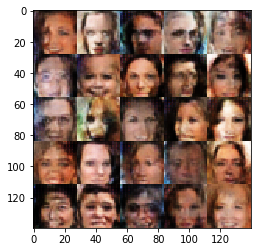

Epoch#1 progress:50.6%  dLoss:0.5783  gLoss:2.8767 
Epoch#1 progress:50.7%  dLoss:0.7604  gLoss:1.4343 
Epoch#1 progress:50.8%  dLoss:0.9270  gLoss:1.2345 
Epoch#1 progress:50.9%  dLoss:0.5620  gLoss:2.1862 
Epoch#1 progress:50.9%  dLoss:0.6829  gLoss:3.8573 
Epoch#1 progress:51.0%  dLoss:0.8232  gLoss:1.6840 
Epoch#1 progress:51.1%  dLoss:0.7606  gLoss:1.5681 
Epoch#1 progress:51.2%  dLoss:0.6341  gLoss:1.7465 
Epoch#1 progress:51.3%  dLoss:0.6614  gLoss:1.9396 
Epoch#1 progress:51.3%  dLoss:0.5930  gLoss:3.2865 


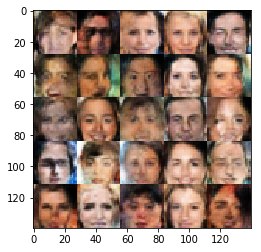

Epoch#1 progress:51.4%  dLoss:0.5721  gLoss:1.5005 
Epoch#1 progress:51.5%  dLoss:0.5039  gLoss:2.4797 
Epoch#1 progress:51.6%  dLoss:0.6910  gLoss:1.4768 
Epoch#1 progress:51.7%  dLoss:0.4666  gLoss:4.3281 
Epoch#1 progress:51.7%  dLoss:0.5577  gLoss:3.2772 
Epoch#1 progress:51.8%  dLoss:0.4503  gLoss:2.6384 
Epoch#1 progress:51.9%  dLoss:0.6463  gLoss:1.7196 
Epoch#1 progress:52.0%  dLoss:0.8574  gLoss:1.2119 
Epoch#1 progress:52.0%  dLoss:0.7067  gLoss:2.5916 
Epoch#1 progress:52.1%  dLoss:0.5238  gLoss:2.7766 


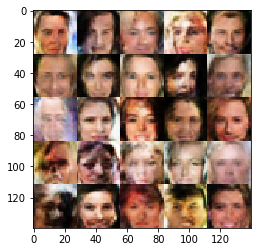

Epoch#1 progress:52.2%  dLoss:0.8883  gLoss:1.1093 
Epoch#1 progress:52.3%  dLoss:1.3691  gLoss:1.7089 
Epoch#1 progress:52.4%  dLoss:0.6904  gLoss:2.1457 
Epoch#1 progress:52.4%  dLoss:0.8430  gLoss:1.1603 
Epoch#1 progress:52.5%  dLoss:0.5382  gLoss:2.8483 
Epoch#1 progress:52.6%  dLoss:0.7173  gLoss:1.4083 
Epoch#1 progress:52.7%  dLoss:0.7377  gLoss:2.1243 
Epoch#1 progress:52.8%  dLoss:0.6736  gLoss:3.2254 
Epoch#1 progress:52.8%  dLoss:0.6483  gLoss:2.9804 
Epoch#1 progress:52.9%  dLoss:0.5190  gLoss:3.0451 


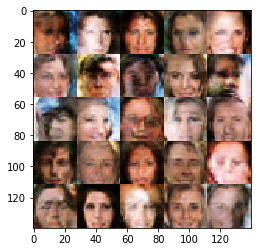

Epoch#1 progress:53.0%  dLoss:0.6043  gLoss:1.9564 
Epoch#1 progress:53.1%  dLoss:0.5236  gLoss:2.6357 
Epoch#1 progress:53.2%  dLoss:0.8069  gLoss:1.2422 
Epoch#1 progress:53.2%  dLoss:1.1780  gLoss:0.7340 
Epoch#1 progress:53.3%  dLoss:0.7061  gLoss:1.6154 
Epoch#1 progress:53.4%  dLoss:0.7949  gLoss:2.7213 
Epoch#1 progress:53.5%  dLoss:0.5756  gLoss:1.8516 
Epoch#1 progress:53.5%  dLoss:0.5794  gLoss:2.2788 
Epoch#1 progress:53.6%  dLoss:0.4978  gLoss:2.2956 
Epoch#1 progress:53.7%  dLoss:1.5288  gLoss:0.6347 


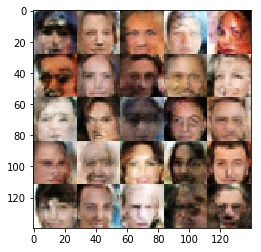

Epoch#1 progress:53.8%  dLoss:0.5597  gLoss:1.9597 
Epoch#1 progress:53.9%  dLoss:0.6667  gLoss:2.1246 
Epoch#1 progress:53.9%  dLoss:0.5085  gLoss:3.8043 
Epoch#1 progress:54.0%  dLoss:1.2760  gLoss:0.6550 
Epoch#1 progress:54.1%  dLoss:0.6297  gLoss:3.3264 
Epoch#1 progress:54.2%  dLoss:1.6260  gLoss:0.3997 
Epoch#1 progress:54.3%  dLoss:0.6933  gLoss:1.4672 
Epoch#1 progress:54.3%  dLoss:0.5267  gLoss:3.3551 
Epoch#1 progress:54.4%  dLoss:0.4798  gLoss:3.4167 
Epoch#1 progress:54.5%  dLoss:0.6978  gLoss:2.1660 


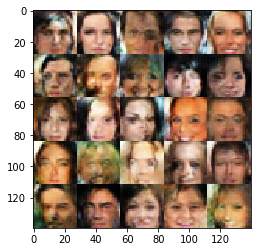

Epoch#1 progress:54.6%  dLoss:0.5203  gLoss:1.9445 
Epoch#1 progress:54.7%  dLoss:1.0058  gLoss:0.9759 
Epoch#1 progress:54.7%  dLoss:0.5449  gLoss:3.1061 
Epoch#1 progress:54.8%  dLoss:0.9590  gLoss:1.6500 
Epoch#1 progress:54.9%  dLoss:1.0108  gLoss:1.1215 
Epoch#1 progress:55.0%  dLoss:0.4305  gLoss:3.1793 
Epoch#1 progress:55.0%  dLoss:0.7774  gLoss:1.5646 
Epoch#1 progress:55.1%  dLoss:0.7175  gLoss:2.0717 
Epoch#1 progress:55.2%  dLoss:0.7584  gLoss:1.3616 
Epoch#1 progress:55.3%  dLoss:0.5842  gLoss:3.0340 


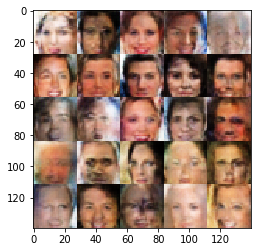

Epoch#1 progress:55.4%  dLoss:0.9005  gLoss:1.1677 
Epoch#1 progress:55.4%  dLoss:0.6860  gLoss:1.9009 
Epoch#1 progress:55.5%  dLoss:0.6799  gLoss:1.8368 
Epoch#1 progress:55.6%  dLoss:0.6129  gLoss:3.8540 
Epoch#1 progress:55.7%  dLoss:0.7662  gLoss:1.7087 
Epoch#1 progress:55.8%  dLoss:1.1312  gLoss:0.7121 
Epoch#1 progress:55.8%  dLoss:0.6719  gLoss:1.8506 
Epoch#1 progress:55.9%  dLoss:0.8343  gLoss:1.1831 
Epoch#1 progress:56.0%  dLoss:0.5854  gLoss:1.7962 
Epoch#1 progress:56.1%  dLoss:0.8159  gLoss:1.2660 


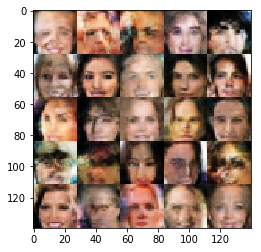

Epoch#1 progress:56.2%  dLoss:0.8125  gLoss:1.4630 
Epoch#1 progress:56.2%  dLoss:0.4772  gLoss:2.0338 
Epoch#1 progress:56.3%  dLoss:0.6810  gLoss:2.5990 
Epoch#1 progress:56.4%  dLoss:0.9174  gLoss:1.0106 
Epoch#1 progress:56.5%  dLoss:0.4566  gLoss:3.7094 
Epoch#1 progress:56.5%  dLoss:0.8569  gLoss:1.6631 
Epoch#1 progress:56.6%  dLoss:0.9779  gLoss:2.9761 
Epoch#1 progress:56.7%  dLoss:0.8674  gLoss:5.1428 
Epoch#1 progress:56.8%  dLoss:0.6731  gLoss:2.3261 
Epoch#1 progress:56.9%  dLoss:1.1344  gLoss:0.7331 


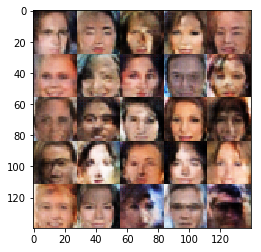

Epoch#1 progress:56.9%  dLoss:0.6550  gLoss:1.5905 
Epoch#1 progress:57.0%  dLoss:0.6633  gLoss:2.6534 
Epoch#1 progress:57.1%  dLoss:0.8316  gLoss:1.2895 
Epoch#1 progress:57.2%  dLoss:0.7907  gLoss:1.2661 
Epoch#1 progress:57.3%  dLoss:0.6826  gLoss:1.6622 
Epoch#1 progress:57.3%  dLoss:0.9660  gLoss:1.0913 
Epoch#1 progress:57.4%  dLoss:0.3766  gLoss:4.1304 
Epoch#1 progress:57.5%  dLoss:0.6951  gLoss:1.6578 
Epoch#1 progress:57.6%  dLoss:1.2623  gLoss:0.6377 
Epoch#1 progress:57.7%  dLoss:0.5608  gLoss:3.7655 


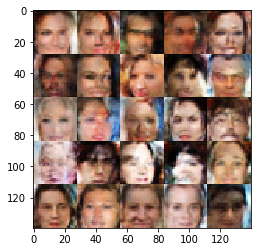

Epoch#1 progress:57.7%  dLoss:0.6024  gLoss:2.6621 
Epoch#1 progress:57.8%  dLoss:0.4553  gLoss:3.0600 
Epoch#1 progress:57.9%  dLoss:0.4602  gLoss:2.2570 
Epoch#1 progress:58.0%  dLoss:1.0547  gLoss:0.9003 
Epoch#1 progress:58.0%  dLoss:0.6203  gLoss:2.0624 
Epoch#1 progress:58.1%  dLoss:0.7724  gLoss:1.6085 
Epoch#1 progress:58.2%  dLoss:0.4870  gLoss:2.5275 
Epoch#1 progress:58.3%  dLoss:1.1583  gLoss:0.6457 
Epoch#1 progress:58.4%  dLoss:0.9634  gLoss:1.0587 
Epoch#1 progress:58.4%  dLoss:1.0116  gLoss:1.0414 


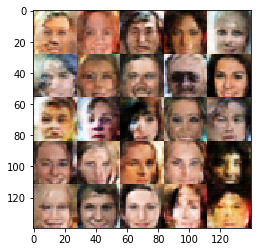

Epoch#1 progress:58.5%  dLoss:0.8490  gLoss:3.5201 
Epoch#1 progress:58.6%  dLoss:0.5380  gLoss:1.9890 
Epoch#1 progress:58.7%  dLoss:3.4489  gLoss:0.1362 
Epoch#1 progress:58.8%  dLoss:1.6556  gLoss:0.4369 
Epoch#1 progress:58.8%  dLoss:0.8494  gLoss:1.2199 
Epoch#1 progress:58.9%  dLoss:0.5921  gLoss:1.8478 
Epoch#1 progress:59.0%  dLoss:0.6003  gLoss:2.2187 
Epoch#1 progress:59.1%  dLoss:0.6393  gLoss:1.8338 
Epoch#1 progress:59.2%  dLoss:0.7706  gLoss:1.4376 
Epoch#1 progress:59.2%  dLoss:0.6301  gLoss:2.0966 


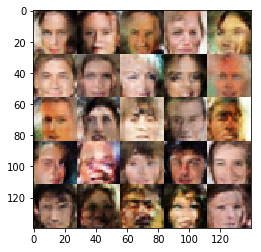

Epoch#1 progress:59.3%  dLoss:1.2571  gLoss:0.7297 
Epoch#1 progress:59.4%  dLoss:0.4537  gLoss:4.3489 
Epoch#1 progress:59.5%  dLoss:0.5913  gLoss:2.0783 
Epoch#1 progress:59.5%  dLoss:0.6994  gLoss:1.6731 
Epoch#1 progress:59.6%  dLoss:0.4906  gLoss:3.1422 
Epoch#1 progress:59.7%  dLoss:0.7638  gLoss:1.9192 
Epoch#1 progress:59.8%  dLoss:0.7217  gLoss:1.5073 
Epoch#1 progress:59.9%  dLoss:0.4905  gLoss:3.9673 
Epoch#1 progress:59.9%  dLoss:1.7040  gLoss:1.5278 
Epoch#1 progress:60.0%  dLoss:0.7991  gLoss:1.3062 


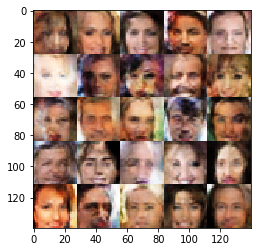

Epoch#1 progress:60.1%  dLoss:0.6652  gLoss:1.6368 
Epoch#1 progress:60.2%  dLoss:0.5705  gLoss:2.0370 
Epoch#1 progress:60.3%  dLoss:0.5640  gLoss:1.8567 
Epoch#1 progress:60.3%  dLoss:0.7304  gLoss:2.1116 
Epoch#1 progress:60.4%  dLoss:0.5358  gLoss:3.6777 
Epoch#1 progress:60.5%  dLoss:0.5959  gLoss:2.7849 
Epoch#1 progress:60.6%  dLoss:0.6401  gLoss:3.0597 
Epoch#1 progress:60.7%  dLoss:1.4225  gLoss:0.5277 
Epoch#1 progress:60.7%  dLoss:0.7955  gLoss:1.5795 
Epoch#1 progress:60.8%  dLoss:0.6226  gLoss:1.9580 


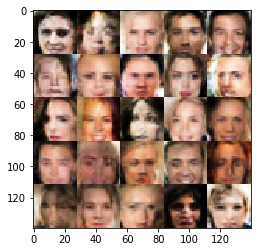

Epoch#1 progress:60.9%  dLoss:0.6007  gLoss:4.4830 
Epoch#1 progress:61.0%  dLoss:0.5536  gLoss:2.6474 
Epoch#1 progress:61.0%  dLoss:0.6214  gLoss:2.7220 
Epoch#1 progress:61.1%  dLoss:0.7643  gLoss:3.6933 
Epoch#1 progress:61.2%  dLoss:0.6662  gLoss:2.1833 
Epoch#1 progress:61.3%  dLoss:1.3532  gLoss:3.6514 
Epoch#1 progress:61.4%  dLoss:0.9126  gLoss:0.9868 
Epoch#1 progress:61.4%  dLoss:0.7260  gLoss:1.4902 
Epoch#1 progress:61.5%  dLoss:0.5034  gLoss:2.4134 
Epoch#1 progress:61.6%  dLoss:0.6823  gLoss:1.5708 


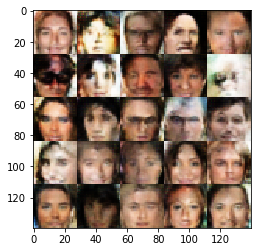

Epoch#1 progress:61.7%  dLoss:0.7401  gLoss:2.2213 
Epoch#1 progress:61.8%  dLoss:0.5705  gLoss:2.1428 
Epoch#1 progress:61.8%  dLoss:0.6115  gLoss:1.8111 
Epoch#1 progress:61.9%  dLoss:0.5089  gLoss:2.7265 
Epoch#1 progress:62.0%  dLoss:0.9814  gLoss:0.9798 
Epoch#1 progress:62.1%  dLoss:0.7976  gLoss:1.1556 
Epoch#1 progress:62.2%  dLoss:0.6633  gLoss:2.1709 
Epoch#1 progress:62.2%  dLoss:0.4994  gLoss:3.4021 
Epoch#1 progress:62.3%  dLoss:0.5969  gLoss:2.5694 
Epoch#1 progress:62.4%  dLoss:0.7563  gLoss:1.3675 


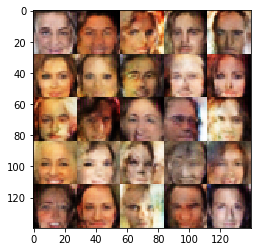

Epoch#1 progress:62.5%  dLoss:0.9706  gLoss:1.0729 
Epoch#1 progress:62.5%  dLoss:0.6371  gLoss:2.0918 
Epoch#1 progress:62.6%  dLoss:0.4867  gLoss:2.5726 
Epoch#1 progress:62.7%  dLoss:1.4552  gLoss:0.6070 
Epoch#1 progress:62.8%  dLoss:0.4946  gLoss:2.6563 
Epoch#1 progress:62.9%  dLoss:0.9527  gLoss:0.9233 
Epoch#1 progress:62.9%  dLoss:0.8922  gLoss:1.0074 
Epoch#1 progress:63.0%  dLoss:0.8343  gLoss:1.3475 
Epoch#1 progress:63.1%  dLoss:0.5314  gLoss:3.7677 
Epoch#1 progress:63.2%  dLoss:0.5275  gLoss:3.0157 


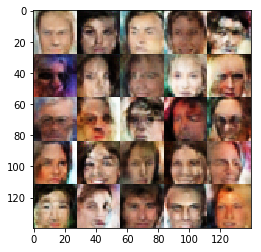

Epoch#1 progress:63.3%  dLoss:0.5976  gLoss:1.6867 
Epoch#1 progress:63.3%  dLoss:0.4667  gLoss:3.2693 
Epoch#1 progress:63.4%  dLoss:1.2252  gLoss:0.7158 
Epoch#1 progress:63.5%  dLoss:0.6287  gLoss:3.8988 
Epoch#1 progress:63.6%  dLoss:0.4232  gLoss:3.0402 
Epoch#1 progress:63.7%  dLoss:0.6347  gLoss:2.3217 
Epoch#1 progress:63.7%  dLoss:0.8232  gLoss:1.4080 
Epoch#1 progress:63.8%  dLoss:0.5852  gLoss:2.5944 
Epoch#1 progress:63.9%  dLoss:0.5003  gLoss:2.7710 
Epoch#1 progress:64.0%  dLoss:0.8567  gLoss:1.0036 


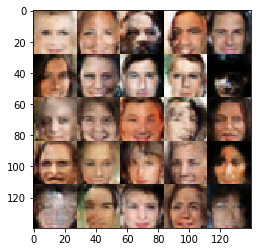

Epoch#1 progress:64.0%  dLoss:0.7063  gLoss:5.4094 
Epoch#1 progress:64.1%  dLoss:0.6063  gLoss:2.2433 
Epoch#1 progress:64.2%  dLoss:0.7728  gLoss:1.4211 
Epoch#1 progress:64.3%  dLoss:0.6521  gLoss:2.6301 
Epoch#1 progress:64.4%  dLoss:0.8555  gLoss:1.0030 
Epoch#1 progress:64.4%  dLoss:0.7887  gLoss:1.5970 
Epoch#1 progress:64.5%  dLoss:0.6196  gLoss:2.0205 
Epoch#1 progress:64.6%  dLoss:0.5851  gLoss:3.0496 
Epoch#1 progress:64.7%  dLoss:0.5055  gLoss:4.0820 
Epoch#1 progress:64.8%  dLoss:0.6564  gLoss:1.7883 


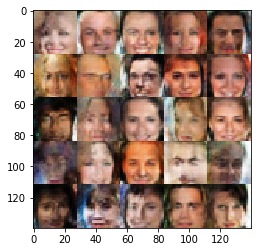

Epoch#1 progress:64.8%  dLoss:0.6236  gLoss:3.2457 
Epoch#1 progress:64.9%  dLoss:0.8828  gLoss:2.5626 
Epoch#1 progress:65.0%  dLoss:0.5587  gLoss:2.4904 
Epoch#1 progress:65.1%  dLoss:0.5752  gLoss:2.8823 
Epoch#1 progress:65.2%  dLoss:0.5582  gLoss:2.4895 
Epoch#1 progress:65.2%  dLoss:0.6132  gLoss:1.9651 
Epoch#1 progress:65.3%  dLoss:0.5706  gLoss:5.0296 
Epoch#1 progress:65.4%  dLoss:0.5297  gLoss:2.3948 
Epoch#1 progress:65.5%  dLoss:0.8041  gLoss:3.3837 
Epoch#1 progress:65.6%  dLoss:0.4022  gLoss:2.6623 


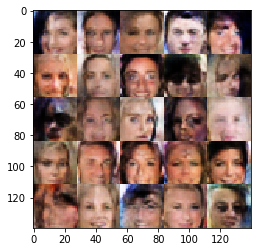

Epoch#1 progress:65.6%  dLoss:0.7419  gLoss:1.2894 
Epoch#1 progress:65.7%  dLoss:1.0880  gLoss:0.8560 
Epoch#1 progress:65.8%  dLoss:0.5405  gLoss:2.3029 
Epoch#1 progress:65.9%  dLoss:0.6268  gLoss:2.2202 
Epoch#1 progress:65.9%  dLoss:0.6306  gLoss:3.0143 
Epoch#1 progress:66.0%  dLoss:0.5951  gLoss:3.1865 
Epoch#1 progress:66.1%  dLoss:0.8071  gLoss:1.3784 
Epoch#1 progress:66.2%  dLoss:0.6553  gLoss:2.0282 
Epoch#1 progress:66.3%  dLoss:0.5472  gLoss:2.4072 
Epoch#1 progress:66.3%  dLoss:2.5534  gLoss:2.8263 


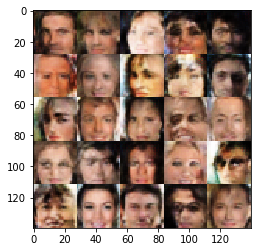

Epoch#1 progress:66.4%  dLoss:1.0705  gLoss:1.0421 
Epoch#1 progress:66.5%  dLoss:0.7579  gLoss:1.3018 
Epoch#1 progress:66.6%  dLoss:0.9645  gLoss:1.2123 
Epoch#1 progress:66.7%  dLoss:0.5745  gLoss:2.2058 
Epoch#1 progress:66.7%  dLoss:0.9667  gLoss:0.9517 
Epoch#1 progress:66.8%  dLoss:0.5989  gLoss:2.3907 
Epoch#1 progress:66.9%  dLoss:0.6091  gLoss:1.9368 
Epoch#1 progress:67.0%  dLoss:0.6730  gLoss:1.4357 
Epoch#1 progress:67.1%  dLoss:0.5498  gLoss:2.2145 
Epoch#1 progress:67.1%  dLoss:0.5896  gLoss:1.9653 


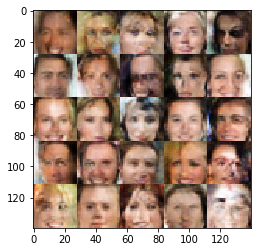

Epoch#1 progress:67.2%  dLoss:1.3175  gLoss:0.5923 
Epoch#1 progress:67.3%  dLoss:0.6438  gLoss:3.1144 
Epoch#1 progress:67.4%  dLoss:0.7478  gLoss:4.2127 
Epoch#1 progress:67.4%  dLoss:0.5132  gLoss:3.2272 
Epoch#1 progress:67.5%  dLoss:1.1621  gLoss:0.7505 
Epoch#1 progress:67.6%  dLoss:0.6268  gLoss:2.0309 
Epoch#1 progress:67.7%  dLoss:0.8949  gLoss:1.1586 
Epoch#1 progress:67.8%  dLoss:0.5726  gLoss:2.8116 
Epoch#1 progress:67.8%  dLoss:0.5484  gLoss:2.6093 
Epoch#1 progress:67.9%  dLoss:0.6003  gLoss:2.2252 


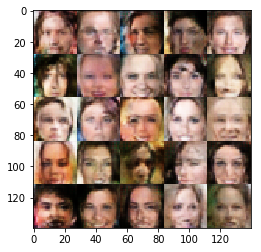

Epoch#1 progress:68.0%  dLoss:0.5445  gLoss:2.0396 
Epoch#1 progress:68.1%  dLoss:0.5629  gLoss:4.0328 
Epoch#1 progress:68.2%  dLoss:0.9797  gLoss:0.9731 
Epoch#1 progress:68.2%  dLoss:0.6362  gLoss:1.9975 
Epoch#1 progress:68.3%  dLoss:0.9221  gLoss:1.0728 
Epoch#1 progress:68.4%  dLoss:0.5816  gLoss:2.5520 
Epoch#1 progress:68.5%  dLoss:0.8821  gLoss:1.0158 
Epoch#1 progress:68.6%  dLoss:0.5038  gLoss:2.9096 
Epoch#1 progress:68.6%  dLoss:1.3628  gLoss:0.6052 
Epoch#1 progress:68.7%  dLoss:0.6472  gLoss:2.1866 


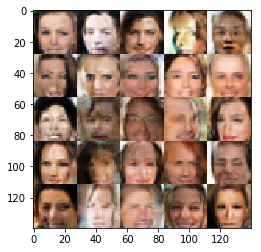

Epoch#1 progress:68.8%  dLoss:0.6788  gLoss:1.4254 
Epoch#1 progress:68.9%  dLoss:0.4303  gLoss:3.3526 
Epoch#1 progress:68.9%  dLoss:0.6813  gLoss:1.9362 
Epoch#1 progress:69.0%  dLoss:0.6692  gLoss:1.9306 
Epoch#1 progress:69.1%  dLoss:0.6897  gLoss:1.5865 
Epoch#1 progress:69.2%  dLoss:0.5339  gLoss:1.9815 
Epoch#1 progress:69.3%  dLoss:0.6670  gLoss:2.6120 
Epoch#1 progress:69.3%  dLoss:0.5288  gLoss:2.7300 
Epoch#1 progress:69.4%  dLoss:1.3237  gLoss:0.5714 
Epoch#1 progress:69.5%  dLoss:1.3544  gLoss:0.8488 


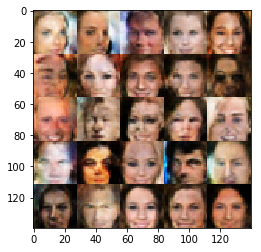

Epoch#1 progress:69.6%  dLoss:0.4640  gLoss:2.4825 
Epoch#1 progress:69.7%  dLoss:0.5569  gLoss:2.6845 
Epoch#1 progress:69.7%  dLoss:2.1266  gLoss:0.2728 
Epoch#1 progress:69.8%  dLoss:0.5773  gLoss:2.5664 
Epoch#1 progress:69.9%  dLoss:0.5634  gLoss:2.5768 
Epoch#1 progress:70.0%  dLoss:0.7774  gLoss:1.4641 
Epoch#1 progress:70.1%  dLoss:0.5906  gLoss:3.8835 
Epoch#1 progress:70.1%  dLoss:0.7009  gLoss:3.7201 
Epoch#1 progress:70.2%  dLoss:0.5846  gLoss:2.9993 
Epoch#1 progress:70.3%  dLoss:1.0710  gLoss:1.1534 


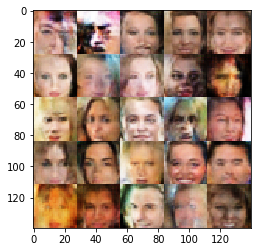

Epoch#1 progress:70.4%  dLoss:0.7344  gLoss:1.3990 
Epoch#1 progress:70.4%  dLoss:0.7198  gLoss:1.6622 
Epoch#1 progress:70.5%  dLoss:0.7784  gLoss:1.1336 
Epoch#1 progress:70.6%  dLoss:0.5559  gLoss:2.8949 
Epoch#1 progress:70.7%  dLoss:1.0806  gLoss:1.0223 
Epoch#1 progress:70.8%  dLoss:0.6949  gLoss:1.7126 
Epoch#1 progress:70.8%  dLoss:0.5404  gLoss:2.5052 
Epoch#1 progress:70.9%  dLoss:0.6932  gLoss:1.5726 
Epoch#1 progress:71.0%  dLoss:0.9215  gLoss:1.0118 
Epoch#1 progress:71.1%  dLoss:0.4459  gLoss:2.9903 


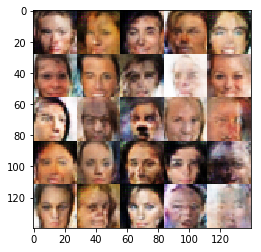

Epoch#1 progress:71.2%  dLoss:0.5790  gLoss:3.5652 
Epoch#1 progress:71.2%  dLoss:1.7795  gLoss:0.3439 
Epoch#1 progress:71.3%  dLoss:0.6126  gLoss:2.7985 
Epoch#1 progress:71.4%  dLoss:0.8549  gLoss:3.0274 
Epoch#1 progress:71.5%  dLoss:1.2404  gLoss:0.5985 
Epoch#1 progress:71.6%  dLoss:0.8584  gLoss:1.1661 
Epoch#1 progress:71.6%  dLoss:0.7828  gLoss:1.4502 
Epoch#1 progress:71.7%  dLoss:0.7665  gLoss:1.4017 
Epoch#1 progress:71.8%  dLoss:0.7405  gLoss:1.2826 
Epoch#1 progress:71.9%  dLoss:1.0121  gLoss:0.9773 


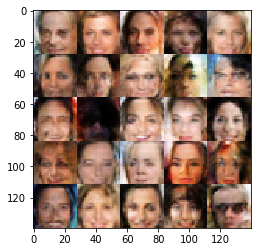

Epoch#1 progress:71.9%  dLoss:0.8525  gLoss:2.2497 
Epoch#1 progress:72.0%  dLoss:1.1540  gLoss:0.7806 
Epoch#1 progress:72.1%  dLoss:1.1340  gLoss:0.8960 
Epoch#1 progress:72.2%  dLoss:1.8620  gLoss:0.3542 
Epoch#1 progress:72.3%  dLoss:0.8248  gLoss:1.2909 
Epoch#1 progress:72.3%  dLoss:0.5151  gLoss:2.3623 
Epoch#1 progress:72.4%  dLoss:0.6957  gLoss:1.9287 
Epoch#1 progress:72.5%  dLoss:0.6360  gLoss:3.0185 
Epoch#1 progress:72.6%  dLoss:0.5697  gLoss:2.5396 
Epoch#1 progress:72.7%  dLoss:0.5172  gLoss:3.3596 


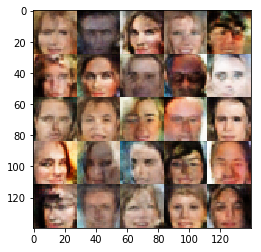

Epoch#1 progress:72.7%  dLoss:0.7147  gLoss:1.6265 
Epoch#1 progress:72.8%  dLoss:0.8315  gLoss:1.4461 
Epoch#1 progress:72.9%  dLoss:0.6669  gLoss:1.3828 
Epoch#1 progress:73.0%  dLoss:0.8676  gLoss:1.3824 
Epoch#1 progress:73.1%  dLoss:0.5020  gLoss:2.6415 
Epoch#1 progress:73.1%  dLoss:0.7423  gLoss:2.3514 
Epoch#1 progress:73.2%  dLoss:0.5887  gLoss:1.7234 
Epoch#1 progress:73.3%  dLoss:0.5311  gLoss:3.2273 
Epoch#1 progress:73.4%  dLoss:0.9227  gLoss:1.3180 
Epoch#1 progress:73.4%  dLoss:0.4790  gLoss:3.6855 


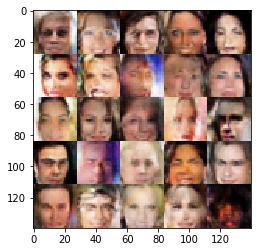

Epoch#1 progress:73.5%  dLoss:0.5519  gLoss:2.7279 
Epoch#1 progress:73.6%  dLoss:1.1139  gLoss:0.7472 
Epoch#1 progress:73.7%  dLoss:0.4932  gLoss:3.3032 
Epoch#1 progress:73.8%  dLoss:0.7165  gLoss:1.5628 
Epoch#1 progress:73.8%  dLoss:0.5667  gLoss:2.5209 
Epoch#1 progress:73.9%  dLoss:0.6078  gLoss:2.1684 
Epoch#1 progress:74.0%  dLoss:0.5083  gLoss:2.3661 
Epoch#1 progress:74.1%  dLoss:0.7849  gLoss:1.3381 
Epoch#1 progress:74.2%  dLoss:0.6180  gLoss:2.1547 
Epoch#1 progress:74.2%  dLoss:0.5562  gLoss:2.1807 


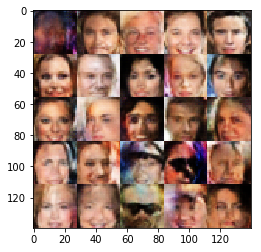

Epoch#1 progress:74.3%  dLoss:1.0706  gLoss:0.9918 
Epoch#1 progress:74.4%  dLoss:0.8500  gLoss:1.5757 
Epoch#1 progress:74.5%  dLoss:0.5133  gLoss:2.4733 
Epoch#1 progress:74.6%  dLoss:0.5977  gLoss:1.8734 
Epoch#1 progress:74.6%  dLoss:1.2438  gLoss:0.7141 
Epoch#1 progress:74.7%  dLoss:0.6988  gLoss:1.9531 
Epoch#1 progress:74.8%  dLoss:0.4973  gLoss:2.9403 
Epoch#1 progress:74.9%  dLoss:0.4755  gLoss:3.2172 
Epoch#1 progress:74.9%  dLoss:0.7038  gLoss:1.3640 
Epoch#1 progress:75.0%  dLoss:0.6407  gLoss:2.2313 


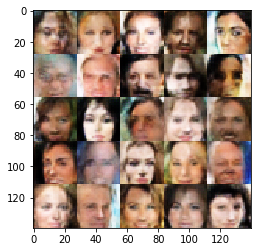

Epoch#1 progress:75.1%  dLoss:0.9659  gLoss:1.0077 
Epoch#1 progress:75.2%  dLoss:0.9269  gLoss:0.9612 
Epoch#1 progress:75.3%  dLoss:0.5081  gLoss:3.0085 
Epoch#1 progress:75.3%  dLoss:0.4672  gLoss:3.8682 
Epoch#1 progress:75.4%  dLoss:0.7015  gLoss:1.6020 
Epoch#1 progress:75.5%  dLoss:0.6469  gLoss:1.7481 
Epoch#1 progress:75.6%  dLoss:0.6062  gLoss:3.2624 
Epoch#1 progress:75.7%  dLoss:0.5943  gLoss:1.6927 
Epoch#1 progress:75.7%  dLoss:0.7819  gLoss:3.4764 
Epoch#1 progress:75.8%  dLoss:1.5759  gLoss:0.4692 


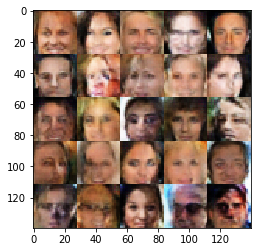

Epoch#1 progress:75.9%  dLoss:0.4039  gLoss:3.4027 
Epoch#1 progress:76.0%  dLoss:1.3773  gLoss:0.5910 
Epoch#1 progress:76.1%  dLoss:0.7383  gLoss:1.6930 
Epoch#1 progress:76.1%  dLoss:0.7030  gLoss:1.7620 
Epoch#1 progress:76.2%  dLoss:0.4647  gLoss:2.8895 
Epoch#1 progress:76.3%  dLoss:0.7330  gLoss:2.6400 
Epoch#1 progress:76.4%  dLoss:0.6939  gLoss:1.7775 
Epoch#1 progress:76.4%  dLoss:0.4950  gLoss:2.9657 
Epoch#1 progress:76.5%  dLoss:1.0514  gLoss:1.0570 
Epoch#1 progress:76.6%  dLoss:0.6533  gLoss:1.8400 


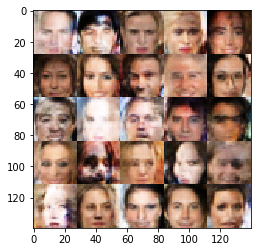

Epoch#1 progress:76.7%  dLoss:0.7128  gLoss:1.4942 
Epoch#1 progress:76.8%  dLoss:1.0261  gLoss:3.4543 
Epoch#1 progress:76.8%  dLoss:0.7900  gLoss:1.1627 
Epoch#1 progress:76.9%  dLoss:0.4687  gLoss:2.7792 
Epoch#1 progress:77.0%  dLoss:0.8537  gLoss:1.0989 
Epoch#1 progress:77.1%  dLoss:0.4747  gLoss:2.4957 
Epoch#1 progress:77.2%  dLoss:0.6450  gLoss:2.3877 
Epoch#1 progress:77.2%  dLoss:0.5170  gLoss:4.1584 
Epoch#1 progress:77.3%  dLoss:0.7054  gLoss:2.1946 
Epoch#1 progress:77.4%  dLoss:0.6589  gLoss:2.9203 


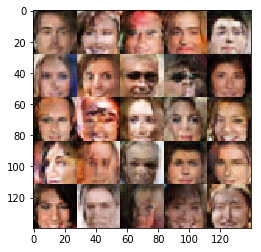

Epoch#1 progress:77.5%  dLoss:0.6861  gLoss:1.4290 
Epoch#1 progress:77.6%  dLoss:0.9606  gLoss:0.9909 
Epoch#1 progress:77.6%  dLoss:0.6231  gLoss:1.8861 
Epoch#1 progress:77.7%  dLoss:0.7024  gLoss:1.8501 
Epoch#1 progress:77.8%  dLoss:0.8445  gLoss:1.0733 
Epoch#1 progress:77.9%  dLoss:0.7289  gLoss:1.6873 
Epoch#1 progress:77.9%  dLoss:0.4576  gLoss:2.2398 
Epoch#1 progress:78.0%  dLoss:0.5102  gLoss:2.9577 
Epoch#1 progress:78.1%  dLoss:0.8950  gLoss:0.9455 
Epoch#1 progress:78.2%  dLoss:0.7610  gLoss:1.4063 


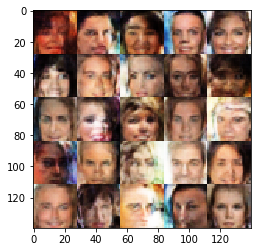

Epoch#1 progress:78.3%  dLoss:0.5042  gLoss:2.0507 
Epoch#1 progress:78.3%  dLoss:1.2005  gLoss:0.6966 
Epoch#1 progress:78.4%  dLoss:1.2494  gLoss:0.8345 
Epoch#1 progress:78.5%  dLoss:0.6109  gLoss:2.4439 
Epoch#1 progress:78.6%  dLoss:0.4812  gLoss:2.4161 
Epoch#1 progress:78.7%  dLoss:0.9718  gLoss:1.0165 
Epoch#1 progress:78.7%  dLoss:1.4555  gLoss:0.5479 
Epoch#1 progress:78.8%  dLoss:0.8793  gLoss:1.2187 
Epoch#1 progress:78.9%  dLoss:0.6117  gLoss:2.4853 
Epoch#1 progress:79.0%  dLoss:1.2072  gLoss:0.7751 


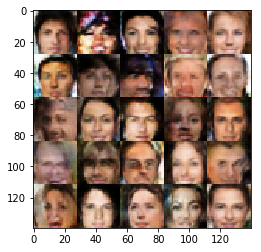

Epoch#1 progress:79.1%  dLoss:0.5550  gLoss:2.7486 
Epoch#1 progress:79.1%  dLoss:0.9613  gLoss:1.1170 
Epoch#1 progress:79.2%  dLoss:0.6074  gLoss:1.8605 
Epoch#1 progress:79.3%  dLoss:0.9126  gLoss:1.3722 
Epoch#1 progress:79.4%  dLoss:0.8224  gLoss:1.8502 
Epoch#1 progress:79.5%  dLoss:0.8706  gLoss:1.1963 
Epoch#1 progress:79.5%  dLoss:0.9482  gLoss:0.9333 
Epoch#1 progress:79.6%  dLoss:0.8328  gLoss:1.2605 
Epoch#1 progress:79.7%  dLoss:0.5386  gLoss:2.4754 
Epoch#1 progress:79.8%  dLoss:0.7270  gLoss:1.2135 


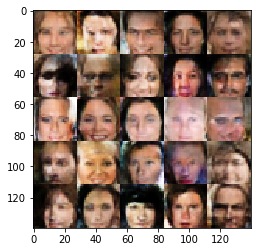

Epoch#1 progress:79.8%  dLoss:0.5726  gLoss:2.1610 
Epoch#1 progress:79.9%  dLoss:2.5240  gLoss:0.2543 
Epoch#1 progress:80.0%  dLoss:0.6480  gLoss:1.7081 
Epoch#1 progress:80.1%  dLoss:1.5209  gLoss:0.6201 
Epoch#1 progress:80.2%  dLoss:0.6488  gLoss:3.2257 
Epoch#1 progress:80.2%  dLoss:0.7301  gLoss:2.5288 
Epoch#1 progress:80.3%  dLoss:1.2551  gLoss:0.6975 
Epoch#1 progress:80.4%  dLoss:0.5018  gLoss:2.8663 
Epoch#1 progress:80.5%  dLoss:1.1309  gLoss:1.8050 
Epoch#1 progress:80.6%  dLoss:0.7005  gLoss:2.5964 


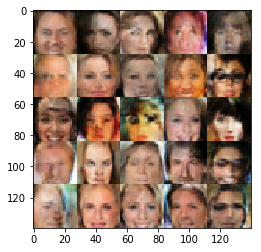

Epoch#1 progress:80.6%  dLoss:0.7088  gLoss:2.3331 
Epoch#1 progress:80.7%  dLoss:1.0409  gLoss:0.7547 
Epoch#1 progress:80.8%  dLoss:0.6149  gLoss:2.2445 
Epoch#1 progress:80.9%  dLoss:0.8003  gLoss:1.8712 
Epoch#1 progress:81.0%  dLoss:0.4975  gLoss:4.5397 
Epoch#1 progress:81.0%  dLoss:0.6840  gLoss:2.0138 
Epoch#1 progress:81.1%  dLoss:0.7322  gLoss:1.1747 
Epoch#1 progress:81.2%  dLoss:0.8305  gLoss:1.0682 
Epoch#1 progress:81.3%  dLoss:0.9243  gLoss:1.1349 
Epoch#1 progress:81.3%  dLoss:0.5631  gLoss:2.1955 


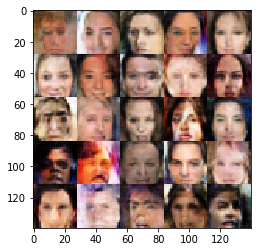

Epoch#1 progress:81.4%  dLoss:0.6221  gLoss:1.7591 
Epoch#1 progress:81.5%  dLoss:0.6101  gLoss:2.2714 
Epoch#1 progress:81.6%  dLoss:0.8373  gLoss:1.2247 
Epoch#1 progress:81.7%  dLoss:1.0439  gLoss:1.1259 
Epoch#1 progress:81.7%  dLoss:0.7018  gLoss:1.6864 
Epoch#1 progress:81.8%  dLoss:0.6430  gLoss:2.0431 
Epoch#1 progress:81.9%  dLoss:0.8107  gLoss:1.2354 
Epoch#1 progress:82.0%  dLoss:0.6423  gLoss:2.2644 
Epoch#1 progress:82.1%  dLoss:0.6029  gLoss:2.1616 
Epoch#1 progress:82.1%  dLoss:0.7027  gLoss:2.7867 


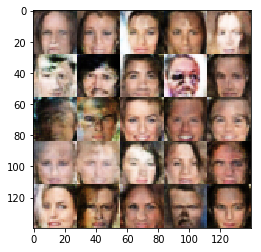

Epoch#1 progress:82.2%  dLoss:0.5982  gLoss:2.6194 
Epoch#1 progress:82.3%  dLoss:0.6669  gLoss:2.6180 
Epoch#1 progress:82.4%  dLoss:0.7294  gLoss:1.2480 
Epoch#1 progress:82.5%  dLoss:0.5773  gLoss:2.7159 
Epoch#1 progress:82.5%  dLoss:0.7021  gLoss:1.4949 
Epoch#1 progress:82.6%  dLoss:1.6076  gLoss:2.6308 
Epoch#1 progress:82.7%  dLoss:0.6685  gLoss:1.7187 
Epoch#1 progress:82.8%  dLoss:0.5132  gLoss:2.8634 
Epoch#1 progress:82.8%  dLoss:1.2195  gLoss:0.7975 
Epoch#1 progress:82.9%  dLoss:0.6521  gLoss:4.1678 


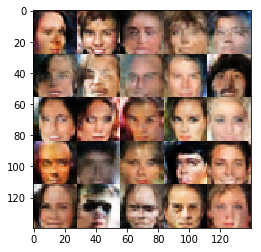

Epoch#1 progress:83.0%  dLoss:0.5183  gLoss:2.9342 
Epoch#1 progress:83.1%  dLoss:0.6032  gLoss:2.1793 
Epoch#1 progress:83.2%  dLoss:0.5568  gLoss:2.0398 
Epoch#1 progress:83.2%  dLoss:0.6602  gLoss:1.8174 
Epoch#1 progress:83.3%  dLoss:0.7510  gLoss:1.4386 
Epoch#1 progress:83.4%  dLoss:0.4816  gLoss:2.5867 
Epoch#1 progress:83.5%  dLoss:0.6148  gLoss:2.9611 
Epoch#1 progress:83.6%  dLoss:0.7605  gLoss:1.4321 
Epoch#1 progress:83.6%  dLoss:0.8901  gLoss:1.1731 
Epoch#1 progress:83.7%  dLoss:1.8434  gLoss:0.3876 


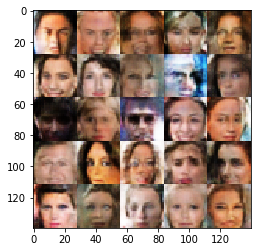

Epoch#1 progress:83.8%  dLoss:0.5863  gLoss:2.2207 
Epoch#1 progress:83.9%  dLoss:0.5437  gLoss:2.4988 
Epoch#1 progress:84.0%  dLoss:1.2793  gLoss:0.6244 
Epoch#1 progress:84.0%  dLoss:0.7484  gLoss:2.0574 
Epoch#1 progress:84.1%  dLoss:0.5364  gLoss:2.8461 
Epoch#1 progress:84.2%  dLoss:0.5691  gLoss:2.2620 
Epoch#1 progress:84.3%  dLoss:0.5188  gLoss:4.0459 
Epoch#1 progress:84.3%  dLoss:1.3945  gLoss:2.6419 
Epoch#1 progress:84.4%  dLoss:0.6060  gLoss:2.2470 
Epoch#1 progress:84.5%  dLoss:0.6305  gLoss:1.7842 


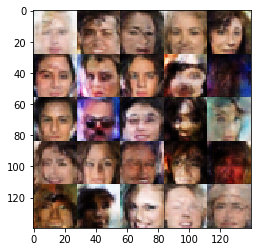

Epoch#1 progress:84.6%  dLoss:0.6931  gLoss:1.2530 
Epoch#1 progress:84.7%  dLoss:0.4723  gLoss:2.7846 
Epoch#1 progress:84.7%  dLoss:0.7394  gLoss:1.8331 
Epoch#1 progress:84.8%  dLoss:1.0743  gLoss:0.7435 
Epoch#1 progress:84.9%  dLoss:0.6602  gLoss:2.4235 
Epoch#1 progress:85.0%  dLoss:0.8203  gLoss:1.2056 
Epoch#1 progress:85.1%  dLoss:0.4501  gLoss:2.4722 
Epoch#1 progress:85.1%  dLoss:0.5638  gLoss:2.0758 
Epoch#1 progress:85.2%  dLoss:2.0508  gLoss:0.2975 
Epoch#1 progress:85.3%  dLoss:1.0009  gLoss:0.7941 


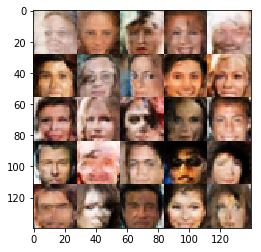

Epoch#1 progress:85.4%  dLoss:1.3742  gLoss:0.5935 
Epoch#1 progress:85.5%  dLoss:0.6614  gLoss:2.0126 
Epoch#1 progress:85.5%  dLoss:0.5388  gLoss:2.2853 
Epoch#1 progress:85.6%  dLoss:0.6922  gLoss:2.4848 
Epoch#1 progress:85.7%  dLoss:0.8282  gLoss:1.1814 
Epoch#1 progress:85.8%  dLoss:0.6824  gLoss:2.5624 
Epoch#1 progress:85.8%  dLoss:0.7067  gLoss:1.4794 
Epoch#1 progress:85.9%  dLoss:0.8635  gLoss:1.0948 
Epoch#1 progress:86.0%  dLoss:0.7171  gLoss:1.5481 
Epoch#1 progress:86.1%  dLoss:0.6220  gLoss:1.7563 


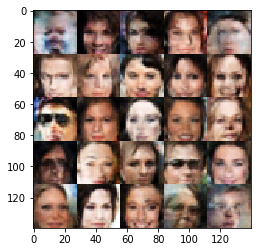

Epoch#1 progress:86.2%  dLoss:1.3004  gLoss:0.6364 
Epoch#1 progress:86.2%  dLoss:0.6271  gLoss:2.9930 
Epoch#1 progress:86.3%  dLoss:0.8684  gLoss:1.2973 
Epoch#1 progress:86.4%  dLoss:0.8121  gLoss:1.3232 
Epoch#1 progress:86.5%  dLoss:1.2772  gLoss:0.7903 
Epoch#1 progress:86.6%  dLoss:0.6671  gLoss:1.8469 
Epoch#1 progress:86.6%  dLoss:0.5043  gLoss:2.3564 
Epoch#1 progress:86.7%  dLoss:0.5144  gLoss:2.5361 
Epoch#1 progress:86.8%  dLoss:0.6828  gLoss:1.8597 
Epoch#1 progress:86.9%  dLoss:1.0165  gLoss:0.9073 


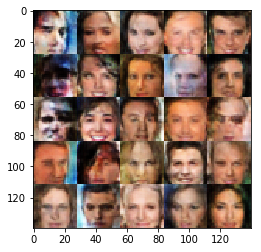

Epoch#1 progress:87.0%  dLoss:0.6168  gLoss:1.6104 
Epoch#1 progress:87.0%  dLoss:1.7768  gLoss:0.6376 
Epoch#1 progress:87.1%  dLoss:1.1946  gLoss:0.7495 
Epoch#1 progress:87.2%  dLoss:0.7940  gLoss:1.5087 
Epoch#1 progress:87.3%  dLoss:0.4836  gLoss:3.2080 
Epoch#1 progress:87.3%  dLoss:0.7263  gLoss:1.7012 
Epoch#1 progress:87.4%  dLoss:0.5879  gLoss:2.1740 
Epoch#1 progress:87.5%  dLoss:0.5349  gLoss:3.3755 
Epoch#1 progress:87.6%  dLoss:1.2516  gLoss:0.7521 
Epoch#1 progress:87.7%  dLoss:0.5011  gLoss:2.3493 


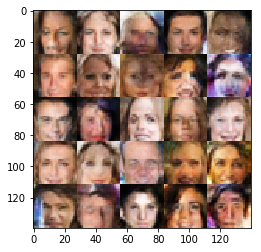

Epoch#1 progress:87.7%  dLoss:0.7154  gLoss:1.7017 
Epoch#1 progress:87.8%  dLoss:1.2730  gLoss:0.8164 
Epoch#1 progress:87.9%  dLoss:0.6961  gLoss:1.5554 
Epoch#1 progress:88.0%  dLoss:0.6086  gLoss:3.1827 
Epoch#1 progress:88.1%  dLoss:0.9726  gLoss:1.0455 
Epoch#1 progress:88.1%  dLoss:1.0013  gLoss:0.9863 
Epoch#1 progress:88.2%  dLoss:0.9788  gLoss:3.1892 
Epoch#1 progress:88.3%  dLoss:0.5909  gLoss:3.3792 
Epoch#1 progress:88.4%  dLoss:0.5916  gLoss:2.1162 
Epoch#1 progress:88.5%  dLoss:0.8276  gLoss:1.2434 


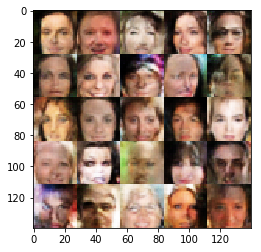

Epoch#1 progress:88.5%  dLoss:0.5321  gLoss:2.1243 
Epoch#1 progress:88.6%  dLoss:0.6696  gLoss:1.2862 
Epoch#1 progress:88.7%  dLoss:0.5253  gLoss:2.3749 
Epoch#1 progress:88.8%  dLoss:0.5355  gLoss:3.9647 
Epoch#1 progress:88.8%  dLoss:0.7698  gLoss:1.6898 
Epoch#1 progress:88.9%  dLoss:0.4193  gLoss:3.6247 
Epoch#1 progress:89.0%  dLoss:0.8005  gLoss:1.6650 
Epoch#1 progress:89.1%  dLoss:0.4366  gLoss:4.6400 
Epoch#1 progress:89.2%  dLoss:0.5242  gLoss:2.0617 
Epoch#1 progress:89.2%  dLoss:0.6836  gLoss:1.8958 


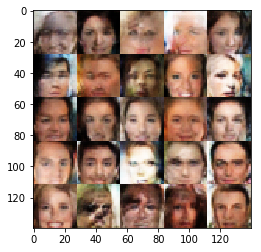

Epoch#1 progress:89.3%  dLoss:0.7827  gLoss:1.3439 
Epoch#1 progress:89.4%  dLoss:0.5119  gLoss:5.1926 
Epoch#1 progress:89.5%  dLoss:1.4632  gLoss:1.4874 
Epoch#1 progress:89.6%  dLoss:0.5955  gLoss:2.4324 
Epoch#1 progress:89.6%  dLoss:0.9066  gLoss:1.3314 
Epoch#1 progress:89.7%  dLoss:0.6309  gLoss:3.0940 
Epoch#1 progress:89.8%  dLoss:0.7813  gLoss:1.3772 
Epoch#1 progress:89.9%  dLoss:1.6831  gLoss:0.4965 
Epoch#1 progress:90.0%  dLoss:0.6509  gLoss:1.9606 
Epoch#1 progress:90.0%  dLoss:0.8108  gLoss:3.4477 


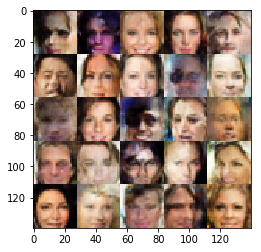

Epoch#1 progress:90.1%  dLoss:0.9933  gLoss:1.0879 
Epoch#1 progress:90.2%  dLoss:0.6740  gLoss:1.7709 
Epoch#1 progress:90.3%  dLoss:0.4986  gLoss:2.5332 
Epoch#1 progress:90.3%  dLoss:0.5204  gLoss:2.4898 
Epoch#1 progress:90.4%  dLoss:1.4660  gLoss:0.4944 
Epoch#1 progress:90.5%  dLoss:0.5249  gLoss:2.9736 
Epoch#1 progress:90.6%  dLoss:0.6468  gLoss:2.0003 
Epoch#1 progress:90.7%  dLoss:0.6998  gLoss:1.8651 
Epoch#1 progress:90.7%  dLoss:0.4078  gLoss:3.3028 
Epoch#1 progress:90.8%  dLoss:0.5632  gLoss:2.6832 


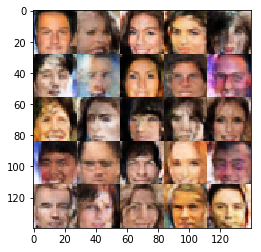

Epoch#1 progress:90.9%  dLoss:2.0069  gLoss:0.2284 
Epoch#1 progress:91.0%  dLoss:0.5747  gLoss:2.6221 
Epoch#1 progress:91.1%  dLoss:0.8118  gLoss:1.1525 
Epoch#1 progress:91.1%  dLoss:0.4249  gLoss:3.7007 
Epoch#1 progress:91.2%  dLoss:1.2635  gLoss:3.1510 
Epoch#1 progress:91.3%  dLoss:0.5919  gLoss:2.5485 
Epoch#1 progress:91.4%  dLoss:0.7833  gLoss:1.4240 
Epoch#1 progress:91.5%  dLoss:0.5657  gLoss:2.5356 
Epoch#1 progress:91.5%  dLoss:0.5582  gLoss:2.8696 
Epoch#1 progress:91.6%  dLoss:0.6485  gLoss:1.6229 


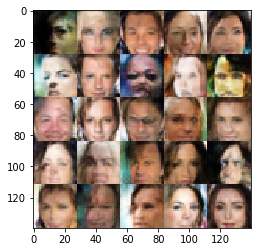

Epoch#1 progress:91.7%  dLoss:0.5714  gLoss:1.9955 
Epoch#1 progress:91.8%  dLoss:0.6826  gLoss:2.0681 
Epoch#1 progress:91.8%  dLoss:0.5312  gLoss:1.9240 
Epoch#1 progress:91.9%  dLoss:1.2794  gLoss:0.7042 
Epoch#1 progress:92.0%  dLoss:1.4387  gLoss:0.5941 
Epoch#1 progress:92.1%  dLoss:0.5642  gLoss:1.7652 
Epoch#1 progress:92.2%  dLoss:0.4759  gLoss:3.4228 
Epoch#1 progress:92.2%  dLoss:0.5992  gLoss:2.0195 
Epoch#1 progress:92.3%  dLoss:2.1114  gLoss:0.2140 
Epoch#1 progress:92.4%  dLoss:0.8043  gLoss:1.2366 


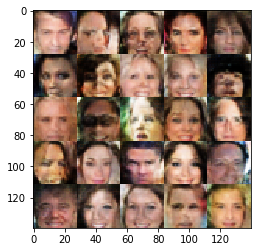

Epoch#1 progress:92.5%  dLoss:0.6450  gLoss:1.7407 
Epoch#1 progress:92.6%  dLoss:1.1001  gLoss:0.8899 
Epoch#1 progress:92.6%  dLoss:0.5656  gLoss:2.3884 
Epoch#1 progress:92.7%  dLoss:0.5979  gLoss:1.6401 
Epoch#1 progress:92.8%  dLoss:1.3441  gLoss:0.6087 
Epoch#1 progress:92.9%  dLoss:0.5880  gLoss:3.6871 
Epoch#1 progress:93.0%  dLoss:1.1178  gLoss:0.8618 
Epoch#1 progress:93.0%  dLoss:0.5887  gLoss:1.8691 
Epoch#1 progress:93.1%  dLoss:0.5473  gLoss:2.0231 
Epoch#1 progress:93.2%  dLoss:0.9368  gLoss:1.4549 


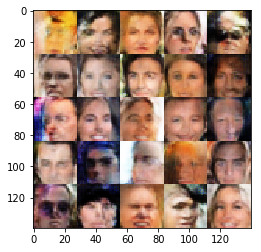

Epoch#1 progress:93.3%  dLoss:0.4890  gLoss:2.8137 
Epoch#1 progress:93.4%  dLoss:0.6676  gLoss:1.8163 
Epoch#1 progress:93.4%  dLoss:1.0666  gLoss:1.8246 
Epoch#1 progress:93.5%  dLoss:1.1658  gLoss:0.9697 
Epoch#1 progress:93.6%  dLoss:0.7105  gLoss:1.4291 
Epoch#1 progress:93.7%  dLoss:0.5069  gLoss:2.0424 
Epoch#1 progress:93.7%  dLoss:0.5582  gLoss:3.4035 
Epoch#1 progress:93.8%  dLoss:0.5234  gLoss:5.0203 
Epoch#1 progress:93.9%  dLoss:0.6551  gLoss:2.2343 
Epoch#1 progress:94.0%  dLoss:0.4985  gLoss:3.3275 


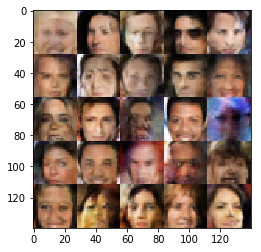

Epoch#1 progress:94.1%  dLoss:0.5976  gLoss:2.4338 
Epoch#1 progress:94.1%  dLoss:1.1158  gLoss:0.7843 
Epoch#1 progress:94.2%  dLoss:0.6101  gLoss:2.5082 
Epoch#1 progress:94.3%  dLoss:0.4386  gLoss:2.3539 
Epoch#1 progress:94.4%  dLoss:1.0308  gLoss:0.9888 
Epoch#1 progress:94.5%  dLoss:1.3917  gLoss:0.5374 
Epoch#1 progress:94.5%  dLoss:0.7544  gLoss:1.6441 
Epoch#1 progress:94.6%  dLoss:0.6472  gLoss:2.0377 
Epoch#1 progress:94.7%  dLoss:0.7043  gLoss:1.9850 
Epoch#1 progress:94.8%  dLoss:0.9865  gLoss:0.8880 


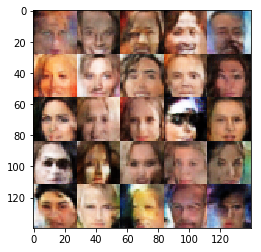

Epoch#1 progress:94.9%  dLoss:0.7951  gLoss:1.7206 
Epoch#1 progress:94.9%  dLoss:0.6406  gLoss:1.5327 
Epoch#1 progress:95.0%  dLoss:0.9840  gLoss:0.9745 
Epoch#1 progress:95.1%  dLoss:0.6140  gLoss:1.7644 
Epoch#1 progress:95.2%  dLoss:0.7257  gLoss:1.7619 
Epoch#1 progress:95.2%  dLoss:0.8251  gLoss:1.1433 
Epoch#1 progress:95.3%  dLoss:0.7078  gLoss:1.3483 
Epoch#1 progress:95.4%  dLoss:0.9339  gLoss:1.0319 
Epoch#1 progress:95.5%  dLoss:0.6692  gLoss:2.0216 
Epoch#1 progress:95.6%  dLoss:0.7720  gLoss:1.4621 


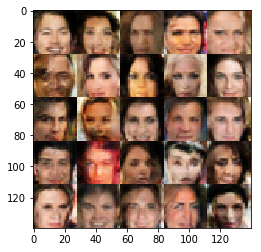

Epoch#1 progress:95.6%  dLoss:0.6950  gLoss:1.4690 
Epoch#1 progress:95.7%  dLoss:0.6386  gLoss:2.3912 
Epoch#1 progress:95.8%  dLoss:0.5929  gLoss:2.7615 
Epoch#1 progress:95.9%  dLoss:0.5982  gLoss:1.7793 
Epoch#1 progress:96.0%  dLoss:0.5621  gLoss:2.7971 
Epoch#1 progress:96.0%  dLoss:0.9726  gLoss:0.9853 
Epoch#1 progress:96.1%  dLoss:1.0221  gLoss:1.4339 
Epoch#1 progress:96.2%  dLoss:0.5731  gLoss:3.7325 
Epoch#1 progress:96.3%  dLoss:1.0002  gLoss:0.8236 
Epoch#1 progress:96.4%  dLoss:0.7496  gLoss:1.3173 


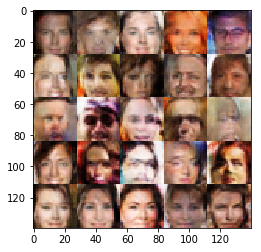

Epoch#1 progress:96.4%  dLoss:1.0616  gLoss:1.3302 
Epoch#1 progress:96.5%  dLoss:0.9157  gLoss:1.1548 
Epoch#1 progress:96.6%  dLoss:0.8933  gLoss:1.1027 
Epoch#1 progress:96.7%  dLoss:1.6014  gLoss:0.4803 
Epoch#1 progress:96.7%  dLoss:0.5952  gLoss:2.4722 
Epoch#1 progress:96.8%  dLoss:0.9309  gLoss:0.9741 
Epoch#1 progress:96.9%  dLoss:2.7075  gLoss:0.2442 
Epoch#1 progress:97.0%  dLoss:0.7567  gLoss:1.5100 
Epoch#1 progress:97.1%  dLoss:0.4968  gLoss:2.2922 
Epoch#1 progress:97.1%  dLoss:0.7718  gLoss:1.3666 


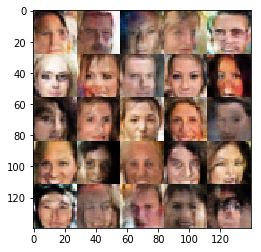

Epoch#1 progress:97.2%  dLoss:0.4776  gLoss:2.6072 
Epoch#1 progress:97.3%  dLoss:0.6804  gLoss:1.5845 
Epoch#1 progress:97.4%  dLoss:0.4612  gLoss:3.5586 
Epoch#1 progress:97.5%  dLoss:0.8029  gLoss:1.4205 
Epoch#1 progress:97.5%  dLoss:1.9279  gLoss:0.3703 
Epoch#1 progress:97.6%  dLoss:0.7421  gLoss:2.5091 
Epoch#1 progress:97.7%  dLoss:0.5475  gLoss:2.3716 
Epoch#1 progress:97.8%  dLoss:0.7747  gLoss:1.9673 
Epoch#1 progress:97.9%  dLoss:0.6663  gLoss:1.8271 
Epoch#1 progress:97.9%  dLoss:0.7417  gLoss:3.5680 


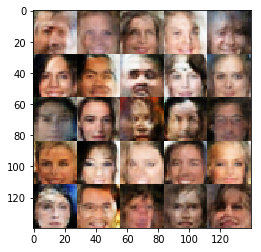

Epoch#1 progress:98.0%  dLoss:0.7436  gLoss:1.5413 
Epoch#1 progress:98.1%  dLoss:0.6453  gLoss:1.8134 
Epoch#1 progress:98.2%  dLoss:0.5777  gLoss:2.4436 
Epoch#1 progress:98.2%  dLoss:0.6488  gLoss:2.0770 
Epoch#1 progress:98.3%  dLoss:0.4554  gLoss:3.4642 
Epoch#1 progress:98.4%  dLoss:0.5650  gLoss:2.3661 
Epoch#1 progress:98.5%  dLoss:0.5736  gLoss:3.2843 
Epoch#1 progress:98.6%  dLoss:0.4302  gLoss:2.8017 
Epoch#1 progress:98.6%  dLoss:0.6303  gLoss:1.8766 
Epoch#1 progress:98.7%  dLoss:1.6371  gLoss:0.4732 


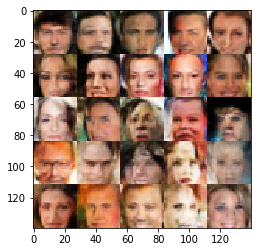

Epoch#1 progress:98.8%  dLoss:0.8023  gLoss:2.0211 
Epoch#1 progress:98.9%  dLoss:1.1551  gLoss:0.7185 
Epoch#1 progress:99.0%  dLoss:1.4517  gLoss:0.6242 
Epoch#1 progress:99.0%  dLoss:0.4787  gLoss:2.6388 
Epoch#1 progress:99.1%  dLoss:0.7804  gLoss:1.4118 
Epoch#1 progress:99.2%  dLoss:1.1106  gLoss:1.0101 
Epoch#1 progress:99.3%  dLoss:0.7217  gLoss:1.5406 
Epoch#1 progress:99.4%  dLoss:0.6207  gLoss:3.4137 
Epoch#1 progress:99.4%  dLoss:0.5047  gLoss:2.5267 
Epoch#1 progress:99.5%  dLoss:0.6235  gLoss:1.5967 


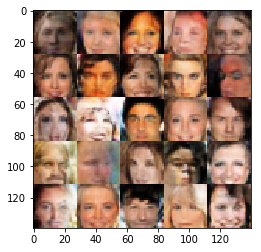

Epoch#1 progress:99.6%  dLoss:0.5388  gLoss:2.7681 
Epoch#1 progress:99.7%  dLoss:0.6393  gLoss:1.9603 
Epoch#1 progress:99.7%  dLoss:0.4871  gLoss:4.1434 
Epoch#1 progress:99.8%  dLoss:1.1600  gLoss:0.8258 
Epoch#1 progress:99.9%  dLoss:0.6904  gLoss:1.7530 
Epoch#1 progress:100.0%  dLoss:1.0895  gLoss:0.8366 


In [41]:
batch_size = 16
z_dim = 256
learning_rate = 0.0002
beta1 = 0.25

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

Epoch#1 progress:0.1%  dLoss:1.1501  gLoss:8.4904 
Epoch#1 progress:0.2%  dLoss:0.5433  gLoss:3.3068 
Epoch#1 progress:0.2%  dLoss:0.6685  gLoss:2.4371 
Epoch#1 progress:0.3%  dLoss:0.9009  gLoss:1.5165 
Epoch#1 progress:0.4%  dLoss:1.0528  gLoss:1.1827 
Epoch#1 progress:0.5%  dLoss:2.2552  gLoss:0.3805 
Epoch#1 progress:0.6%  dLoss:1.5590  gLoss:0.5879 
Epoch#1 progress:0.6%  dLoss:1.4769  gLoss:0.9172 
Epoch#1 progress:0.7%  dLoss:1.6733  gLoss:2.7138 
Epoch#1 progress:0.8%  dLoss:3.6327  gLoss:0.1977 


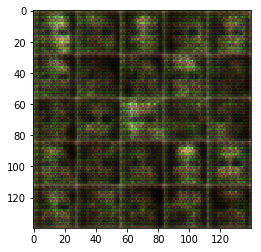

Epoch#1 progress:0.9%  dLoss:1.1695  gLoss:0.7101 
Epoch#1 progress:0.9%  dLoss:1.1587  gLoss:0.7100 
Epoch#1 progress:1.0%  dLoss:1.3332  gLoss:0.6039 
Epoch#1 progress:1.1%  dLoss:1.5345  gLoss:0.4900 
Epoch#1 progress:1.2%  dLoss:2.0371  gLoss:0.3529 
Epoch#1 progress:1.3%  dLoss:0.9540  gLoss:2.4189 
Epoch#1 progress:1.3%  dLoss:0.9522  gLoss:1.2081 
Epoch#1 progress:1.4%  dLoss:2.2296  gLoss:0.3560 
Epoch#1 progress:1.5%  dLoss:0.8915  gLoss:1.0610 
Epoch#1 progress:1.6%  dLoss:1.3361  gLoss:0.5227 


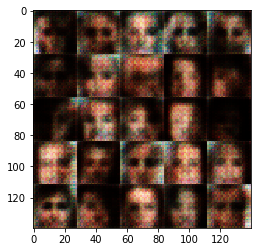

Epoch#1 progress:1.7%  dLoss:1.5127  gLoss:0.6194 
Epoch#1 progress:1.7%  dLoss:1.5476  gLoss:0.6775 
Epoch#1 progress:1.8%  dLoss:1.7395  gLoss:0.5639 
Epoch#1 progress:1.9%  dLoss:1.4621  gLoss:0.7193 
Epoch#1 progress:2.0%  dLoss:1.4633  gLoss:0.7885 
Epoch#1 progress:2.1%  dLoss:1.3509  gLoss:0.7216 
Epoch#1 progress:2.1%  dLoss:1.4394  gLoss:0.6869 
Epoch#1 progress:2.2%  dLoss:1.5899  gLoss:0.3488 
Epoch#1 progress:2.3%  dLoss:1.4676  gLoss:0.7292 
Epoch#1 progress:2.4%  dLoss:1.4776  gLoss:0.6952 


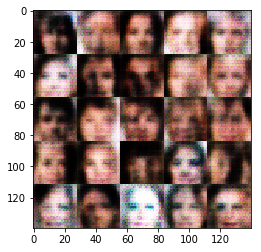

Epoch#1 progress:2.4%  dLoss:1.5547  gLoss:0.4311 
Epoch#1 progress:2.5%  dLoss:1.3714  gLoss:0.9195 
Epoch#1 progress:2.6%  dLoss:2.1953  gLoss:0.2640 
Epoch#1 progress:2.7%  dLoss:1.4988  gLoss:0.7270 
Epoch#1 progress:2.8%  dLoss:0.9198  gLoss:1.4303 
Epoch#1 progress:2.8%  dLoss:0.9735  gLoss:1.1458 
Epoch#1 progress:2.9%  dLoss:1.6144  gLoss:0.4103 
Epoch#1 progress:3.0%  dLoss:1.6895  gLoss:0.5309 
Epoch#1 progress:3.1%  dLoss:1.4197  gLoss:0.5398 
Epoch#1 progress:3.2%  dLoss:2.2970  gLoss:2.1816 


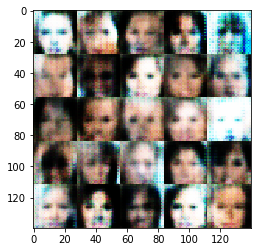

Epoch#1 progress:3.2%  dLoss:0.8462  gLoss:1.4060 
Epoch#1 progress:3.3%  dLoss:0.7236  gLoss:2.1559 
Epoch#1 progress:3.4%  dLoss:2.0146  gLoss:0.3734 
Epoch#1 progress:3.5%  dLoss:1.7209  gLoss:0.5003 
Epoch#1 progress:3.6%  dLoss:1.4437  gLoss:0.6318 
Epoch#1 progress:3.6%  dLoss:1.6911  gLoss:0.4093 
Epoch#1 progress:3.7%  dLoss:2.1820  gLoss:0.2598 
Epoch#1 progress:3.8%  dLoss:1.4417  gLoss:0.5521 
Epoch#1 progress:3.9%  dLoss:1.6941  gLoss:0.4322 
Epoch#1 progress:3.9%  dLoss:1.7694  gLoss:0.4351 


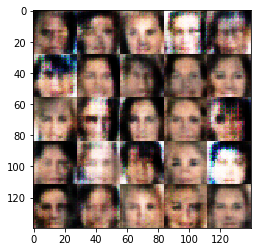

Epoch#1 progress:4.0%  dLoss:1.0442  gLoss:1.0977 
Epoch#1 progress:4.1%  dLoss:1.5433  gLoss:0.7524 
Epoch#1 progress:4.2%  dLoss:1.5439  gLoss:0.9655 
Epoch#1 progress:4.3%  dLoss:1.7582  gLoss:0.4709 
Epoch#1 progress:4.3%  dLoss:1.6825  gLoss:0.5069 
Epoch#1 progress:4.4%  dLoss:1.4913  gLoss:0.7880 
Epoch#1 progress:4.5%  dLoss:1.3699  gLoss:1.2321 
Epoch#1 progress:4.6%  dLoss:1.5314  gLoss:0.6173 
Epoch#1 progress:4.7%  dLoss:1.3996  gLoss:0.4972 
Epoch#1 progress:4.7%  dLoss:1.5370  gLoss:0.5439 


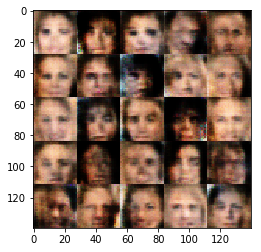

Epoch#1 progress:4.8%  dLoss:1.1615  gLoss:0.8770 
Epoch#1 progress:4.9%  dLoss:1.2900  gLoss:0.7451 
Epoch#1 progress:5.0%  dLoss:1.6036  gLoss:0.3279 
Epoch#1 progress:5.1%  dLoss:1.2440  gLoss:1.1690 
Epoch#1 progress:5.1%  dLoss:1.5541  gLoss:0.4989 
Epoch#1 progress:5.2%  dLoss:1.2676  gLoss:0.6526 
Epoch#1 progress:5.3%  dLoss:1.4025  gLoss:0.7870 
Epoch#1 progress:5.4%  dLoss:1.3816  gLoss:0.5976 
Epoch#1 progress:5.4%  dLoss:1.3957  gLoss:0.5925 
Epoch#1 progress:5.5%  dLoss:1.4585  gLoss:1.1930 


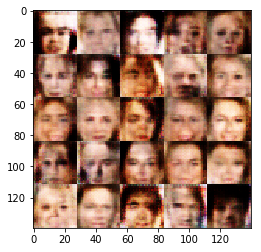

Epoch#1 progress:5.6%  dLoss:1.5454  gLoss:0.4752 
Epoch#1 progress:5.7%  dLoss:1.1655  gLoss:1.0907 
Epoch#1 progress:5.8%  dLoss:1.2307  gLoss:1.8667 
Epoch#1 progress:5.8%  dLoss:1.2102  gLoss:0.7468 
Epoch#1 progress:5.9%  dLoss:1.3697  gLoss:0.5259 
Epoch#1 progress:6.0%  dLoss:1.0881  gLoss:1.1949 
Epoch#1 progress:6.1%  dLoss:1.3465  gLoss:0.5168 
Epoch#1 progress:6.2%  dLoss:1.2696  gLoss:1.7502 
Epoch#1 progress:6.2%  dLoss:1.2021  gLoss:1.1931 
Epoch#1 progress:6.3%  dLoss:0.9750  gLoss:1.1748 


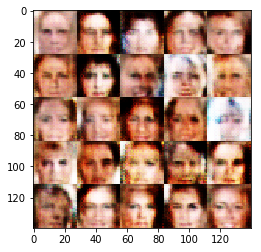

Epoch#1 progress:6.4%  dLoss:1.2875  gLoss:0.7928 
Epoch#1 progress:6.5%  dLoss:1.5886  gLoss:2.3772 
Epoch#1 progress:6.6%  dLoss:1.1656  gLoss:0.9123 
Epoch#1 progress:6.6%  dLoss:1.3917  gLoss:1.6680 
Epoch#1 progress:6.7%  dLoss:1.3592  gLoss:0.5472 
Epoch#1 progress:6.8%  dLoss:1.0123  gLoss:1.0423 
Epoch#1 progress:6.9%  dLoss:1.0984  gLoss:0.7384 
Epoch#1 progress:6.9%  dLoss:1.2147  gLoss:1.3050 
Epoch#1 progress:7.0%  dLoss:1.0785  gLoss:0.9788 
Epoch#1 progress:7.1%  dLoss:1.4974  gLoss:0.4974 


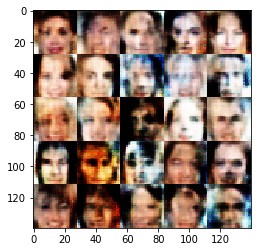

Epoch#1 progress:7.2%  dLoss:0.5249  gLoss:2.3881 
Epoch#1 progress:7.3%  dLoss:1.3859  gLoss:0.6168 
Epoch#1 progress:7.3%  dLoss:0.6771  gLoss:1.9326 
Epoch#1 progress:7.4%  dLoss:0.9297  gLoss:1.8639 
Epoch#1 progress:7.5%  dLoss:1.2460  gLoss:0.8009 
Epoch#1 progress:7.6%  dLoss:1.1802  gLoss:0.8072 
Epoch#1 progress:7.7%  dLoss:0.9600  gLoss:1.2614 
Epoch#1 progress:7.7%  dLoss:0.8877  gLoss:1.2508 
Epoch#1 progress:7.8%  dLoss:0.8068  gLoss:1.2139 
Epoch#1 progress:7.9%  dLoss:1.1213  gLoss:1.3382 


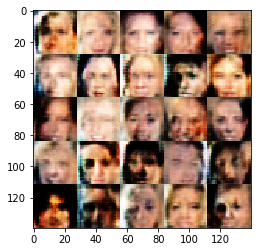

Epoch#1 progress:8.0%  dLoss:1.6738  gLoss:2.3377 
Epoch#1 progress:8.1%  dLoss:1.0336  gLoss:1.6934 
Epoch#1 progress:8.1%  dLoss:0.9523  gLoss:1.0064 
Epoch#1 progress:8.2%  dLoss:3.7977  gLoss:3.1876 
Epoch#1 progress:8.3%  dLoss:1.4046  gLoss:0.6159 
Epoch#1 progress:8.4%  dLoss:1.3322  gLoss:0.9570 
Epoch#1 progress:8.5%  dLoss:1.4794  gLoss:0.5307 
Epoch#1 progress:8.5%  dLoss:1.1838  gLoss:1.0427 
Epoch#1 progress:8.6%  dLoss:1.7040  gLoss:2.0326 
Epoch#1 progress:8.7%  dLoss:1.1287  gLoss:1.1613 


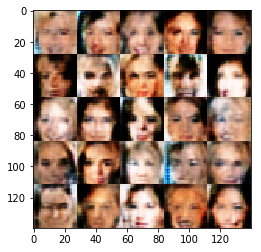

Epoch#1 progress:8.8%  dLoss:0.8337  gLoss:1.6968 
Epoch#1 progress:8.8%  dLoss:0.9334  gLoss:1.2012 
Epoch#1 progress:8.9%  dLoss:0.9970  gLoss:1.3724 
Epoch#1 progress:9.0%  dLoss:1.1661  gLoss:0.8194 
Epoch#1 progress:9.1%  dLoss:0.9531  gLoss:1.4561 
Epoch#1 progress:9.2%  dLoss:1.1980  gLoss:0.7745 
Epoch#1 progress:9.2%  dLoss:0.8567  gLoss:1.1683 
Epoch#1 progress:9.3%  dLoss:1.1413  gLoss:1.6310 
Epoch#1 progress:9.4%  dLoss:1.2542  gLoss:0.6971 
Epoch#1 progress:9.5%  dLoss:1.8075  gLoss:2.3540 


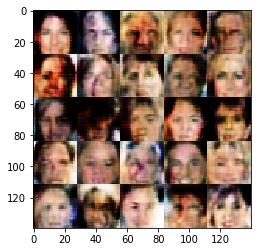

Epoch#1 progress:9.6%  dLoss:1.3823  gLoss:0.5925 
Epoch#1 progress:9.6%  dLoss:1.3025  gLoss:0.6486 
Epoch#1 progress:9.7%  dLoss:0.7308  gLoss:1.7187 
Epoch#1 progress:9.8%  dLoss:1.6931  gLoss:0.3515 
Epoch#1 progress:9.9%  dLoss:1.3268  gLoss:0.7683 
Epoch#1 progress:10.0%  dLoss:1.0076  gLoss:1.0596 
Epoch#1 progress:10.0%  dLoss:1.7624  gLoss:2.7975 
Epoch#1 progress:10.1%  dLoss:1.0744  gLoss:0.9888 
Epoch#1 progress:10.2%  dLoss:1.1582  gLoss:0.7025 
Epoch#1 progress:10.3%  dLoss:0.9717  gLoss:1.2941 


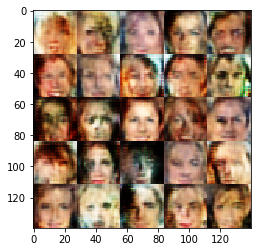

Epoch#1 progress:10.3%  dLoss:1.1490  gLoss:0.7324 
Epoch#1 progress:10.4%  dLoss:1.0576  gLoss:0.9676 
Epoch#1 progress:10.5%  dLoss:0.9714  gLoss:1.8653 
Epoch#1 progress:10.6%  dLoss:1.6019  gLoss:1.7164 
Epoch#1 progress:10.7%  dLoss:1.1671  gLoss:0.7230 
Epoch#1 progress:10.7%  dLoss:0.7670  gLoss:1.3658 
Epoch#1 progress:10.8%  dLoss:1.6009  gLoss:0.6942 
Epoch#1 progress:10.9%  dLoss:1.4373  gLoss:0.6588 
Epoch#1 progress:11.0%  dLoss:1.0198  gLoss:1.2196 
Epoch#1 progress:11.1%  dLoss:1.2862  gLoss:0.6304 


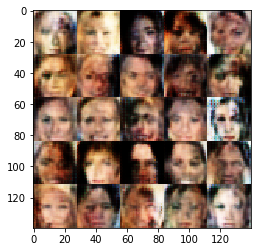

Epoch#1 progress:11.1%  dLoss:1.4036  gLoss:0.6560 
Epoch#1 progress:11.2%  dLoss:1.1613  gLoss:1.1206 
Epoch#1 progress:11.3%  dLoss:1.1859  gLoss:0.8886 
Epoch#1 progress:11.4%  dLoss:1.4324  gLoss:0.7992 
Epoch#1 progress:11.5%  dLoss:1.9235  gLoss:0.5465 
Epoch#1 progress:11.5%  dLoss:1.4014  gLoss:0.5404 
Epoch#1 progress:11.6%  dLoss:0.8740  gLoss:1.3409 
Epoch#1 progress:11.7%  dLoss:1.0191  gLoss:0.8739 
Epoch#1 progress:11.8%  dLoss:1.1976  gLoss:0.8783 
Epoch#1 progress:11.8%  dLoss:1.4677  gLoss:0.9318 


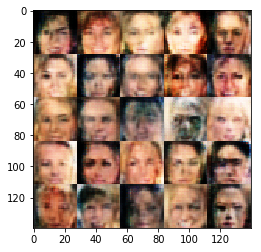

Epoch#1 progress:11.9%  dLoss:0.9908  gLoss:1.2169 
Epoch#1 progress:12.0%  dLoss:1.2617  gLoss:0.8546 
Epoch#1 progress:12.1%  dLoss:1.0765  gLoss:1.2245 
Epoch#1 progress:12.2%  dLoss:1.4294  gLoss:0.6335 
Epoch#1 progress:12.2%  dLoss:1.6772  gLoss:1.9543 
Epoch#1 progress:12.3%  dLoss:1.6214  gLoss:0.3976 
Epoch#1 progress:12.4%  dLoss:1.2865  gLoss:0.6393 
Epoch#1 progress:12.5%  dLoss:0.9490  gLoss:1.1284 
Epoch#1 progress:12.6%  dLoss:1.3314  gLoss:1.3467 
Epoch#1 progress:12.6%  dLoss:1.7488  gLoss:0.5020 


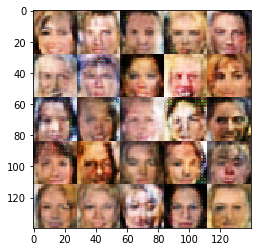

Epoch#1 progress:12.7%  dLoss:1.0869  gLoss:0.7334 
Epoch#1 progress:12.8%  dLoss:1.3161  gLoss:1.0388 
Epoch#1 progress:12.9%  dLoss:0.8497  gLoss:1.3412 
Epoch#1 progress:13.0%  dLoss:1.3984  gLoss:0.8053 
Epoch#1 progress:13.0%  dLoss:1.5388  gLoss:0.4361 
Epoch#1 progress:13.1%  dLoss:1.3073  gLoss:1.0859 
Epoch#1 progress:13.2%  dLoss:1.0474  gLoss:1.1014 
Epoch#1 progress:13.3%  dLoss:1.3487  gLoss:0.6665 
Epoch#1 progress:13.3%  dLoss:1.7978  gLoss:0.3989 
Epoch#1 progress:13.4%  dLoss:1.2366  gLoss:1.0262 


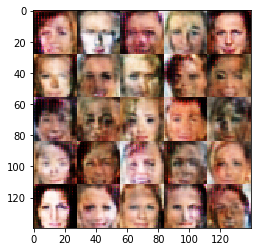

Epoch#1 progress:13.5%  dLoss:1.9507  gLoss:1.3478 
Epoch#1 progress:13.6%  dLoss:1.2019  gLoss:1.1966 
Epoch#1 progress:13.7%  dLoss:1.0733  gLoss:0.8095 
Epoch#1 progress:13.7%  dLoss:2.0835  gLoss:0.2881 
Epoch#1 progress:13.8%  dLoss:0.8514  gLoss:1.0173 
Epoch#1 progress:13.9%  dLoss:1.9981  gLoss:0.3064 
Epoch#1 progress:14.0%  dLoss:1.3923  gLoss:0.5775 
Epoch#1 progress:14.1%  dLoss:1.3152  gLoss:0.7243 
Epoch#1 progress:14.1%  dLoss:1.6838  gLoss:0.3980 
Epoch#1 progress:14.2%  dLoss:1.1998  gLoss:0.7897 


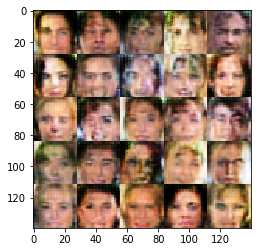

Epoch#1 progress:14.3%  dLoss:1.1693  gLoss:0.7715 
Epoch#1 progress:14.4%  dLoss:1.2845  gLoss:0.7715 
Epoch#1 progress:14.5%  dLoss:1.0862  gLoss:1.4369 
Epoch#1 progress:14.5%  dLoss:1.3357  gLoss:0.6114 
Epoch#1 progress:14.6%  dLoss:1.6236  gLoss:2.5044 
Epoch#1 progress:14.7%  dLoss:1.1048  gLoss:1.4066 
Epoch#1 progress:14.8%  dLoss:1.2352  gLoss:0.9831 
Epoch#1 progress:14.8%  dLoss:2.4129  gLoss:2.6880 
Epoch#1 progress:14.9%  dLoss:1.3970  gLoss:0.8246 
Epoch#1 progress:15.0%  dLoss:1.2994  gLoss:1.6815 


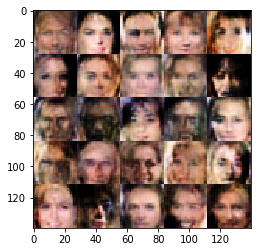

Epoch#1 progress:15.1%  dLoss:1.1572  gLoss:0.7627 
Epoch#1 progress:15.2%  dLoss:1.0330  gLoss:1.0255 
Epoch#1 progress:15.2%  dLoss:1.3480  gLoss:0.8405 
Epoch#1 progress:15.3%  dLoss:1.5940  gLoss:0.5365 
Epoch#1 progress:15.4%  dLoss:1.1958  gLoss:0.6717 
Epoch#1 progress:15.5%  dLoss:1.3425  gLoss:0.8182 
Epoch#1 progress:15.6%  dLoss:1.3214  gLoss:0.6063 
Epoch#1 progress:15.6%  dLoss:1.3199  gLoss:0.7251 
Epoch#1 progress:15.7%  dLoss:1.1233  gLoss:0.7971 
Epoch#1 progress:15.8%  dLoss:1.8180  gLoss:1.0777 


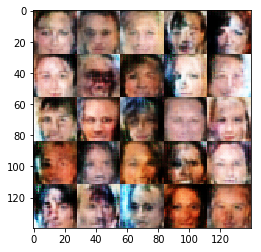

Epoch#1 progress:15.9%  dLoss:1.1374  gLoss:1.0361 
Epoch#1 progress:16.0%  dLoss:1.4212  gLoss:0.5328 
Epoch#1 progress:16.0%  dLoss:1.3346  gLoss:0.6269 
Epoch#1 progress:16.1%  dLoss:1.4754  gLoss:0.6355 
Epoch#1 progress:16.2%  dLoss:1.4573  gLoss:0.6166 
Epoch#1 progress:16.3%  dLoss:1.7015  gLoss:1.2279 
Epoch#1 progress:16.3%  dLoss:1.4284  gLoss:0.5269 
Epoch#1 progress:16.4%  dLoss:1.2660  gLoss:0.6946 
Epoch#1 progress:16.5%  dLoss:1.4333  gLoss:0.5456 
Epoch#1 progress:16.6%  dLoss:0.9896  gLoss:1.1042 


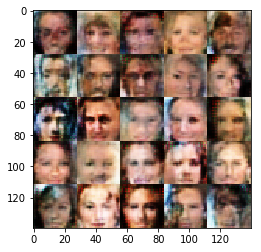

Epoch#1 progress:16.7%  dLoss:1.0720  gLoss:0.7125 
Epoch#1 progress:16.7%  dLoss:1.4384  gLoss:0.5943 
Epoch#1 progress:16.8%  dLoss:1.1339  gLoss:0.9463 
Epoch#1 progress:16.9%  dLoss:1.6585  gLoss:0.5324 
Epoch#1 progress:17.0%  dLoss:1.5943  gLoss:0.5421 
Epoch#1 progress:17.1%  dLoss:1.0486  gLoss:1.2703 
Epoch#1 progress:17.1%  dLoss:2.1889  gLoss:0.2700 
Epoch#1 progress:17.2%  dLoss:1.0783  gLoss:0.7279 
Epoch#1 progress:17.3%  dLoss:1.1825  gLoss:0.7154 
Epoch#1 progress:17.4%  dLoss:1.2837  gLoss:0.6812 


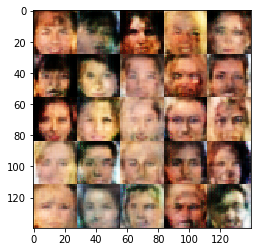

Epoch#1 progress:17.5%  dLoss:1.0764  gLoss:1.2444 
Epoch#1 progress:17.5%  dLoss:1.1639  gLoss:0.7536 
Epoch#1 progress:17.6%  dLoss:1.1469  gLoss:1.1014 
Epoch#1 progress:17.7%  dLoss:1.4058  gLoss:1.1735 
Epoch#1 progress:17.8%  dLoss:1.5065  gLoss:0.6833 
Epoch#1 progress:17.8%  dLoss:1.1461  gLoss:0.9626 
Epoch#1 progress:17.9%  dLoss:0.9939  gLoss:0.9835 
Epoch#1 progress:18.0%  dLoss:0.9796  gLoss:1.4338 
Epoch#1 progress:18.1%  dLoss:1.0960  gLoss:0.8818 
Epoch#1 progress:18.2%  dLoss:1.0436  gLoss:1.1241 


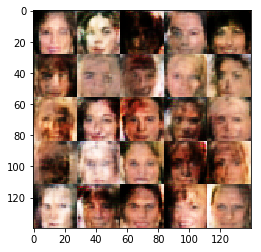

Epoch#1 progress:18.2%  dLoss:1.4297  gLoss:0.7455 
Epoch#1 progress:18.3%  dLoss:1.3770  gLoss:0.7537 
Epoch#1 progress:18.4%  dLoss:1.2795  gLoss:0.8610 
Epoch#1 progress:18.5%  dLoss:1.3581  gLoss:0.7576 
Epoch#1 progress:18.6%  dLoss:0.8409  gLoss:1.1080 
Epoch#1 progress:18.6%  dLoss:1.4623  gLoss:0.8654 
Epoch#1 progress:18.7%  dLoss:1.3454  gLoss:0.5669 
Epoch#1 progress:18.8%  dLoss:1.1278  gLoss:1.2482 
Epoch#1 progress:18.9%  dLoss:1.3133  gLoss:0.8306 
Epoch#1 progress:19.0%  dLoss:1.9362  gLoss:0.4529 


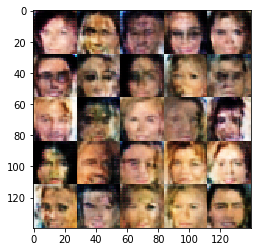

Epoch#1 progress:19.0%  dLoss:1.0047  gLoss:1.2066 
Epoch#1 progress:19.1%  dLoss:1.0644  gLoss:0.8778 
Epoch#1 progress:19.2%  dLoss:1.4418  gLoss:0.8294 
Epoch#1 progress:19.3%  dLoss:1.5881  gLoss:0.4880 
Epoch#1 progress:19.3%  dLoss:1.5729  gLoss:0.4805 
Epoch#1 progress:19.4%  dLoss:1.1642  gLoss:0.7482 
Epoch#1 progress:19.5%  dLoss:1.3829  gLoss:0.7427 
Epoch#1 progress:19.6%  dLoss:0.9571  gLoss:1.0551 
Epoch#1 progress:19.7%  dLoss:1.3479  gLoss:1.0360 
Epoch#1 progress:19.7%  dLoss:1.5558  gLoss:0.6294 


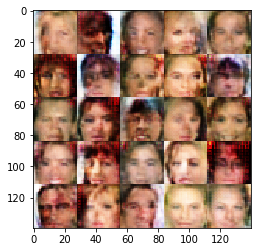

Epoch#1 progress:19.8%  dLoss:1.4095  gLoss:0.7118 
Epoch#1 progress:19.9%  dLoss:1.5193  gLoss:0.5375 
Epoch#1 progress:20.0%  dLoss:1.4073  gLoss:0.7390 
Epoch#1 progress:20.1%  dLoss:1.4040  gLoss:0.7258 
Epoch#1 progress:20.1%  dLoss:1.3469  gLoss:0.7520 
Epoch#1 progress:20.2%  dLoss:1.5002  gLoss:0.8532 
Epoch#1 progress:20.3%  dLoss:1.3699  gLoss:0.7534 
Epoch#1 progress:20.4%  dLoss:1.5477  gLoss:0.6543 
Epoch#1 progress:20.5%  dLoss:1.3228  gLoss:0.8737 
Epoch#1 progress:20.5%  dLoss:1.4919  gLoss:0.6929 


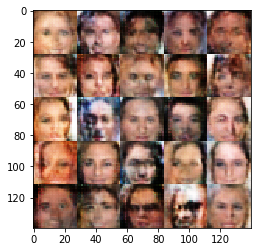

Epoch#1 progress:20.6%  dLoss:1.5494  gLoss:0.6731 
Epoch#1 progress:20.7%  dLoss:1.5061  gLoss:0.5840 
Epoch#1 progress:20.8%  dLoss:1.4379  gLoss:0.8269 
Epoch#1 progress:20.8%  dLoss:1.4042  gLoss:0.7400 
Epoch#1 progress:20.9%  dLoss:1.5265  gLoss:0.6692 
Epoch#1 progress:21.0%  dLoss:1.4233  gLoss:0.7519 
Epoch#1 progress:21.1%  dLoss:1.3155  gLoss:0.9220 
Epoch#1 progress:21.2%  dLoss:1.3800  gLoss:0.8472 
Epoch#1 progress:21.2%  dLoss:1.3489  gLoss:0.7184 
Epoch#1 progress:21.3%  dLoss:1.3415  gLoss:0.8325 


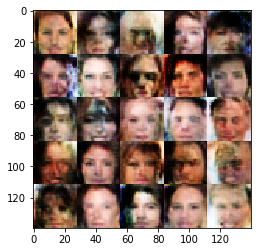

Epoch#1 progress:21.4%  dLoss:1.3925  gLoss:0.8996 
Epoch#1 progress:21.5%  dLoss:1.2889  gLoss:0.8553 
Epoch#1 progress:21.6%  dLoss:1.3330  gLoss:0.6393 
Epoch#1 progress:21.6%  dLoss:1.4280  gLoss:0.6872 
Epoch#1 progress:21.7%  dLoss:1.3190  gLoss:0.7106 
Epoch#1 progress:21.8%  dLoss:1.6090  gLoss:0.5921 
Epoch#1 progress:21.9%  dLoss:1.3364  gLoss:0.8917 
Epoch#1 progress:22.0%  dLoss:1.3626  gLoss:1.0468 
Epoch#1 progress:22.0%  dLoss:1.3704  gLoss:0.6172 
Epoch#1 progress:22.1%  dLoss:1.3589  gLoss:0.7540 


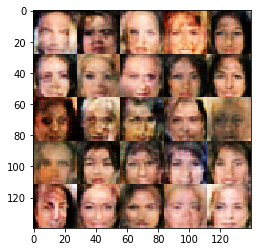

Epoch#1 progress:22.2%  dLoss:1.4176  gLoss:0.8469 
Epoch#1 progress:22.3%  dLoss:1.4222  gLoss:0.7461 
Epoch#1 progress:22.4%  dLoss:1.4307  gLoss:0.7042 
Epoch#1 progress:22.4%  dLoss:1.4553  gLoss:0.7197 
Epoch#1 progress:22.5%  dLoss:1.5189  gLoss:0.6194 
Epoch#1 progress:22.6%  dLoss:1.2598  gLoss:0.9092 
Epoch#1 progress:22.7%  dLoss:1.3724  gLoss:0.6562 
Epoch#1 progress:22.7%  dLoss:1.4355  gLoss:0.6355 
Epoch#1 progress:22.8%  dLoss:1.4650  gLoss:0.6998 
Epoch#1 progress:22.9%  dLoss:1.4398  gLoss:0.7613 


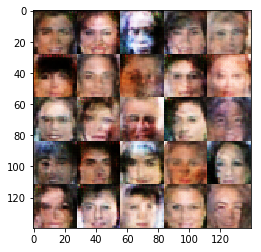

Epoch#1 progress:23.0%  dLoss:1.2839  gLoss:0.7977 
Epoch#1 progress:23.1%  dLoss:1.4207  gLoss:0.7800 
Epoch#1 progress:23.1%  dLoss:1.4316  gLoss:0.6919 
Epoch#1 progress:23.2%  dLoss:1.4253  gLoss:0.5860 
Epoch#1 progress:23.3%  dLoss:1.3403  gLoss:0.7611 
Epoch#1 progress:23.4%  dLoss:1.6851  gLoss:0.4178 
Epoch#1 progress:23.5%  dLoss:1.5257  gLoss:0.6181 
Epoch#1 progress:23.5%  dLoss:1.3971  gLoss:0.6411 
Epoch#1 progress:23.6%  dLoss:1.4214  gLoss:0.6427 
Epoch#1 progress:23.7%  dLoss:1.4179  gLoss:0.5542 


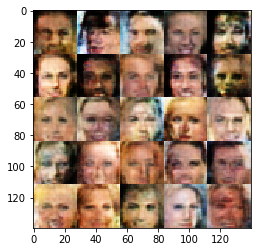

Epoch#1 progress:23.8%  dLoss:1.4993  gLoss:0.4748 
Epoch#1 progress:23.9%  dLoss:1.2992  gLoss:0.9432 
Epoch#1 progress:23.9%  dLoss:1.2506  gLoss:0.7165 
Epoch#1 progress:24.0%  dLoss:1.3124  gLoss:0.6046 
Epoch#1 progress:24.1%  dLoss:1.3649  gLoss:0.6241 
Epoch#1 progress:24.2%  dLoss:1.4821  gLoss:0.5493 
Epoch#1 progress:24.2%  dLoss:1.4304  gLoss:0.6555 
Epoch#1 progress:24.3%  dLoss:2.3926  gLoss:0.2691 
Epoch#1 progress:24.4%  dLoss:1.1736  gLoss:1.0779 
Epoch#1 progress:24.5%  dLoss:1.2700  gLoss:0.6802 


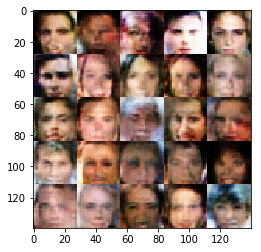

Epoch#1 progress:24.6%  dLoss:1.0050  gLoss:0.8891 
Epoch#1 progress:24.6%  dLoss:1.1278  gLoss:1.0041 
Epoch#1 progress:24.7%  dLoss:1.3891  gLoss:0.6313 
Epoch#1 progress:24.8%  dLoss:1.4826  gLoss:0.5761 
Epoch#1 progress:24.9%  dLoss:1.6653  gLoss:0.4417 
Epoch#1 progress:25.0%  dLoss:1.3559  gLoss:0.7281 
Epoch#1 progress:25.0%  dLoss:1.5611  gLoss:0.4969 
Epoch#1 progress:25.1%  dLoss:1.0852  gLoss:0.7693 
Epoch#1 progress:25.2%  dLoss:1.1875  gLoss:0.7522 
Epoch#1 progress:25.3%  dLoss:0.9862  gLoss:1.0378 


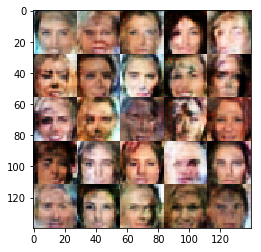

Epoch#1 progress:25.4%  dLoss:1.0868  gLoss:1.0614 
Epoch#1 progress:25.4%  dLoss:1.0542  gLoss:1.0796 
Epoch#1 progress:25.5%  dLoss:1.1709  gLoss:0.8730 
Epoch#1 progress:25.6%  dLoss:1.1190  gLoss:0.8546 
Epoch#1 progress:25.7%  dLoss:1.1271  gLoss:0.6903 
Epoch#1 progress:25.7%  dLoss:1.8465  gLoss:0.3087 
Epoch#1 progress:25.8%  dLoss:0.9090  gLoss:1.0114 
Epoch#1 progress:25.9%  dLoss:1.5754  gLoss:0.6781 
Epoch#1 progress:26.0%  dLoss:1.3837  gLoss:0.5172 
Epoch#1 progress:26.1%  dLoss:0.8212  gLoss:1.4647 


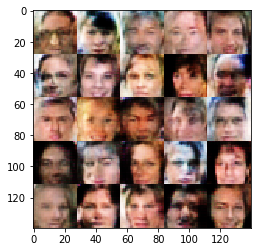

Epoch#1 progress:26.1%  dLoss:1.4732  gLoss:0.5776 
Epoch#1 progress:26.2%  dLoss:1.0897  gLoss:0.9142 
Epoch#1 progress:26.3%  dLoss:1.0652  gLoss:1.0859 
Epoch#1 progress:26.4%  dLoss:1.0242  gLoss:1.2415 
Epoch#1 progress:26.5%  dLoss:1.2574  gLoss:1.1355 
Epoch#1 progress:26.5%  dLoss:1.3864  gLoss:0.5057 
Epoch#1 progress:26.6%  dLoss:1.2797  gLoss:0.6233 
Epoch#1 progress:26.7%  dLoss:0.9928  gLoss:0.9277 
Epoch#1 progress:26.8%  dLoss:1.2423  gLoss:0.7099 
Epoch#1 progress:26.9%  dLoss:1.3287  gLoss:0.5623 


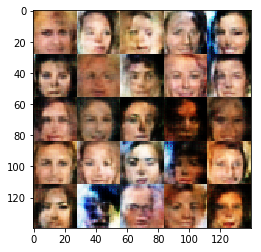

Epoch#1 progress:26.9%  dLoss:1.2763  gLoss:0.6887 
Epoch#1 progress:27.0%  dLoss:1.3202  gLoss:0.6381 
Epoch#1 progress:27.1%  dLoss:1.3392  gLoss:0.8449 
Epoch#1 progress:27.2%  dLoss:1.2608  gLoss:0.7371 
Epoch#1 progress:27.2%  dLoss:1.1893  gLoss:1.1479 
Epoch#1 progress:27.3%  dLoss:1.3179  gLoss:0.6062 
Epoch#1 progress:27.4%  dLoss:1.4072  gLoss:0.6406 
Epoch#1 progress:27.5%  dLoss:0.9579  gLoss:1.0871 
Epoch#1 progress:27.6%  dLoss:1.4297  gLoss:0.6993 
Epoch#1 progress:27.6%  dLoss:1.1827  gLoss:0.8812 


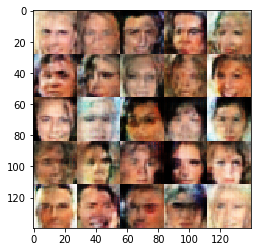

Epoch#1 progress:27.7%  dLoss:1.3607  gLoss:0.8355 
Epoch#1 progress:27.8%  dLoss:1.1266  gLoss:1.0470 
Epoch#1 progress:27.9%  dLoss:1.1140  gLoss:0.8815 
Epoch#1 progress:28.0%  dLoss:1.3683  gLoss:0.6308 
Epoch#1 progress:28.0%  dLoss:1.3922  gLoss:0.8659 
Epoch#1 progress:28.1%  dLoss:1.3346  gLoss:0.8065 
Epoch#1 progress:28.2%  dLoss:1.3190  gLoss:0.8908 
Epoch#1 progress:28.3%  dLoss:1.4654  gLoss:0.4939 
Epoch#1 progress:28.4%  dLoss:1.4769  gLoss:0.4786 
Epoch#1 progress:28.4%  dLoss:1.3843  gLoss:0.5083 


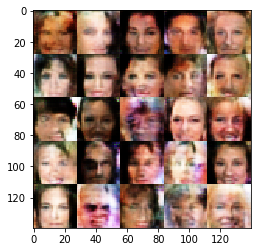

Epoch#1 progress:28.5%  dLoss:1.1830  gLoss:0.7045 
Epoch#1 progress:28.6%  dLoss:1.3920  gLoss:0.9697 
Epoch#1 progress:28.7%  dLoss:1.0901  gLoss:1.0151 
Epoch#1 progress:28.7%  dLoss:1.4280  gLoss:0.5685 
Epoch#1 progress:28.8%  dLoss:0.9506  gLoss:1.1337 
Epoch#1 progress:28.9%  dLoss:1.3041  gLoss:0.7825 
Epoch#1 progress:29.0%  dLoss:1.1702  gLoss:0.8213 
Epoch#1 progress:29.1%  dLoss:1.1075  gLoss:0.8271 
Epoch#1 progress:29.1%  dLoss:0.8461  gLoss:1.4872 
Epoch#1 progress:29.2%  dLoss:1.0955  gLoss:1.0182 


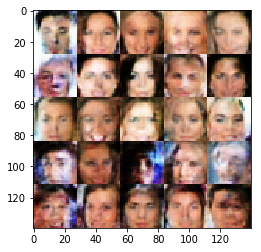

Epoch#1 progress:29.3%  dLoss:1.1594  gLoss:0.7190 
Epoch#1 progress:29.4%  dLoss:1.5407  gLoss:0.7100 
Epoch#1 progress:29.5%  dLoss:1.6991  gLoss:2.1317 
Epoch#1 progress:29.5%  dLoss:1.3451  gLoss:0.5841 
Epoch#1 progress:29.6%  dLoss:1.1130  gLoss:1.1128 
Epoch#1 progress:29.7%  dLoss:1.3264  gLoss:0.7088 
Epoch#1 progress:29.8%  dLoss:1.4368  gLoss:0.6227 
Epoch#1 progress:29.9%  dLoss:1.1539  gLoss:1.2505 
Epoch#1 progress:29.9%  dLoss:1.5845  gLoss:1.3880 
Epoch#1 progress:30.0%  dLoss:1.5085  gLoss:1.3836 


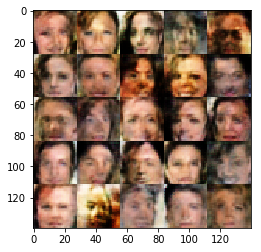

Epoch#1 progress:30.1%  dLoss:1.1018  gLoss:0.9999 
Epoch#1 progress:30.2%  dLoss:1.1686  gLoss:0.6498 
Epoch#1 progress:30.2%  dLoss:1.4613  gLoss:0.4232 
Epoch#1 progress:30.3%  dLoss:1.3139  gLoss:0.7946 
Epoch#1 progress:30.4%  dLoss:1.4222  gLoss:0.5319 
Epoch#1 progress:30.5%  dLoss:1.1939  gLoss:0.8287 
Epoch#1 progress:30.6%  dLoss:1.2891  gLoss:0.6872 
Epoch#1 progress:30.6%  dLoss:1.6911  gLoss:0.4497 
Epoch#1 progress:30.7%  dLoss:1.0124  gLoss:0.8877 
Epoch#1 progress:30.8%  dLoss:1.4406  gLoss:0.7294 


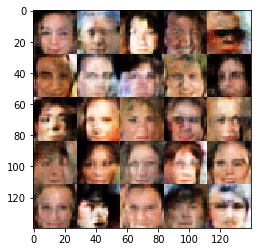

Epoch#1 progress:30.9%  dLoss:1.5712  gLoss:0.3712 
Epoch#1 progress:31.0%  dLoss:1.0380  gLoss:1.7354 
Epoch#1 progress:31.0%  dLoss:1.4899  gLoss:0.7077 
Epoch#1 progress:31.1%  dLoss:1.3047  gLoss:0.6075 
Epoch#1 progress:31.2%  dLoss:1.2535  gLoss:0.8510 
Epoch#1 progress:31.3%  dLoss:1.6865  gLoss:0.3375 
Epoch#1 progress:31.4%  dLoss:1.0012  gLoss:0.8782 
Epoch#1 progress:31.4%  dLoss:1.3870  gLoss:1.0079 
Epoch#1 progress:31.5%  dLoss:1.2714  gLoss:0.6701 
Epoch#1 progress:31.6%  dLoss:1.6292  gLoss:0.3682 


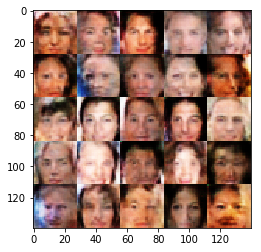

Epoch#1 progress:31.7%  dLoss:1.0416  gLoss:0.9674 
Epoch#1 progress:31.7%  dLoss:0.7980  gLoss:1.1504 
Epoch#1 progress:31.8%  dLoss:1.2002  gLoss:0.9857 
Epoch#1 progress:31.9%  dLoss:1.3960  gLoss:0.9024 
Epoch#1 progress:32.0%  dLoss:1.1902  gLoss:0.7800 
Epoch#1 progress:32.1%  dLoss:0.9685  gLoss:1.0983 
Epoch#1 progress:32.1%  dLoss:1.0171  gLoss:1.2527 
Epoch#1 progress:32.2%  dLoss:1.5140  gLoss:0.5355 
Epoch#1 progress:32.3%  dLoss:1.4797  gLoss:0.6639 
Epoch#1 progress:32.4%  dLoss:1.2716  gLoss:0.7615 


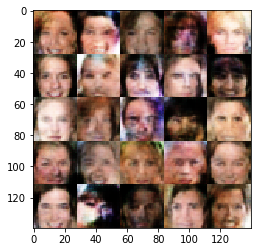

Epoch#1 progress:32.5%  dLoss:0.9491  gLoss:1.4021 
Epoch#1 progress:32.5%  dLoss:1.9858  gLoss:0.2777 
Epoch#1 progress:32.6%  dLoss:1.0687  gLoss:1.0405 
Epoch#1 progress:32.7%  dLoss:1.3542  gLoss:0.5382 
Epoch#1 progress:32.8%  dLoss:1.6383  gLoss:0.2977 
Epoch#1 progress:32.9%  dLoss:1.5022  gLoss:0.5993 
Epoch#1 progress:32.9%  dLoss:1.1260  gLoss:0.7744 
Epoch#1 progress:33.0%  dLoss:1.0889  gLoss:1.4352 
Epoch#1 progress:33.1%  dLoss:1.5006  gLoss:0.4702 
Epoch#1 progress:33.2%  dLoss:1.9131  gLoss:0.1989 


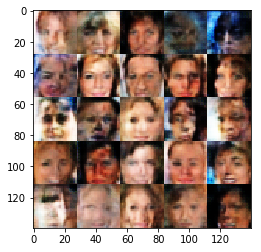

Epoch#1 progress:33.2%  dLoss:1.1715  gLoss:1.2928 
Epoch#1 progress:33.3%  dLoss:1.2340  gLoss:1.2922 
Epoch#1 progress:33.4%  dLoss:1.4201  gLoss:0.7993 
Epoch#1 progress:33.5%  dLoss:1.7394  gLoss:1.1111 
Epoch#1 progress:33.6%  dLoss:1.0461  gLoss:0.9208 
Epoch#1 progress:33.6%  dLoss:1.3325  gLoss:0.9270 
Epoch#1 progress:33.7%  dLoss:2.1488  gLoss:0.2280 
Epoch#1 progress:33.8%  dLoss:1.4951  gLoss:0.7786 
Epoch#1 progress:33.9%  dLoss:1.4059  gLoss:0.8848 
Epoch#1 progress:34.0%  dLoss:1.1124  gLoss:1.2938 


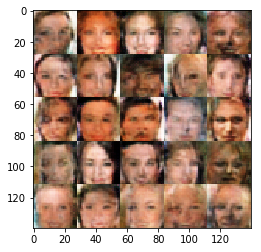

Epoch#1 progress:34.0%  dLoss:1.2848  gLoss:0.7821 
Epoch#1 progress:34.1%  dLoss:1.6886  gLoss:0.3767 
Epoch#1 progress:34.2%  dLoss:0.7558  gLoss:1.4428 
Epoch#1 progress:34.3%  dLoss:1.1585  gLoss:1.0358 
Epoch#1 progress:34.4%  dLoss:1.3002  gLoss:1.5501 
Epoch#1 progress:34.4%  dLoss:1.2749  gLoss:0.7352 
Epoch#1 progress:34.5%  dLoss:1.0473  gLoss:0.7622 
Epoch#1 progress:34.6%  dLoss:1.3063  gLoss:1.4428 
Epoch#1 progress:34.7%  dLoss:1.8426  gLoss:0.3505 
Epoch#1 progress:34.7%  dLoss:1.1919  gLoss:0.6969 


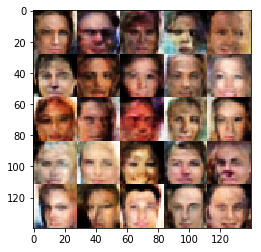

Epoch#1 progress:34.8%  dLoss:1.4834  gLoss:0.5027 
Epoch#1 progress:34.9%  dLoss:1.1171  gLoss:0.8769 
Epoch#1 progress:35.0%  dLoss:1.7930  gLoss:1.4888 
Epoch#1 progress:35.1%  dLoss:1.1705  gLoss:0.7366 
Epoch#1 progress:35.1%  dLoss:1.4988  gLoss:0.6117 
Epoch#1 progress:35.2%  dLoss:1.2685  gLoss:0.6387 
Epoch#1 progress:35.3%  dLoss:1.3301  gLoss:0.6487 
Epoch#1 progress:35.4%  dLoss:1.5318  gLoss:0.5596 
Epoch#1 progress:35.5%  dLoss:1.2682  gLoss:0.5131 
Epoch#1 progress:35.5%  dLoss:1.1733  gLoss:0.7489 


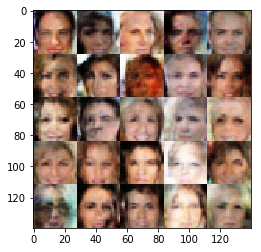

Epoch#1 progress:35.6%  dLoss:1.2840  gLoss:0.5959 
Epoch#1 progress:35.7%  dLoss:1.4457  gLoss:0.5871 
Epoch#1 progress:35.8%  dLoss:1.0207  gLoss:1.0079 
Epoch#1 progress:35.9%  dLoss:1.5231  gLoss:0.5669 
Epoch#1 progress:35.9%  dLoss:1.5356  gLoss:0.5616 
Epoch#1 progress:36.0%  dLoss:1.5816  gLoss:0.7622 
Epoch#1 progress:36.1%  dLoss:1.4666  gLoss:0.4723 
Epoch#1 progress:36.2%  dLoss:1.5060  gLoss:0.3907 
Epoch#1 progress:36.3%  dLoss:1.6945  gLoss:0.4018 
Epoch#1 progress:36.3%  dLoss:1.2568  gLoss:0.9560 


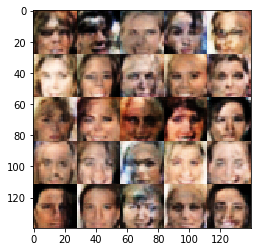

Epoch#1 progress:36.4%  dLoss:1.7581  gLoss:0.3638 
Epoch#1 progress:36.5%  dLoss:1.5744  gLoss:1.7442 
Epoch#1 progress:36.6%  dLoss:1.4000  gLoss:0.4939 
Epoch#1 progress:36.6%  dLoss:1.2545  gLoss:0.6931 
Epoch#1 progress:36.7%  dLoss:1.4959  gLoss:0.4038 
Epoch#1 progress:36.8%  dLoss:1.1004  gLoss:0.8394 
Epoch#1 progress:36.9%  dLoss:1.3423  gLoss:0.5838 
Epoch#1 progress:37.0%  dLoss:1.5085  gLoss:0.5344 
Epoch#1 progress:37.0%  dLoss:1.1264  gLoss:1.2771 
Epoch#1 progress:37.1%  dLoss:1.0755  gLoss:1.0473 


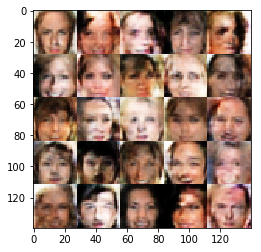

Epoch#1 progress:37.2%  dLoss:1.6326  gLoss:0.5472 
Epoch#1 progress:37.3%  dLoss:1.1050  gLoss:0.9983 
Epoch#1 progress:37.4%  dLoss:1.1518  gLoss:0.7862 
Epoch#1 progress:37.4%  dLoss:0.9945  gLoss:1.1020 
Epoch#1 progress:37.5%  dLoss:1.2323  gLoss:0.6582 
Epoch#1 progress:37.6%  dLoss:1.0471  gLoss:0.7717 
Epoch#1 progress:37.7%  dLoss:1.1974  gLoss:0.6065 
Epoch#1 progress:37.8%  dLoss:1.1080  gLoss:1.3469 
Epoch#1 progress:37.8%  dLoss:1.4038  gLoss:0.7470 
Epoch#1 progress:37.9%  dLoss:1.2119  gLoss:0.7722 


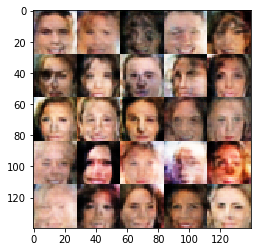

Epoch#1 progress:38.0%  dLoss:1.4005  gLoss:0.5249 
Epoch#1 progress:38.1%  dLoss:1.4141  gLoss:0.5935 
Epoch#1 progress:38.1%  dLoss:1.6239  gLoss:0.6144 
Epoch#1 progress:38.2%  dLoss:1.6408  gLoss:0.4345 
Epoch#1 progress:38.3%  dLoss:1.3200  gLoss:0.6897 
Epoch#1 progress:38.4%  dLoss:1.2216  gLoss:0.6713 
Epoch#1 progress:38.5%  dLoss:1.3374  gLoss:0.7268 
Epoch#1 progress:38.5%  dLoss:1.1721  gLoss:0.9486 
Epoch#1 progress:38.6%  dLoss:1.0258  gLoss:0.9221 
Epoch#1 progress:38.7%  dLoss:1.5408  gLoss:0.7527 


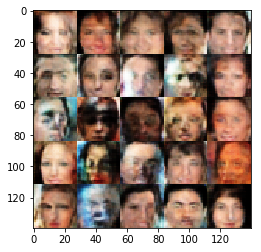

Epoch#1 progress:38.8%  dLoss:1.8322  gLoss:0.4265 
Epoch#1 progress:38.9%  dLoss:1.2828  gLoss:0.6085 
Epoch#1 progress:38.9%  dLoss:1.2558  gLoss:0.6835 
Epoch#1 progress:39.0%  dLoss:1.2652  gLoss:0.9402 
Epoch#1 progress:39.1%  dLoss:1.0456  gLoss:0.9884 
Epoch#1 progress:39.2%  dLoss:1.1229  gLoss:0.7894 
Epoch#1 progress:39.3%  dLoss:1.5632  gLoss:1.0886 
Epoch#1 progress:39.3%  dLoss:0.9829  gLoss:1.0607 
Epoch#1 progress:39.4%  dLoss:1.2131  gLoss:1.9181 
Epoch#1 progress:39.5%  dLoss:1.0912  gLoss:1.1422 


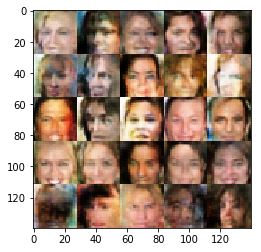

Epoch#1 progress:39.6%  dLoss:1.6490  gLoss:0.9027 
Epoch#1 progress:39.6%  dLoss:1.0298  gLoss:1.0605 
Epoch#1 progress:39.7%  dLoss:1.3087  gLoss:0.5784 
Epoch#1 progress:39.8%  dLoss:1.1170  gLoss:0.9058 
Epoch#1 progress:39.9%  dLoss:1.1811  gLoss:0.9484 
Epoch#1 progress:40.0%  dLoss:1.1064  gLoss:0.7975 
Epoch#1 progress:40.0%  dLoss:1.1338  gLoss:1.1017 
Epoch#1 progress:40.1%  dLoss:0.9582  gLoss:1.1189 
Epoch#1 progress:40.2%  dLoss:1.0150  gLoss:1.1507 
Epoch#1 progress:40.3%  dLoss:0.9454  gLoss:1.0515 


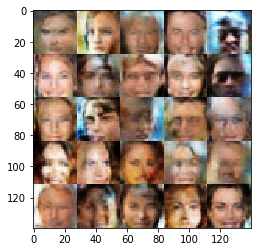

Epoch#1 progress:40.4%  dLoss:1.3666  gLoss:0.4888 
Epoch#1 progress:40.4%  dLoss:1.3741  gLoss:0.5827 
Epoch#1 progress:40.5%  dLoss:2.0352  gLoss:0.2401 
Epoch#1 progress:40.6%  dLoss:1.5731  gLoss:0.6584 
Epoch#1 progress:40.7%  dLoss:1.5950  gLoss:0.5797 
Epoch#1 progress:40.8%  dLoss:1.6622  gLoss:0.4873 
Epoch#1 progress:40.8%  dLoss:1.5287  gLoss:0.5354 
Epoch#1 progress:40.9%  dLoss:0.8805  gLoss:1.1010 
Epoch#1 progress:41.0%  dLoss:1.1240  gLoss:1.2440 
Epoch#1 progress:41.1%  dLoss:1.3868  gLoss:0.5885 


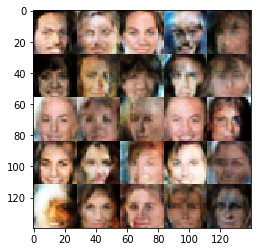

Epoch#1 progress:41.1%  dLoss:0.9754  gLoss:0.8337 
Epoch#1 progress:41.2%  dLoss:1.2535  gLoss:0.6729 
Epoch#1 progress:41.3%  dLoss:1.8351  gLoss:0.8764 
Epoch#1 progress:41.4%  dLoss:1.5040  gLoss:0.7772 
Epoch#1 progress:41.5%  dLoss:1.1390  gLoss:0.9075 
Epoch#1 progress:41.5%  dLoss:1.0548  gLoss:0.9310 
Epoch#1 progress:41.6%  dLoss:1.0856  gLoss:1.0388 
Epoch#1 progress:41.7%  dLoss:1.2048  gLoss:0.6381 
Epoch#1 progress:41.8%  dLoss:1.1944  gLoss:1.0823 
Epoch#1 progress:41.9%  dLoss:1.2686  gLoss:0.7074 


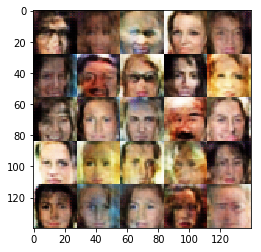

Epoch#1 progress:41.9%  dLoss:1.3513  gLoss:0.6407 
Epoch#1 progress:42.0%  dLoss:1.4326  gLoss:0.7356 
Epoch#1 progress:42.1%  dLoss:1.2486  gLoss:0.6122 
Epoch#1 progress:42.2%  dLoss:1.3566  gLoss:0.8780 
Epoch#1 progress:42.3%  dLoss:1.1682  gLoss:0.9176 
Epoch#1 progress:42.3%  dLoss:1.3790  gLoss:0.4718 
Epoch#1 progress:42.4%  dLoss:1.2983  gLoss:0.7771 
Epoch#1 progress:42.5%  dLoss:1.2326  gLoss:1.2139 
Epoch#1 progress:42.6%  dLoss:1.3612  gLoss:0.5911 
Epoch#1 progress:42.6%  dLoss:1.5363  gLoss:0.7904 


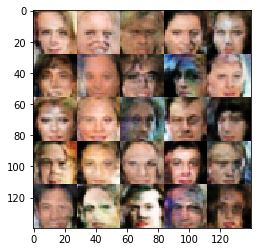

Epoch#1 progress:42.7%  dLoss:1.2471  gLoss:1.2468 
Epoch#1 progress:42.8%  dLoss:1.1389  gLoss:0.9169 
Epoch#1 progress:42.9%  dLoss:1.5357  gLoss:0.9042 
Epoch#1 progress:43.0%  dLoss:1.5414  gLoss:0.5367 
Epoch#1 progress:43.0%  dLoss:1.7605  gLoss:1.1909 
Epoch#1 progress:43.1%  dLoss:1.4659  gLoss:0.5046 
Epoch#1 progress:43.2%  dLoss:1.8410  gLoss:1.5421 
Epoch#1 progress:43.3%  dLoss:1.0718  gLoss:0.9677 
Epoch#1 progress:43.4%  dLoss:1.5265  gLoss:0.5985 
Epoch#1 progress:43.4%  dLoss:1.4273  gLoss:0.8450 


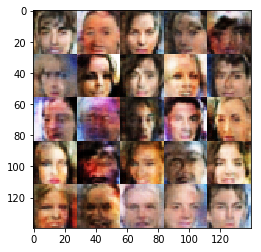

Epoch#1 progress:43.5%  dLoss:1.2044  gLoss:0.7279 
Epoch#1 progress:43.6%  dLoss:1.3051  gLoss:0.6448 
Epoch#1 progress:43.7%  dLoss:1.3869  gLoss:0.6449 
Epoch#1 progress:43.8%  dLoss:1.5046  gLoss:0.6156 
Epoch#1 progress:43.8%  dLoss:1.3851  gLoss:0.7757 
Epoch#1 progress:43.9%  dLoss:1.4899  gLoss:0.5464 
Epoch#1 progress:44.0%  dLoss:1.6164  gLoss:0.4289 
Epoch#1 progress:44.1%  dLoss:1.3792  gLoss:0.7112 
Epoch#1 progress:44.1%  dLoss:1.2585  gLoss:1.2572 
Epoch#1 progress:44.2%  dLoss:1.4541  gLoss:0.8597 


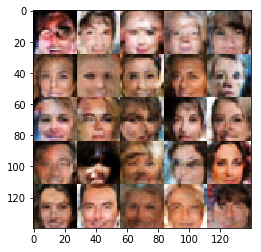

Epoch#1 progress:44.3%  dLoss:1.1657  gLoss:0.7767 
Epoch#1 progress:44.4%  dLoss:0.9418  gLoss:0.9674 
Epoch#1 progress:44.5%  dLoss:1.2847  gLoss:0.6184 
Epoch#1 progress:44.5%  dLoss:1.5204  gLoss:0.7522 
Epoch#1 progress:44.6%  dLoss:1.2765  gLoss:0.6127 
Epoch#1 progress:44.7%  dLoss:1.6121  gLoss:0.4885 
Epoch#1 progress:44.8%  dLoss:1.3293  gLoss:0.8482 
Epoch#1 progress:44.9%  dLoss:1.4574  gLoss:0.5504 
Epoch#1 progress:44.9%  dLoss:1.4147  gLoss:0.6670 
Epoch#1 progress:45.0%  dLoss:1.6081  gLoss:0.4352 


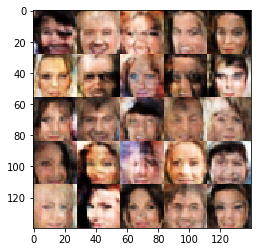

Epoch#1 progress:45.1%  dLoss:1.9814  gLoss:0.2913 
Epoch#1 progress:45.2%  dLoss:1.3479  gLoss:0.6681 
Epoch#1 progress:45.3%  dLoss:1.0403  gLoss:0.8583 
Epoch#1 progress:45.3%  dLoss:1.4863  gLoss:0.7186 
Epoch#1 progress:45.4%  dLoss:1.3773  gLoss:0.9945 
Epoch#1 progress:45.5%  dLoss:1.3288  gLoss:0.8263 
Epoch#1 progress:45.6%  dLoss:1.5200  gLoss:0.4597 
Epoch#1 progress:45.6%  dLoss:1.4668  gLoss:0.6386 
Epoch#1 progress:45.7%  dLoss:1.4308  gLoss:1.0567 
Epoch#1 progress:45.8%  dLoss:1.1208  gLoss:0.8644 


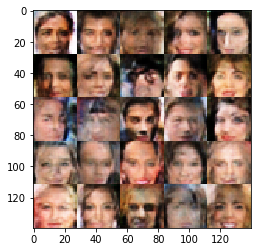

Epoch#1 progress:45.9%  dLoss:1.1923  gLoss:1.0184 
Epoch#1 progress:46.0%  dLoss:1.1770  gLoss:0.7817 
Epoch#1 progress:46.0%  dLoss:1.3288  gLoss:0.8083 
Epoch#1 progress:46.1%  dLoss:1.5463  gLoss:0.4693 
Epoch#1 progress:46.2%  dLoss:1.3205  gLoss:0.7040 
Epoch#1 progress:46.3%  dLoss:1.2168  gLoss:0.9404 
Epoch#1 progress:46.4%  dLoss:1.3041  gLoss:0.9683 
Epoch#1 progress:46.4%  dLoss:1.5294  gLoss:0.6634 
Epoch#1 progress:46.5%  dLoss:1.3403  gLoss:0.9869 
Epoch#1 progress:46.6%  dLoss:1.5451  gLoss:0.5034 


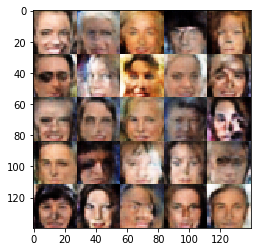

Epoch#1 progress:46.7%  dLoss:1.2495  gLoss:0.9378 
Epoch#1 progress:46.8%  dLoss:1.2770  gLoss:1.2152 
Epoch#1 progress:46.8%  dLoss:1.5493  gLoss:0.4629 
Epoch#1 progress:46.9%  dLoss:1.5236  gLoss:0.4792 
Epoch#1 progress:47.0%  dLoss:1.2335  gLoss:0.8031 
Epoch#1 progress:47.1%  dLoss:1.4069  gLoss:0.5837 
Epoch#1 progress:47.1%  dLoss:1.2422  gLoss:0.6897 
Epoch#1 progress:47.2%  dLoss:1.4444  gLoss:0.5462 
Epoch#1 progress:47.3%  dLoss:1.1951  gLoss:0.7651 
Epoch#1 progress:47.4%  dLoss:1.7726  gLoss:0.3052 


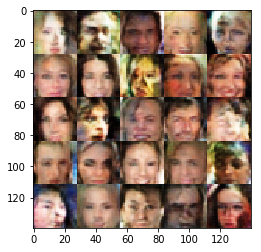

Epoch#1 progress:47.5%  dLoss:1.4453  gLoss:0.5578 
Epoch#1 progress:47.5%  dLoss:1.6324  gLoss:0.5431 
Epoch#1 progress:47.6%  dLoss:0.7902  gLoss:1.3090 
Epoch#1 progress:47.7%  dLoss:1.3005  gLoss:0.7364 
Epoch#1 progress:47.8%  dLoss:1.6156  gLoss:0.5809 
Epoch#1 progress:47.9%  dLoss:1.2639  gLoss:0.8154 
Epoch#1 progress:47.9%  dLoss:1.3385  gLoss:0.6147 
Epoch#1 progress:48.0%  dLoss:1.4461  gLoss:0.7179 
Epoch#1 progress:48.1%  dLoss:1.2895  gLoss:0.8133 
Epoch#1 progress:48.2%  dLoss:1.2678  gLoss:1.0797 


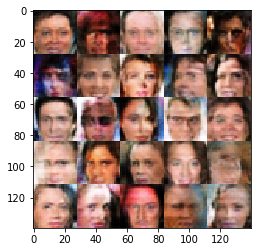

Epoch#1 progress:48.3%  dLoss:1.1569  gLoss:0.9291 
Epoch#1 progress:48.3%  dLoss:1.4555  gLoss:0.6374 
Epoch#1 progress:48.4%  dLoss:1.2446  gLoss:0.8889 
Epoch#1 progress:48.5%  dLoss:1.0480  gLoss:0.8751 
Epoch#1 progress:48.6%  dLoss:1.3735  gLoss:0.5621 
Epoch#1 progress:48.6%  dLoss:1.2452  gLoss:0.7028 
Epoch#1 progress:48.7%  dLoss:1.3608  gLoss:0.6248 
Epoch#1 progress:48.8%  dLoss:1.4532  gLoss:0.5320 
Epoch#1 progress:48.9%  dLoss:1.2012  gLoss:1.2771 
Epoch#1 progress:49.0%  dLoss:1.5998  gLoss:0.5074 


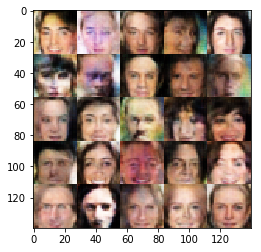

Epoch#1 progress:49.0%  dLoss:1.3611  gLoss:0.9440 
Epoch#1 progress:49.1%  dLoss:1.3447  gLoss:0.6693 
Epoch#1 progress:49.2%  dLoss:1.2345  gLoss:0.6789 
Epoch#1 progress:49.3%  dLoss:1.4350  gLoss:1.0018 
Epoch#1 progress:49.4%  dLoss:1.4271  gLoss:0.5472 
Epoch#1 progress:49.4%  dLoss:1.3847  gLoss:0.8823 
Epoch#1 progress:49.5%  dLoss:1.3145  gLoss:0.5800 
Epoch#1 progress:49.6%  dLoss:1.2941  gLoss:0.6641 
Epoch#1 progress:49.7%  dLoss:1.3071  gLoss:0.8287 
Epoch#1 progress:49.8%  dLoss:1.0353  gLoss:1.0733 


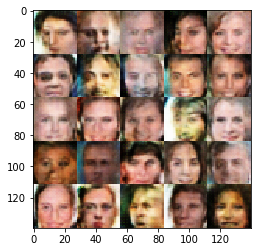

Epoch#1 progress:49.8%  dLoss:1.7122  gLoss:0.4702 
Epoch#1 progress:49.9%  dLoss:1.5100  gLoss:0.5002 
Epoch#1 progress:50.0%  dLoss:1.3522  gLoss:0.6959 
Epoch#1 progress:50.1%  dLoss:1.2873  gLoss:1.0378 
Epoch#1 progress:50.2%  dLoss:1.1233  gLoss:1.0825 
Epoch#1 progress:50.2%  dLoss:1.1345  gLoss:0.9611 
Epoch#1 progress:50.3%  dLoss:1.6857  gLoss:0.3062 
Epoch#1 progress:50.4%  dLoss:1.4548  gLoss:0.5078 
Epoch#1 progress:50.5%  dLoss:1.5557  gLoss:0.5473 
Epoch#1 progress:50.5%  dLoss:1.2624  gLoss:1.2767 


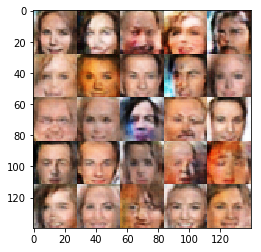

Epoch#1 progress:50.6%  dLoss:1.4838  gLoss:0.6078 
Epoch#1 progress:50.7%  dLoss:1.5158  gLoss:0.5842 
Epoch#1 progress:50.8%  dLoss:1.6273  gLoss:0.5139 
Epoch#1 progress:50.9%  dLoss:1.0674  gLoss:1.0007 
Epoch#1 progress:50.9%  dLoss:1.3180  gLoss:0.6655 
Epoch#1 progress:51.0%  dLoss:1.1166  gLoss:1.0939 
Epoch#1 progress:51.1%  dLoss:1.7197  gLoss:0.4694 
Epoch#1 progress:51.2%  dLoss:1.5155  gLoss:0.6685 
Epoch#1 progress:51.3%  dLoss:1.4470  gLoss:0.5380 
Epoch#1 progress:51.3%  dLoss:1.3736  gLoss:0.5488 


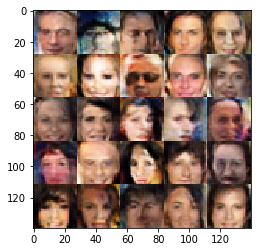

Epoch#1 progress:51.4%  dLoss:1.7576  gLoss:0.4851 
Epoch#1 progress:51.5%  dLoss:1.2249  gLoss:0.7732 
Epoch#1 progress:51.6%  dLoss:1.4294  gLoss:0.9738 
Epoch#1 progress:51.7%  dLoss:1.2775  gLoss:1.1122 
Epoch#1 progress:51.7%  dLoss:1.2715  gLoss:0.9012 
Epoch#1 progress:51.8%  dLoss:1.4284  gLoss:0.5506 
Epoch#1 progress:51.9%  dLoss:1.3254  gLoss:0.8269 
Epoch#1 progress:52.0%  dLoss:1.7991  gLoss:0.2854 
Epoch#1 progress:52.0%  dLoss:1.3920  gLoss:0.7644 
Epoch#1 progress:52.1%  dLoss:1.0485  gLoss:0.9505 


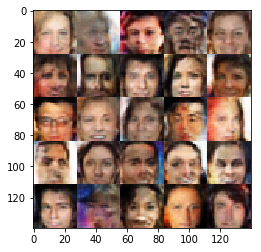

Epoch#1 progress:52.2%  dLoss:1.4433  gLoss:0.5083 
Epoch#1 progress:52.3%  dLoss:1.2156  gLoss:0.6828 
Epoch#1 progress:52.4%  dLoss:1.3558  gLoss:0.9249 
Epoch#1 progress:52.4%  dLoss:1.4928  gLoss:0.5958 
Epoch#1 progress:52.5%  dLoss:1.2441  gLoss:0.7425 
Epoch#1 progress:52.6%  dLoss:1.3544  gLoss:0.5429 
Epoch#1 progress:52.7%  dLoss:1.4588  gLoss:0.4478 
Epoch#1 progress:52.8%  dLoss:1.2908  gLoss:0.9867 
Epoch#1 progress:52.8%  dLoss:1.1580  gLoss:1.2125 
Epoch#1 progress:52.9%  dLoss:1.4800  gLoss:0.4523 


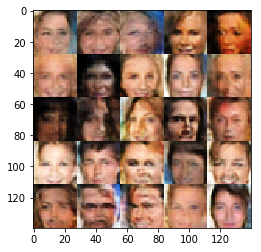

Epoch#1 progress:53.0%  dLoss:1.4229  gLoss:0.6176 
Epoch#1 progress:53.1%  dLoss:1.3454  gLoss:0.6573 
Epoch#1 progress:53.2%  dLoss:1.3595  gLoss:0.6138 
Epoch#1 progress:53.2%  dLoss:1.5343  gLoss:0.4357 
Epoch#1 progress:53.3%  dLoss:1.6274  gLoss:0.4701 
Epoch#1 progress:53.4%  dLoss:1.6409  gLoss:0.4675 
Epoch#1 progress:53.5%  dLoss:1.2947  gLoss:0.7678 
Epoch#1 progress:53.5%  dLoss:1.3210  gLoss:0.8772 
Epoch#1 progress:53.6%  dLoss:1.5661  gLoss:0.5851 
Epoch#1 progress:53.7%  dLoss:1.3747  gLoss:0.8496 


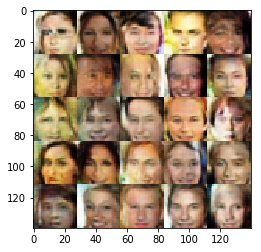

Epoch#1 progress:53.8%  dLoss:1.5199  gLoss:0.4026 
Epoch#1 progress:53.9%  dLoss:1.4499  gLoss:0.5888 
Epoch#1 progress:53.9%  dLoss:1.4506  gLoss:0.6545 
Epoch#1 progress:54.0%  dLoss:1.2717  gLoss:0.7407 
Epoch#1 progress:54.1%  dLoss:1.7761  gLoss:0.3558 
Epoch#1 progress:54.2%  dLoss:1.5633  gLoss:0.8596 
Epoch#1 progress:54.3%  dLoss:1.1734  gLoss:1.0412 
Epoch#1 progress:54.3%  dLoss:1.5409  gLoss:0.4971 
Epoch#1 progress:54.4%  dLoss:1.3298  gLoss:0.5738 
Epoch#1 progress:54.5%  dLoss:1.2978  gLoss:0.5428 


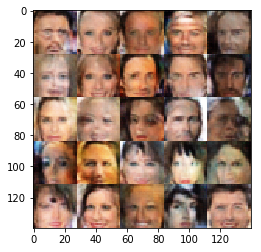

Epoch#1 progress:54.6%  dLoss:1.4685  gLoss:0.5303 
Epoch#1 progress:54.7%  dLoss:1.0075  gLoss:1.0408 
Epoch#1 progress:54.7%  dLoss:1.9655  gLoss:0.3395 
Epoch#1 progress:54.8%  dLoss:1.5979  gLoss:0.9857 
Epoch#1 progress:54.9%  dLoss:1.2656  gLoss:0.7028 
Epoch#1 progress:55.0%  dLoss:1.2384  gLoss:0.8157 
Epoch#1 progress:55.0%  dLoss:1.7984  gLoss:0.4263 
Epoch#1 progress:55.1%  dLoss:0.9153  gLoss:1.5635 
Epoch#1 progress:55.2%  dLoss:1.5808  gLoss:0.4784 
Epoch#1 progress:55.3%  dLoss:1.3524  gLoss:0.6065 


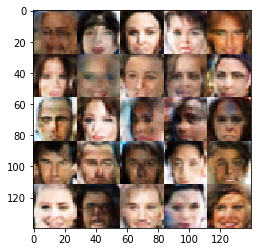

Epoch#1 progress:55.4%  dLoss:1.5804  gLoss:0.5097 
Epoch#1 progress:55.4%  dLoss:1.6193  gLoss:0.5949 
Epoch#1 progress:55.5%  dLoss:1.5328  gLoss:0.6102 
Epoch#1 progress:55.6%  dLoss:1.3315  gLoss:0.6090 
Epoch#1 progress:55.7%  dLoss:1.5411  gLoss:0.4245 
Epoch#1 progress:55.8%  dLoss:1.8009  gLoss:0.3968 
Epoch#1 progress:55.8%  dLoss:1.3307  gLoss:0.5776 
Epoch#1 progress:55.9%  dLoss:1.3261  gLoss:0.7633 
Epoch#1 progress:56.0%  dLoss:1.5085  gLoss:0.5714 
Epoch#1 progress:56.1%  dLoss:1.5240  gLoss:0.4340 


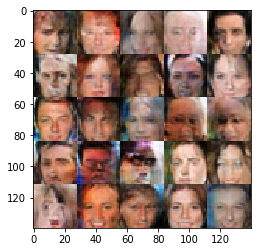

Epoch#1 progress:56.2%  dLoss:1.1530  gLoss:0.8358 
Epoch#1 progress:56.2%  dLoss:1.4439  gLoss:0.5472 
Epoch#1 progress:56.3%  dLoss:1.1938  gLoss:0.8518 
Epoch#1 progress:56.4%  dLoss:1.4484  gLoss:0.8090 
Epoch#1 progress:56.5%  dLoss:1.2757  gLoss:1.1235 
Epoch#1 progress:56.5%  dLoss:1.5572  gLoss:0.3800 
Epoch#1 progress:56.6%  dLoss:1.2098  gLoss:0.7622 
Epoch#1 progress:56.7%  dLoss:1.0377  gLoss:0.8923 
Epoch#1 progress:56.8%  dLoss:1.5347  gLoss:0.4775 
Epoch#1 progress:56.9%  dLoss:1.2480  gLoss:0.6764 


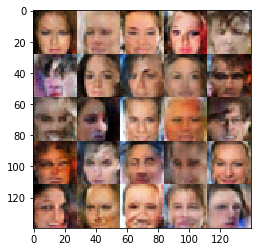

Epoch#1 progress:56.9%  dLoss:1.5440  gLoss:0.5089 
Epoch#1 progress:57.0%  dLoss:1.5992  gLoss:0.4351 
Epoch#1 progress:57.1%  dLoss:1.3948  gLoss:0.6272 
Epoch#1 progress:57.2%  dLoss:1.5761  gLoss:0.4365 
Epoch#1 progress:57.3%  dLoss:1.5847  gLoss:0.5555 
Epoch#1 progress:57.3%  dLoss:1.5023  gLoss:0.5099 
Epoch#1 progress:57.4%  dLoss:1.0805  gLoss:0.9776 
Epoch#1 progress:57.5%  dLoss:1.2871  gLoss:0.5399 
Epoch#1 progress:57.6%  dLoss:1.3612  gLoss:0.6099 
Epoch#1 progress:57.7%  dLoss:1.2168  gLoss:0.7238 


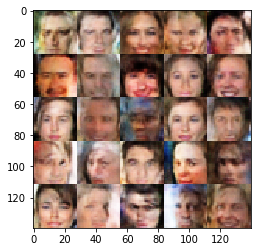

Epoch#1 progress:57.7%  dLoss:1.2211  gLoss:0.7315 
Epoch#1 progress:57.8%  dLoss:1.6735  gLoss:0.5187 
Epoch#1 progress:57.9%  dLoss:1.4686  gLoss:0.6153 
Epoch#1 progress:58.0%  dLoss:1.2233  gLoss:1.0983 
Epoch#1 progress:58.0%  dLoss:1.4251  gLoss:0.5412 
Epoch#1 progress:58.1%  dLoss:1.6243  gLoss:0.4687 
Epoch#1 progress:58.2%  dLoss:1.3697  gLoss:0.5681 
Epoch#1 progress:58.3%  dLoss:1.4152  gLoss:0.6068 
Epoch#1 progress:58.4%  dLoss:1.7429  gLoss:0.4607 
Epoch#1 progress:58.4%  dLoss:1.4837  gLoss:0.6121 


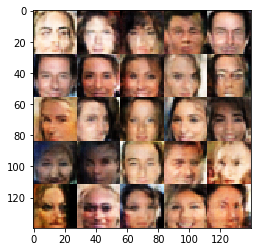

Epoch#1 progress:58.5%  dLoss:1.8212  gLoss:0.9595 
Epoch#1 progress:58.6%  dLoss:1.4282  gLoss:0.6816 
Epoch#1 progress:58.7%  dLoss:1.5778  gLoss:0.4988 
Epoch#1 progress:58.8%  dLoss:1.4408  gLoss:0.4838 
Epoch#1 progress:58.8%  dLoss:1.4978  gLoss:0.4703 
Epoch#1 progress:58.9%  dLoss:1.0595  gLoss:1.0510 
Epoch#1 progress:59.0%  dLoss:1.0882  gLoss:0.8607 
Epoch#1 progress:59.1%  dLoss:1.3894  gLoss:0.5916 
Epoch#1 progress:59.2%  dLoss:1.2041  gLoss:0.7719 
Epoch#1 progress:59.2%  dLoss:1.2742  gLoss:0.6867 


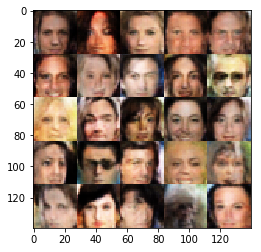

Epoch#1 progress:59.3%  dLoss:1.6028  gLoss:0.5652 
Epoch#1 progress:59.4%  dLoss:1.2323  gLoss:0.6590 
Epoch#1 progress:59.5%  dLoss:1.1309  gLoss:0.9282 
Epoch#1 progress:59.5%  dLoss:1.4454  gLoss:0.5199 
Epoch#1 progress:59.6%  dLoss:1.7255  gLoss:0.3899 
Epoch#1 progress:59.7%  dLoss:1.3746  gLoss:0.4994 
Epoch#1 progress:59.8%  dLoss:1.3558  gLoss:0.6204 
Epoch#1 progress:59.9%  dLoss:1.1670  gLoss:1.1631 
Epoch#1 progress:59.9%  dLoss:1.4005  gLoss:0.5617 
Epoch#1 progress:60.0%  dLoss:1.9641  gLoss:0.4367 


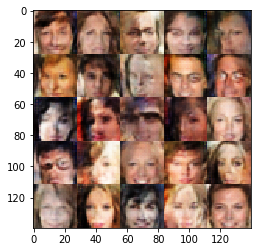

Epoch#1 progress:60.1%  dLoss:1.4730  gLoss:0.6037 
Epoch#1 progress:60.2%  dLoss:1.4191  gLoss:0.6959 
Epoch#1 progress:60.3%  dLoss:1.2568  gLoss:0.6269 
Epoch#1 progress:60.3%  dLoss:1.3496  gLoss:0.6241 
Epoch#1 progress:60.4%  dLoss:1.4179  gLoss:0.6224 
Epoch#1 progress:60.5%  dLoss:1.4539  gLoss:0.6680 
Epoch#1 progress:60.6%  dLoss:1.4102  gLoss:0.7033 
Epoch#1 progress:60.7%  dLoss:1.4021  gLoss:0.6205 
Epoch#1 progress:60.7%  dLoss:1.6577  gLoss:0.3983 
Epoch#1 progress:60.8%  dLoss:1.4323  gLoss:0.8177 


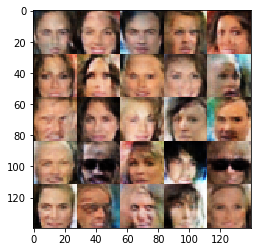

Epoch#1 progress:60.9%  dLoss:1.1026  gLoss:0.8516 
Epoch#1 progress:61.0%  dLoss:1.3059  gLoss:0.7845 
Epoch#1 progress:61.0%  dLoss:1.2141  gLoss:0.8819 
Epoch#1 progress:61.1%  dLoss:1.6672  gLoss:0.4894 
Epoch#1 progress:61.2%  dLoss:1.3007  gLoss:0.8630 
Epoch#1 progress:61.3%  dLoss:1.3348  gLoss:0.6160 
Epoch#1 progress:61.4%  dLoss:1.4120  gLoss:1.0596 
Epoch#1 progress:61.4%  dLoss:1.6906  gLoss:0.4086 
Epoch#1 progress:61.5%  dLoss:1.6979  gLoss:0.3863 
Epoch#1 progress:61.6%  dLoss:1.2662  gLoss:0.7007 


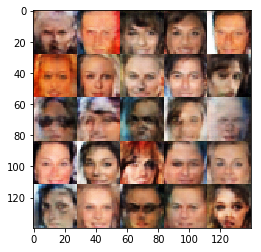

Epoch#1 progress:61.7%  dLoss:1.4183  gLoss:0.7927 
Epoch#1 progress:61.8%  dLoss:1.4520  gLoss:0.5300 
Epoch#1 progress:61.8%  dLoss:1.6872  gLoss:0.4147 
Epoch#1 progress:61.9%  dLoss:1.4996  gLoss:0.3720 
Epoch#1 progress:62.0%  dLoss:1.0728  gLoss:1.3202 
Epoch#1 progress:62.1%  dLoss:1.5283  gLoss:0.5406 
Epoch#1 progress:62.2%  dLoss:1.5270  gLoss:0.5129 
Epoch#1 progress:62.2%  dLoss:1.5627  gLoss:0.5409 
Epoch#1 progress:62.3%  dLoss:1.6281  gLoss:0.3976 
Epoch#1 progress:62.4%  dLoss:1.2827  gLoss:0.7326 


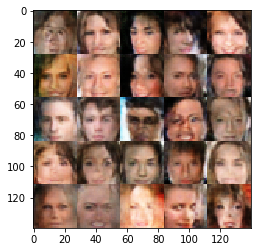

Epoch#1 progress:62.5%  dLoss:1.1884  gLoss:0.9736 
Epoch#1 progress:62.5%  dLoss:1.3907  gLoss:0.6641 
Epoch#1 progress:62.6%  dLoss:1.2710  gLoss:0.8031 
Epoch#1 progress:62.7%  dLoss:1.2964  gLoss:0.5826 
Epoch#1 progress:62.8%  dLoss:1.3991  gLoss:0.6694 
Epoch#1 progress:62.9%  dLoss:1.4206  gLoss:0.6675 
Epoch#1 progress:62.9%  dLoss:1.3061  gLoss:0.7299 
Epoch#1 progress:63.0%  dLoss:1.5559  gLoss:0.5018 
Epoch#1 progress:63.1%  dLoss:1.5042  gLoss:0.5581 
Epoch#1 progress:63.2%  dLoss:1.2291  gLoss:0.8083 


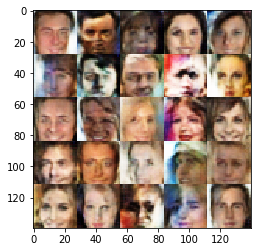

Epoch#1 progress:63.3%  dLoss:1.3630  gLoss:0.5891 
Epoch#1 progress:63.3%  dLoss:1.5173  gLoss:0.4923 
Epoch#1 progress:63.4%  dLoss:1.4465  gLoss:0.4936 
Epoch#1 progress:63.5%  dLoss:1.3003  gLoss:0.7806 
Epoch#1 progress:63.6%  dLoss:1.3231  gLoss:0.7911 
Epoch#1 progress:63.7%  dLoss:1.7550  gLoss:0.4374 
Epoch#1 progress:63.7%  dLoss:1.3742  gLoss:0.6004 
Epoch#1 progress:63.8%  dLoss:1.2015  gLoss:0.6100 
Epoch#1 progress:63.9%  dLoss:1.4448  gLoss:0.4608 
Epoch#1 progress:64.0%  dLoss:1.4139  gLoss:0.6387 


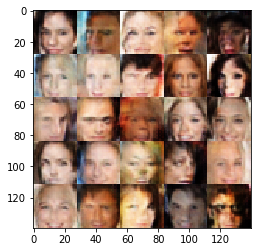

Epoch#1 progress:64.0%  dLoss:1.3742  gLoss:0.5952 
Epoch#1 progress:64.1%  dLoss:1.4087  gLoss:0.7832 
Epoch#1 progress:64.2%  dLoss:1.5134  gLoss:0.4424 
Epoch#1 progress:64.3%  dLoss:1.1898  gLoss:0.8011 
Epoch#1 progress:64.4%  dLoss:1.3367  gLoss:0.6485 
Epoch#1 progress:64.4%  dLoss:1.4042  gLoss:0.6238 
Epoch#1 progress:64.5%  dLoss:1.1704  gLoss:0.9641 
Epoch#1 progress:64.6%  dLoss:1.4241  gLoss:0.6090 
Epoch#1 progress:64.7%  dLoss:1.4488  gLoss:0.5907 
Epoch#1 progress:64.8%  dLoss:1.4793  gLoss:0.5698 


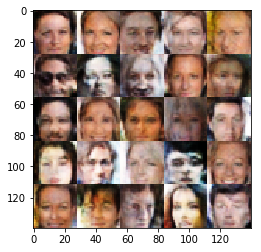

Epoch#1 progress:64.8%  dLoss:1.5000  gLoss:0.7029 
Epoch#1 progress:64.9%  dLoss:1.4941  gLoss:0.6072 
Epoch#1 progress:65.0%  dLoss:1.7025  gLoss:0.3479 
Epoch#1 progress:65.1%  dLoss:1.6171  gLoss:0.3437 
Epoch#1 progress:65.2%  dLoss:1.3212  gLoss:0.6988 
Epoch#1 progress:65.2%  dLoss:1.3737  gLoss:0.9492 
Epoch#1 progress:65.3%  dLoss:1.4874  gLoss:0.6292 
Epoch#1 progress:65.4%  dLoss:1.2351  gLoss:0.7674 
Epoch#1 progress:65.5%  dLoss:1.2094  gLoss:0.8152 
Epoch#1 progress:65.6%  dLoss:1.3932  gLoss:0.6584 


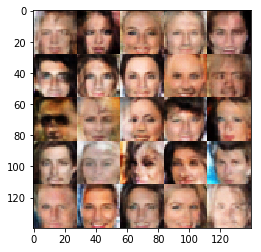

Epoch#1 progress:65.6%  dLoss:1.3429  gLoss:0.5844 
Epoch#1 progress:65.7%  dLoss:1.3831  gLoss:0.7003 
Epoch#1 progress:65.8%  dLoss:1.3039  gLoss:0.5369 
Epoch#1 progress:65.9%  dLoss:1.6387  gLoss:0.7322 
Epoch#1 progress:65.9%  dLoss:1.4425  gLoss:0.6796 
Epoch#1 progress:66.0%  dLoss:1.4091  gLoss:0.6296 
Epoch#1 progress:66.1%  dLoss:0.9783  gLoss:1.1964 
Epoch#1 progress:66.2%  dLoss:1.5780  gLoss:0.7082 
Epoch#1 progress:66.3%  dLoss:1.3554  gLoss:0.5370 
Epoch#1 progress:66.3%  dLoss:1.4170  gLoss:0.5794 


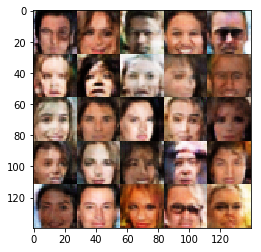

Epoch#1 progress:66.4%  dLoss:1.4263  gLoss:0.5279 
Epoch#1 progress:66.5%  dLoss:1.1775  gLoss:0.7405 
Epoch#1 progress:66.6%  dLoss:1.5596  gLoss:0.4430 
Epoch#1 progress:66.7%  dLoss:1.2005  gLoss:0.6207 
Epoch#1 progress:66.7%  dLoss:1.3014  gLoss:0.6798 
Epoch#1 progress:66.8%  dLoss:1.2231  gLoss:0.7714 
Epoch#1 progress:66.9%  dLoss:1.2489  gLoss:0.7395 
Epoch#1 progress:67.0%  dLoss:1.4758  gLoss:0.5251 
Epoch#1 progress:67.1%  dLoss:1.1226  gLoss:0.9609 
Epoch#1 progress:67.1%  dLoss:1.2574  gLoss:0.7411 


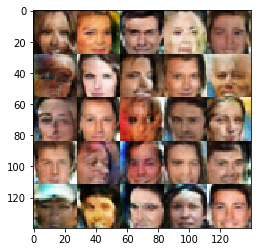

Epoch#1 progress:67.2%  dLoss:1.5412  gLoss:0.5322 
Epoch#1 progress:67.3%  dLoss:1.3013  gLoss:0.9192 
Epoch#1 progress:67.4%  dLoss:1.2781  gLoss:0.6560 
Epoch#1 progress:67.4%  dLoss:1.5539  gLoss:0.4726 
Epoch#1 progress:67.5%  dLoss:1.3044  gLoss:1.2339 
Epoch#1 progress:67.6%  dLoss:1.2793  gLoss:0.8572 
Epoch#1 progress:67.7%  dLoss:1.3525  gLoss:0.6474 
Epoch#1 progress:67.8%  dLoss:1.1532  gLoss:0.9078 
Epoch#1 progress:67.8%  dLoss:1.3785  gLoss:0.5578 
Epoch#1 progress:67.9%  dLoss:1.5432  gLoss:0.5118 


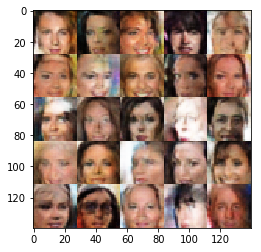

Epoch#1 progress:68.0%  dLoss:1.3742  gLoss:0.5995 
Epoch#1 progress:68.1%  dLoss:1.1709  gLoss:0.9166 
Epoch#1 progress:68.2%  dLoss:1.2132  gLoss:1.1863 
Epoch#1 progress:68.2%  dLoss:1.2750  gLoss:0.8069 
Epoch#1 progress:68.3%  dLoss:1.1135  gLoss:0.9085 
Epoch#1 progress:68.4%  dLoss:1.5899  gLoss:0.4290 
Epoch#1 progress:68.5%  dLoss:1.4262  gLoss:0.5615 
Epoch#1 progress:68.6%  dLoss:1.3688  gLoss:0.7385 
Epoch#1 progress:68.6%  dLoss:1.0235  gLoss:0.8907 
Epoch#1 progress:68.7%  dLoss:1.1296  gLoss:0.8123 


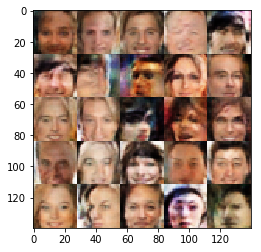

Epoch#1 progress:68.8%  dLoss:1.5263  gLoss:0.4087 
Epoch#1 progress:68.9%  dLoss:1.1153  gLoss:0.8573 
Epoch#1 progress:68.9%  dLoss:1.2335  gLoss:0.7547 
Epoch#1 progress:69.0%  dLoss:1.2195  gLoss:0.6699 
Epoch#1 progress:69.1%  dLoss:1.3354  gLoss:0.6445 
Epoch#1 progress:69.2%  dLoss:1.1550  gLoss:0.8405 
Epoch#1 progress:69.3%  dLoss:1.6723  gLoss:0.4597 
Epoch#1 progress:69.3%  dLoss:1.1670  gLoss:0.8763 
Epoch#1 progress:69.4%  dLoss:1.3161  gLoss:0.7386 
Epoch#1 progress:69.5%  dLoss:1.4981  gLoss:0.4081 


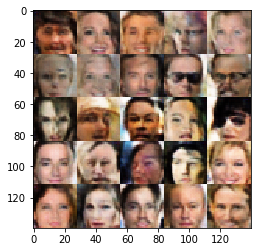

Epoch#1 progress:69.6%  dLoss:1.2891  gLoss:0.6961 
Epoch#1 progress:69.7%  dLoss:1.3734  gLoss:0.7000 
Epoch#1 progress:69.7%  dLoss:1.4522  gLoss:0.5038 
Epoch#1 progress:69.8%  dLoss:1.3617  gLoss:0.5821 
Epoch#1 progress:69.9%  dLoss:1.1962  gLoss:0.9257 
Epoch#1 progress:70.0%  dLoss:1.3927  gLoss:0.8160 
Epoch#1 progress:70.1%  dLoss:1.1255  gLoss:0.6988 
Epoch#1 progress:70.1%  dLoss:1.0891  gLoss:0.8016 
Epoch#1 progress:70.2%  dLoss:1.2482  gLoss:0.7747 
Epoch#1 progress:70.3%  dLoss:1.5592  gLoss:0.4554 


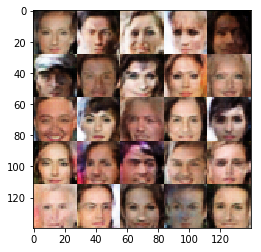

Epoch#1 progress:70.4%  dLoss:1.1808  gLoss:0.6912 
Epoch#1 progress:70.4%  dLoss:1.0986  gLoss:0.9640 
Epoch#1 progress:70.5%  dLoss:1.4694  gLoss:0.6778 
Epoch#1 progress:70.6%  dLoss:1.2596  gLoss:0.6941 
Epoch#1 progress:70.7%  dLoss:1.3767  gLoss:0.5832 
Epoch#1 progress:70.8%  dLoss:1.4447  gLoss:0.5381 
Epoch#1 progress:70.8%  dLoss:1.5083  gLoss:0.6721 
Epoch#1 progress:70.9%  dLoss:1.4373  gLoss:0.5794 
Epoch#1 progress:71.0%  dLoss:1.3734  gLoss:0.6526 
Epoch#1 progress:71.1%  dLoss:1.2994  gLoss:0.7235 


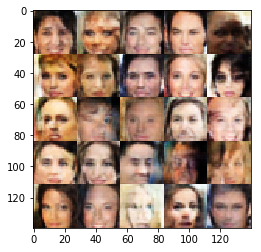

Epoch#1 progress:71.2%  dLoss:1.1655  gLoss:0.7382 
Epoch#1 progress:71.2%  dLoss:1.5092  gLoss:0.4894 
Epoch#1 progress:71.3%  dLoss:1.2460  gLoss:0.8207 
Epoch#1 progress:71.4%  dLoss:1.3000  gLoss:0.6081 
Epoch#1 progress:71.5%  dLoss:1.2968  gLoss:0.5785 
Epoch#1 progress:71.6%  dLoss:1.2401  gLoss:0.8678 
Epoch#1 progress:71.6%  dLoss:1.3801  gLoss:0.6966 
Epoch#1 progress:71.7%  dLoss:1.2051  gLoss:0.6751 
Epoch#1 progress:71.8%  dLoss:1.1341  gLoss:1.3961 
Epoch#1 progress:71.9%  dLoss:1.3204  gLoss:0.7330 


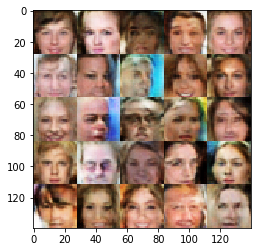

Epoch#1 progress:71.9%  dLoss:1.4153  gLoss:0.6085 
Epoch#1 progress:72.0%  dLoss:1.4573  gLoss:0.5164 
Epoch#1 progress:72.1%  dLoss:1.4787  gLoss:0.5446 
Epoch#1 progress:72.2%  dLoss:1.3223  gLoss:0.6643 
Epoch#1 progress:72.3%  dLoss:1.0907  gLoss:0.9007 
Epoch#1 progress:72.3%  dLoss:1.2310  gLoss:0.6760 
Epoch#1 progress:72.4%  dLoss:1.5312  gLoss:0.4890 
Epoch#1 progress:72.5%  dLoss:1.1285  gLoss:0.9950 
Epoch#1 progress:72.6%  dLoss:1.5317  gLoss:0.4021 
Epoch#1 progress:72.7%  dLoss:1.2841  gLoss:0.6688 


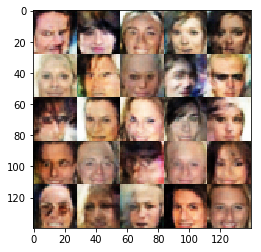

Epoch#1 progress:72.7%  dLoss:1.5163  gLoss:0.4608 
Epoch#1 progress:72.8%  dLoss:1.1450  gLoss:0.9872 
Epoch#1 progress:72.9%  dLoss:1.3054  gLoss:0.7136 
Epoch#1 progress:73.0%  dLoss:1.2350  gLoss:0.6238 
Epoch#1 progress:73.1%  dLoss:1.1849  gLoss:0.9881 
Epoch#1 progress:73.1%  dLoss:1.3540  gLoss:0.6303 
Epoch#1 progress:73.2%  dLoss:1.3136  gLoss:0.6631 
Epoch#1 progress:73.3%  dLoss:1.3616  gLoss:0.4934 
Epoch#1 progress:73.4%  dLoss:1.3080  gLoss:0.9383 
Epoch#1 progress:73.4%  dLoss:1.3764  gLoss:0.6093 


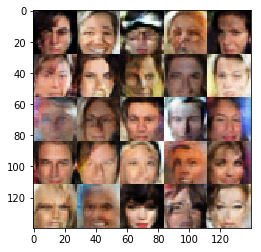

Epoch#1 progress:73.5%  dLoss:1.2424  gLoss:0.6258 
Epoch#1 progress:73.6%  dLoss:1.3947  gLoss:0.7388 
Epoch#1 progress:73.7%  dLoss:1.3118  gLoss:0.6410 
Epoch#1 progress:73.8%  dLoss:1.0887  gLoss:0.7457 
Epoch#1 progress:73.8%  dLoss:1.2363  gLoss:0.9451 
Epoch#1 progress:73.9%  dLoss:1.3217  gLoss:0.8573 
Epoch#1 progress:74.0%  dLoss:1.2709  gLoss:0.5913 
Epoch#1 progress:74.1%  dLoss:1.4982  gLoss:0.4567 
Epoch#1 progress:74.2%  dLoss:1.2646  gLoss:1.0002 
Epoch#1 progress:74.2%  dLoss:1.3592  gLoss:0.6183 


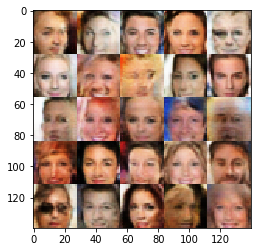

Epoch#1 progress:74.3%  dLoss:1.4373  gLoss:0.6368 
Epoch#1 progress:74.4%  dLoss:1.3458  gLoss:0.6186 
Epoch#1 progress:74.5%  dLoss:1.2347  gLoss:1.0256 
Epoch#1 progress:74.6%  dLoss:1.2645  gLoss:0.8126 
Epoch#1 progress:74.6%  dLoss:1.0958  gLoss:0.8829 
Epoch#1 progress:74.7%  dLoss:1.3603  gLoss:0.6815 
Epoch#1 progress:74.8%  dLoss:1.2273  gLoss:0.7116 
Epoch#1 progress:74.9%  dLoss:1.3441  gLoss:0.5656 
Epoch#1 progress:74.9%  dLoss:1.4820  gLoss:0.5480 
Epoch#1 progress:75.0%  dLoss:1.1877  gLoss:0.7995 


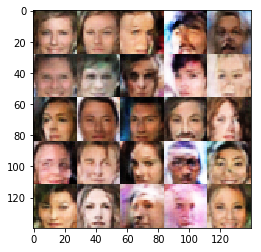

Epoch#1 progress:75.1%  dLoss:1.0322  gLoss:1.1022 
Epoch#1 progress:75.2%  dLoss:1.3372  gLoss:0.5741 
Epoch#1 progress:75.3%  dLoss:1.3682  gLoss:0.7341 
Epoch#1 progress:75.3%  dLoss:1.3165  gLoss:0.6008 
Epoch#1 progress:75.4%  dLoss:1.3439  gLoss:0.5532 
Epoch#1 progress:75.5%  dLoss:1.4537  gLoss:0.5603 
Epoch#1 progress:75.6%  dLoss:1.3849  gLoss:0.7348 
Epoch#1 progress:75.7%  dLoss:1.2842  gLoss:0.8288 
Epoch#1 progress:75.7%  dLoss:1.2028  gLoss:0.7444 
Epoch#1 progress:75.8%  dLoss:1.3109  gLoss:0.6123 


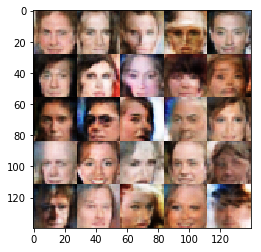

Epoch#1 progress:75.9%  dLoss:0.9874  gLoss:0.9231 
Epoch#1 progress:76.0%  dLoss:1.6653  gLoss:0.4802 
Epoch#1 progress:76.1%  dLoss:1.3741  gLoss:0.7890 
Epoch#1 progress:76.1%  dLoss:1.6806  gLoss:0.4126 
Epoch#1 progress:76.2%  dLoss:1.0895  gLoss:0.9353 
Epoch#1 progress:76.3%  dLoss:1.3815  gLoss:0.8364 
Epoch#1 progress:76.4%  dLoss:1.3141  gLoss:0.6389 
Epoch#1 progress:76.4%  dLoss:1.3608  gLoss:0.6618 
Epoch#1 progress:76.5%  dLoss:1.2732  gLoss:0.6011 
Epoch#1 progress:76.6%  dLoss:1.1815  gLoss:0.8831 


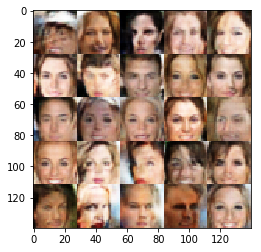

Epoch#1 progress:76.7%  dLoss:1.2813  gLoss:0.7465 
Epoch#1 progress:76.8%  dLoss:1.2667  gLoss:0.6295 
Epoch#1 progress:76.8%  dLoss:1.2654  gLoss:0.9531 
Epoch#1 progress:76.9%  dLoss:1.3217  gLoss:0.8344 
Epoch#1 progress:77.0%  dLoss:1.0856  gLoss:0.8288 
Epoch#1 progress:77.1%  dLoss:1.4076  gLoss:0.8687 
Epoch#1 progress:77.2%  dLoss:1.4451  gLoss:0.5637 
Epoch#1 progress:77.2%  dLoss:1.4016  gLoss:0.5702 
Epoch#1 progress:77.3%  dLoss:1.1490  gLoss:1.1147 
Epoch#1 progress:77.4%  dLoss:1.4754  gLoss:0.5166 


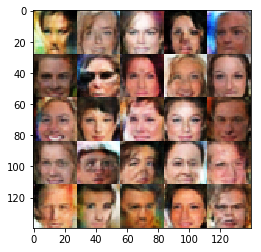

Epoch#1 progress:77.5%  dLoss:1.6934  gLoss:0.6256 
Epoch#1 progress:77.6%  dLoss:1.5621  gLoss:0.5028 
Epoch#1 progress:77.6%  dLoss:1.3248  gLoss:0.5258 
Epoch#1 progress:77.7%  dLoss:1.5402  gLoss:0.4453 
Epoch#1 progress:77.8%  dLoss:1.4448  gLoss:0.5186 
Epoch#1 progress:77.9%  dLoss:1.2562  gLoss:0.6024 
Epoch#1 progress:77.9%  dLoss:1.2174  gLoss:0.6613 
Epoch#1 progress:78.0%  dLoss:1.2611  gLoss:0.8591 
Epoch#1 progress:78.1%  dLoss:1.4216  gLoss:0.5531 
Epoch#1 progress:78.2%  dLoss:1.2093  gLoss:0.8511 


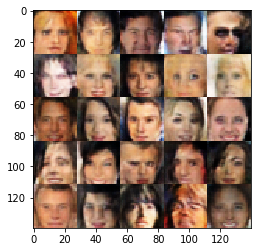

Epoch#1 progress:78.3%  dLoss:1.0470  gLoss:1.0574 
Epoch#1 progress:78.3%  dLoss:1.5020  gLoss:0.5059 
Epoch#1 progress:78.4%  dLoss:1.1388  gLoss:0.8232 
Epoch#1 progress:78.5%  dLoss:1.4391  gLoss:0.5479 
Epoch#1 progress:78.6%  dLoss:1.3930  gLoss:0.6108 
Epoch#1 progress:78.7%  dLoss:1.2018  gLoss:0.6284 
Epoch#1 progress:78.7%  dLoss:1.2443  gLoss:0.7097 
Epoch#1 progress:78.8%  dLoss:1.3190  gLoss:0.5932 
Epoch#1 progress:78.9%  dLoss:1.3027  gLoss:0.9947 
Epoch#1 progress:79.0%  dLoss:1.6296  gLoss:0.7453 


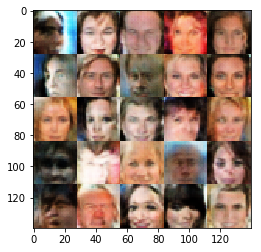

Epoch#1 progress:79.1%  dLoss:1.3035  gLoss:0.9788 
Epoch#1 progress:79.1%  dLoss:1.3235  gLoss:0.6062 
Epoch#1 progress:79.2%  dLoss:1.3702  gLoss:0.5401 
Epoch#1 progress:79.3%  dLoss:1.3168  gLoss:0.6251 
Epoch#1 progress:79.4%  dLoss:1.3427  gLoss:0.7879 
Epoch#1 progress:79.5%  dLoss:1.1075  gLoss:0.8618 
Epoch#1 progress:79.5%  dLoss:1.4678  gLoss:0.5111 
Epoch#1 progress:79.6%  dLoss:1.2899  gLoss:0.6466 


In [ ]:
batch_size = 16
z_dim = 200
learning_rate = 0.0005
beta1 = 0.2

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.